# VoxelMorph
### `IABI Course, Dr. Rohban`
#### Homework 4
*`Full Name:`* Fatemeh Shahhosseini

*`SID:`* 403206519

## Proposed Method Description
$\href {https://arxiv.org/pdf/1809.05231}{Voxelmorph}$ framework, which is designed for image registration using deep learning. Image registration is the process of aligning different images into a common coordinate system. Voxelmorph leverages unsupervised learning to register images by minimizing a loss function that reflects spatial correspondence between images.

Voxelmorph employs a convolutional neural network to predict a deformation field that maps one image to another. The deformation field represents how the pixels in one image should be displaced to align with another image.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import skimage.io as io
import os
import time
from tqdm import tqdm
import torch
import torchvision
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torch.distributions.normal import Normal
from torch.autograd import Variable
from skimage.transform import resize
from sklearn.model_selection import train_test_split
import math

!pip install monai
from monai.utils import set_determinism, first
from monai.transforms import (
    EnsureChannelFirstD,
    Compose,
    LoadImageD,
    RandRotateD,
    RandZoomD,
    ScaleIntensityRanged,
)
from monai.data import DataLoader, Dataset, CacheDataset
from monai.config import print_config, USE_COMPILED
from monai.apps import MedNISTDataset
import tempfile


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 20.8 MB/s eta 0:00:00


# DATALOADER

MONAI version: 1.4.0
Numpy version: 1.26.4
Pytorch version: 2.5.1+cu121
MONAI flags: HAS_EXT = False, USE_COMPILED = False, USE_META_DICT = False
MONAI rev id: 46a5272196a6c2590ca2589029eed8e4d56ff008
MONAI __file__: /usr/local/lib/python3.10/dist-packages/monai/__init__.py

Optional dependencies:
Pytorch Ignite version: NOT INSTALLED or UNKNOWN VERSION.
ITK version: NOT INSTALLED or UNKNOWN VERSION.
Nibabel version: 5.3.2
scikit-image version: 0.25.0
scipy version: 1.13.1
Pillow version: 11.0.0
Tensorboard version: 2.17.1
gdown version: 5.2.0
TorchVision version: 0.20.1+cu121
tqdm version: 4.67.1
lmdb version: NOT INSTALLED or UNKNOWN VERSION.
psutil version: 5.9.5
pandas version: 2.2.2
einops version: 0.8.0
transformers version: 4.47.1
mlflow version: NOT INSTALLED or UNKNOWN VERSION.
pynrrd version: NOT INSTALLED or UNKNOWN VERSION.
clearml version: NOT INSTALLED or UNKNOWN VERSION.

For details about installing the optional dependencies, please visit:
    https://docs.monai.io/en/l

MedNIST.tar.gz: 59.0MB [00:01, 54.3MB/s]                            

2025-01-01 06:31:34,893 - INFO - Downloaded: /tmp/tmpsznb9o4t/MedNIST.tar.gz


2025-01-01 06:31:35,016 - INFO - Verified 'MedNIST.tar.gz', md5: 0bc7306e7427e00ad1c5526a6677552d.
2025-01-01 06:31:35,018 - INFO - Writing into directory: /tmp/tmpsznb9o4t.


Loading dataset: 100%|██████████| 47164/47164 [00:00<00:00, 101232.87it/s]



 first training items:  [{'fixed_hand': '/tmp/tmpsznb9o4t/MedNIST/Hand/003836.jpeg', 'moving_hand': '/tmp/tmpsznb9o4t/MedNIST/Hand/003836.jpeg'}, {'fixed_hand': '/tmp/tmpsznb9o4t/MedNIST/Hand/001613.jpeg', 'moving_hand': '/tmp/tmpsznb9o4t/MedNIST/Hand/001613.jpeg'}, {'fixed_hand': '/tmp/tmpsznb9o4t/MedNIST/Hand/008693.jpeg', 'moving_hand': '/tmp/tmpsznb9o4t/MedNIST/Hand/008693.jpeg'}]
moving_image shape: torch.Size([64, 64])
fixed_image shape: torch.Size([64, 64])


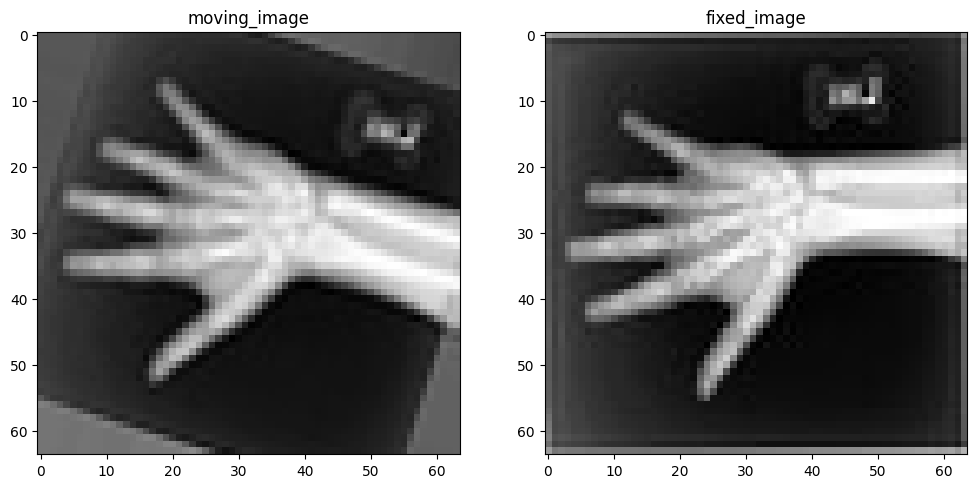

Loading dataset: 100%|██████████| 1000/1000 [00:04<00:00, 210.59it/s]


In [2]:
# DO NOT CHANGE THIS CELL



print_config()
set_determinism(42)
directory = os.environ.get("MONAI_DATA_DIRECTORY")
if directory is not None:
    os.makedirs(directory, exist_ok=True)
root_dir = tempfile.mkdtemp() if directory is None else directory
print(root_dir)


train_data = MedNISTDataset(root_dir=root_dir, section="training", download=True, transform=None)
training_datadict = [
    {"fixed_hand": item["image"], "moving_hand": item["image"]}
    for item in train_data.data
    if item["label"] == 4  # label 4 is for xray hands
]
print("\n first training items: ", training_datadict[:3])

train_transforms = Compose(
    [
        LoadImageD(keys=["fixed_hand", "moving_hand"]),
        EnsureChannelFirstD(keys=["fixed_hand", "moving_hand"]),
        ScaleIntensityRanged(
            keys=["fixed_hand", "moving_hand"],
            a_min=0.0,
            a_max=255.0,
            b_min=0.0,
            b_max=1.0,
            clip=True,
        ),
        RandRotateD(keys=["moving_hand"], range_x=np.pi / 4, prob=1.0, keep_size=True, mode="bicubic"),
        RandZoomD(keys=["moving_hand"], min_zoom=0.9, max_zoom=1.1, prob=1.0, mode="bicubic", align_corners=False),
    ]
)

check_ds = Dataset(data=training_datadict, transform=train_transforms)
check_loader = DataLoader(check_ds, batch_size=1, shuffle=True)
check_data = first(check_loader)
fixed_image = check_data["fixed_hand"][0][0]
moving_image = check_data["moving_hand"][0][0]

print(f"moving_image shape: {moving_image.shape}")
print(f"fixed_image shape: {fixed_image.shape}")

plt.figure("check", (12, 6))
plt.subplot(1, 2, 1)
plt.title("moving_image")
plt.imshow(moving_image, cmap="gray")
plt.subplot(1, 2, 2)
plt.title("fixed_image")
plt.imshow(fixed_image, cmap="gray")

plt.show()


train_ds = CacheDataset(data=training_datadict[:1000], transform=train_transforms, cache_rate=1.0, num_workers=4)
train_loader = DataLoader(train_ds, batch_size=16, shuffle=True, num_workers=2)

val_ds = CacheDataset(data=training_datadict[2000:2500], transform=train_transforms, cache_rate=1.0, num_workers=0)
val_loader = DataLoader(val_ds, batch_size=16, num_workers=0)

test_ds = CacheDataset(data=training_datadict[1000:2000], transform=train_transforms, cache_rate=1.0, num_workers=0)
test_loader = DataLoader(test_ds, batch_size=16, num_workers=0)

# U-NET

`Encoder-Decoder Network`: The model takes two images as input: a moving image and a fixed image. It outputs the deformation field that aligns the moving image to the fixed one.

<p align="left">
<img src="https://drive.usercontent.google.com/u/0/uc?id=14S29efIg5RZsZ7b0Mm9ucWLKUagVn0N5&export=download" alt="" width="500"/>
</p>

The Voxelmorph model consists of a convolutional encoder-decoder architecture:
- Encoder: Extracts features from the input images using convolutions and pooling layers.
- Decoder: Upsamples the encoded features to generate the deformation field that aligns the images.
- Flow Field: The final output is a deformation field.
Input/Output:

In [3]:
# DO NOT CHANGE THIS CELL


class Unet(nn.Module):
    """
    A unet architecture. Layer features can be specified directly as a list of encoder and decoder
    features or as a single integer along with a number of unet levels. The default network features
    per layer (when no options are specified) are:

        encoder: [16, 32, 32, 32]
        decoder: [32, 32, 32, 32, 32, 16, 16]
    """

    def __init__(self,
                 inshape=None,
                 infeats=None,
                 nb_features=None,
                 nb_levels=None,
                 max_pool=2,
                 feat_mult=1,
                 nb_conv_per_level=1,
                 half_res=False):
        """
        Parameters:
            inshape: Input shape. e.g. (1, 64, 64)
            infeats: Number of input features.
            nb_features: Unet convolutional features. Can be specified via a list of lists with
                the form [[encoder feats], [decoder feats]], or as a single integer.
                If None (default), the unet features are defined by the default config described in
                the class documentation.
            nb_levels: Number of levels in unet. Only used when nb_features is an integer.
                Default is None.
            feat_mult: Per-level feature multiplier. Only used when nb_features is an integer.
                Default is 1.
            nb_conv_per_level: Number of convolutions per unet level. Default is 1.
            half_res: Skip the last decoder upsampling. Default is False.
        """

        super().__init__()

        # ensure correct dimensionality
        ndims = 2

        # cache some parameters
        self.half_res = half_res

        # default encoder and decoder layer features if nothing provided
        if nb_features is None:
            nb_features = default_unet_features()

        # build feature list automatically
        if isinstance(nb_features, int):
            if nb_levels is None:
                raise ValueError('must provide unet nb_levels if nb_features is an integer')
            feats = np.round(nb_features * feat_mult ** np.arange(nb_levels)).astype(int)
            nb_features = [
                np.repeat(feats[:-1], nb_conv_per_level),
                np.repeat(np.flip(feats), nb_conv_per_level)
            ]
        elif nb_levels is not None:
            raise ValueError('cannot use nb_levels if nb_features is not an integer')

        # extract any surplus (full resolution) decoder convolutions
        enc_nf, dec_nf = nb_features
        nb_dec_convs = len(enc_nf)
        final_convs = dec_nf[nb_dec_convs:]
        dec_nf = dec_nf[:nb_dec_convs]
        self.nb_levels = int(nb_dec_convs / nb_conv_per_level) + 1

        if isinstance(max_pool, int):
            max_pool = [max_pool] * self.nb_levels

        # cache downsampling / upsampling operations
        MaxPooling = getattr(nn, 'MaxPool%dd' % ndims)
        self.pooling = [MaxPooling(s) for s in max_pool]
        self.upsampling = [nn.Upsample(scale_factor=s, mode='nearest') for s in max_pool]

        # configure encoder (down-sampling path)
        prev_nf = infeats
        encoder_nfs = [prev_nf]
        self.encoder = nn.ModuleList()
        for level in range(self.nb_levels - 1):
            convs = nn.ModuleList()
            for conv in range(nb_conv_per_level):
                nf = enc_nf[level * nb_conv_per_level + conv]
                convs.append(ConvBlock(ndims, prev_nf, nf))
                prev_nf = nf
            self.encoder.append(convs)
            encoder_nfs.append(prev_nf)

        # configure decoder (up-sampling path)
        encoder_nfs = np.flip(encoder_nfs)
        self.decoder = nn.ModuleList()
        for level in range(self.nb_levels - 1):
            convs = nn.ModuleList()
            for conv in range(nb_conv_per_level):
                nf = dec_nf[level * nb_conv_per_level + conv]
                convs.append(ConvBlock(ndims, prev_nf, nf))
                prev_nf = nf
            self.decoder.append(convs)
            if not half_res or level < (self.nb_levels - 2):
                prev_nf += encoder_nfs[level]

        # now we take care of any remaining convolutions
        self.remaining = nn.ModuleList()
        for num, nf in enumerate(final_convs):
            self.remaining.append(ConvBlock(ndims, prev_nf, nf))
            prev_nf = nf

        # cache final number of features
        self.final_nf = prev_nf

    def forward(self, x):

        # encoder forward pass
        x_history = [x]
        for level, convs in enumerate(self.encoder):
            for conv in convs:
                x = conv(x)
            x_history.append(x)
            x = self.pooling[level](x)

        # decoder forward pass with upsampling and concatenation
        for level, convs in enumerate(self.decoder):
            for conv in convs:
                x = conv(x)
            if not self.half_res or level < (self.nb_levels - 2):
                x = self.upsampling[level](x)
                x = torch.cat([x, x_history.pop()], dim=1)

        # remaining convs at full resolution
        for conv in self.remaining:
            x = conv(x)

        return x


class VxmDense(nn.Module):
    """
    VoxelMorph network for (unsupervised) nonlinear registration between two images.
    """

    def __init__(self,
                 inshape,
                 nb_unet_features=None,
                 nb_unet_levels=None,
                 unet_feat_mult=1,
                 nb_unet_conv_per_level=1,
                 int_steps=7,
                 int_downsize=2,
                 use_probs=False,
                 src_feats=1,
                 trg_feats=1,
                 unet_half_res=False):
        """
        Parameters:
            inshape: Input shape. e.g. (192, 192, 192)
            nb_unet_features: Unet convolutional features. Can be specified via a list of lists with
                the form [[encoder feats], [decoder feats]], or as a single integer.
                If None (default), the unet features are defined by the default config described in
                the unet class documentation.
            nb_unet_levels: Number of levels in unet. Only used when nb_features is an integer.
                Default is None.
            unet_feat_mult: Per-level feature multiplier. Only used when nb_features is an integer.
                Default is 1.
            nb_unet_conv_per_level: Number of convolutions per unet level. Default is 1.
            int_steps: Number of flow integration steps. The warp is non-diffeomorphic when this
                value is 0.
            int_downsize: Integer specifying the flow downsample factor for vector integration.
                The flow field is not downsampled when this value is 1.
            use_probs: Use probabilities in flow field. Default is False.
            src_feats: Number of source image features.
            trg_feats: Number of target image features.
            unet_half_res: Skip the last unet decoder upsampling. Requires that int_downsize=2.
                Default is False.
        """
        super().__init__()

        # internal flag indicating whether to return flow or integrated warp during inference
        self.training = True

        # ensure correct dimensionality
        ndims = len(inshape)
        assert ndims in [1, 2, 3], 'ndims should be one of 1, 2, or 3. found: %d' % ndims

        # configure core unet model
        self.unet_model = Unet(
            inshape,
            infeats=(src_feats + trg_feats),
            nb_features=nb_unet_features,
            nb_levels=nb_unet_levels,
            feat_mult=unet_feat_mult,
            nb_conv_per_level=nb_unet_conv_per_level,
            half_res=unet_half_res,
        )

        # configure unet to flow field layer
        Conv = getattr(nn, 'Conv%dd' % ndims)
        self.flow = Conv(self.unet_model.final_nf, ndims, kernel_size=3, padding=1)

        # init flow layer with small weights and bias
        self.flow.weight = nn.Parameter(Normal(0, 1e-5).sample(self.flow.weight.shape))
        self.flow.bias = nn.Parameter(torch.zeros(self.flow.bias.shape))

        # probabilities are not supported in pytorch
        if use_probs:
            raise NotImplementedError(
                'Flow variance has not been implemented in pytorch - set use_probs to False')

        # configure optional resize layers (downsize)
        if not unet_half_res and int_steps > 0 and int_downsize > 1:
            self.resize = ResizeTransform(int_downsize, ndims)
        else:
            self.resize = None

        # resize to full res
        if int_steps > 0 and int_downsize > 1:
            self.fullsize = ResizeTransform(1 / int_downsize, ndims)
        else:
            self.fullsize = None


        # configure optional integration layer for diffeomorphic warp
        down_shape = [int(dim / int_downsize) for dim in inshape]
        self.integrate = VecInt(down_shape, int_steps) if int_steps > 0 else None

        # configure transformer
        self.transformer = SpatialTransformer(inshape)

    def forward(self, source, target, registration=False):
        '''
        Parameters:
            source: Source image tensor.
            target: Target image tensor.
            registration: Return transformed image and flow. Default is False.
        '''

        # concatenate inputs and propagate unet
        x = torch.cat([source, target], dim=1)
        x = self.unet_model(x)

        # transform into flow field
        flow_field = self.flow(x)

        # resize flow for integration
        pos_flow = flow_field
        if self.resize:
            pos_flow = self.resize(pos_flow)

        preint_flow = pos_flow

        # integrate to produce diffeomorphic warp
        if self.integrate:
            pos_flow = self.integrate(pos_flow)

            # resize to final resolution
            if self.fullsize:
                pos_flow = self.fullsize(pos_flow)

        # warp image with flow field
        y_source = self.transformer(source, pos_flow)

        # return non-integrated flow field if training
        if not registration:
            return  y_source, preint_flow
        else:
            return y_source, pos_flow


class ConvBlock(nn.Module):
    """
    Specific convolutional block followed by leakyrelu for unet.
    """

    def __init__(self, ndims, in_channels, out_channels, stride=1):
        super().__init__()

        Conv = getattr(nn, 'Conv%dd' % ndims)
        self.main = Conv(in_channels, out_channels, 3, stride, 1)
        self.activation = nn.LeakyReLU(0.2)

    def forward(self, x):
        out = self.main(x)
        out = self.activation(out)
        return out

import torch
import torch.nn as nn
import torch.nn.functional as nnf


class SpatialTransformer(nn.Module):
    """
    N-D Spatial Transformer
    """

    def __init__(self, size, mode='bilinear'):
        super().__init__()

        self.mode = mode

        # create sampling grid
        vectors = [torch.arange(0, s) for s in size]
        grids = torch.meshgrid(vectors)
        grid = torch.stack(grids)
        grid = torch.unsqueeze(grid, 0)
        grid = grid.type(torch.FloatTensor)

        # registering the grid as a buffer cleanly moves it to the GPU, but it also
        # adds it to the state dict. this is annoying since everything in the state dict
        # is included when saving weights to disk, so the model files are way bigger
        # than they need to be. so far, there does not appear to be an elegant solution.
        # see: https://discuss.pytorch.org/t/how-to-register-buffer-without-polluting-state-dict
        self.register_buffer('grid', grid)

    def forward(self, src, flow):
        # new locations
        new_locs = self.grid + flow
        shape = flow.shape[2:]

        # need to normalize grid values to [-1, 1] for resampler
        for i in range(len(shape)):
            new_locs[:, i, ...] = 2 * (new_locs[:, i, ...] / (shape[i] - 1) - 0.5)

        # move channels dim to last position
        # also not sure why, but the channels need to be reversed
        if len(shape) == 2:
            new_locs = new_locs.permute(0, 2, 3, 1)
            new_locs = new_locs[..., [1, 0]]
        elif len(shape) == 3:
            new_locs = new_locs.permute(0, 2, 3, 4, 1)
            new_locs = new_locs[..., [2, 1, 0]]

        return nnf.grid_sample(src, new_locs, align_corners=True, mode=self.mode)


class VecInt(nn.Module):
    """
    Integrates a vector field via scaling and squaring.
    """

    def __init__(self, inshape, nsteps):
        super().__init__()

        assert nsteps >= 0, 'nsteps should be >= 0, found: %d' % nsteps
        self.nsteps = nsteps
        self.scale = 1.0 / (2 ** self.nsteps)
        self.transformer = SpatialTransformer(inshape)

    def forward(self, vec):
        vec = vec * self.scale
        for _ in range(self.nsteps):
            vec = vec + self.transformer(vec, vec)
        return vec


class ResizeTransform(nn.Module):
    """
    Resize a transform, which involves resizing the vector field *and* rescaling it.
    """

    def __init__(self, vel_resize, ndims):
        super().__init__()
        self.factor = 1.0 / vel_resize
        self.mode = 'linear'
        if ndims == 2:
            self.mode = 'bi' + self.mode
        elif ndims == 3:
            self.mode = 'tri' + self.mode

    def forward(self, x):
        if self.factor < 1:
            # resize first to save memory
            x = nnf.interpolate(x, align_corners=True, scale_factor=self.factor, mode=self.mode)
            x = self.factor * x

        elif self.factor > 1:
            # multiply first to save memory
            x = self.factor * x
            x = nnf.interpolate(x, align_corners=True, scale_factor=self.factor, mode=self.mode)

        return x


# LOSS

The loss function is crucial for training the network and ensures that the predicted deformation aligns the moving image with the fixed image.
The Voxelmorph paper defines two components for the loss:
### Similarity Loss:
`MSE Loss`: This term quantifies how well the aligned images match in terms of pixel intensities.

`Cross correlation loss`: This term quantifies how well the aligned images match in terms of pixel intensities.

<p align="left">
<img src="https://drive.usercontent.google.com/u/0/uc?id=1k1Erq2g06KeAA_P5oj807oBxZ2icGSXy&export=download" alt="" width="500"/>
</p>

### Smooth Loss
`Smoothness Loss (Regularization Loss)`: To prevent unrealistic deformations, the deformation field is regularized to encourage smooth transformations.

$
L_{\text{smooth}}(\mathbf{\phi}) = \sum_{p \in \Omega} \|\nabla \mathbf{p}\|^2
$

This loss penalizes high-frequency deformations, ensuring that the transformation is smooth and continuous.

Total Loss: The total loss is a weighted sum of the image matching loss and the smoothness los

$L_{total} =  L_{similarity} + \lambda \cdot L_{smooth}$

where λ is a regularization weight controlling the trade-off between matching the images and enforcing smooth deformation


` Dice Score `:

<p align="left">
<img src="https://drive.usercontent.google.com/u/0/uc?id=1Bb_K1GYhFY8b5rmobZ9FwTHpxrMEZFhl&export=download" alt="" width="500"/>
</p>


## TO DO
You should complete each Loss function based on the description on the `VoxelMorph paper`.

In [4]:
def cross_correlation_loss_OR_MSE(y_true, y_pred):
    mse_loss = F.mse_loss(y_true, y_pred)
    y_true_mean = torch.mean(y_true)
    y_pred_mean = torch.mean(y_pred)
    y_true_centered = y_true - y_true_mean
    y_pred_centered = y_pred - y_pred_mean
    cross_corr = torch.sum(y_true_centered * y_pred_centered) / torch.sqrt(torch.sum(y_true_centered ** 2) * torch.sum(y_pred_centered ** 2))
    return mse_loss + (1 - cross_corr)

def smoothing_loss(y_pred):
    dy = torch.abs(y_pred[:, :, 1:, :] - y_pred[:, :, :-1, :])
    dx = torch.abs(y_pred[:, :, :, 1:] - y_pred[:, :, :, :-1])
    return torch.mean(dx) + torch.mean(dy)

def dice_score(target, pred):
    smooth = 1.
    intersection = torch.sum(target * pred)
    return (2. * intersection + smooth) / (torch.sum(target) + torch.sum(pred) + smooth)

In [5]:
class VoxelLoss(nn.Module):
  def __init__(self):
    super(VoxelLoss, self).__init__()
  def forward(self, true, pred, dff):
    #################################################################################
    #                         YOUR CODE GOES HERE               5 pts              #
    cor = cross_correlation_loss_OR_MSE(true, pred)
    smooth = smoothing_loss(dff)
    return cor + 0.001 * smooth
    #################################################################################

criterion = VoxelLoss()

# TRAIN

In [6]:
# DO NOT CHANGE THIS CELL
from torch.optim.lr_scheduler import StepLR

inshape=[64,64]
enc_nf =  [16, 32, 32, 32]
dec_nf = [32, 32, 32, 32, 32, 16, 16]

voxelmorph = VxmDense(
        inshape=inshape,
        nb_unet_features=[enc_nf, dec_nf],
    )

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
optimizer = optim.Adam(voxelmorph.parameters(), lr=1e-5)
sched =StepLR(optimizer, step_size=10, gamma=0.9)
voxelmorph = voxelmorph.to(device)

num_epochs = 200  # You can change number of epochs

/usr/local/lib/python3.10/dist-packages/torch/functional.py:534: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3595.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [15]:
# TODO

def plot_samples(batch_fixed, batch_moving, registered_image, dff, k):
    """
    Plot k samples from batch_fixed, batch_moving, registered_image, and deformation matrix in the validation set.
    """
    k = min(k, batch_fixed.shape[0])
    fig, axs = plt.subplots(k, 4, figsize=(15, 5 * k))


    #################################################################################
    #                         YOUR CODE GOES HERE              10 pts               #

    for i in range(k):
        # Extract individual samples
        fixed_img = batch_fixed[i].cpu().numpy().squeeze()
        moving_img = batch_moving[i].cpu().numpy().squeeze()
        registered_img = registered_image[i].cpu().detach().numpy().squeeze()
        deformation_field = dff[i].cpu().detach().numpy()

        # Plot each sample
        axs[i, 0].imshow(fixed_img, cmap='gray')
        axs[i, 0].set_title('Fixed Image')
        axs[i, 0].axis('off')

        axs[i, 1].imshow(moving_img, cmap='gray')
        axs[i, 1].set_title('Moving Image')
        axs[i, 1].axis('off')

        axs[i, 2].imshow(registered_img, cmap='gray')
        axs[i, 2].set_title('Registered Image')
        axs[i, 2].axis('off')

        # Deformation field visualization (magnitude)
        deformation_magnitude = np.sqrt(np.sum(deformation_field**2, axis=0))
        axs[i, 3].imshow(deformation_magnitude, cmap='viridis')
        axs[i, 3].set_title('Deformation Field Magnitude')
        axs[i, 3].axis('off')

    plt.tight_layout()
    plt.show()

Epoch 1/400 - Validation: 100%|██████████| 32/32 [00:04<00:00,  7.21it/s, val_loss=metatensor(0.0104, device='cuda:0')]


Epoch 1/400 - Duration: 0.30 mins - Train Loss: 0.308, Train DICE: 0.548, Val Loss: 0.023, Val DICE: 0.561


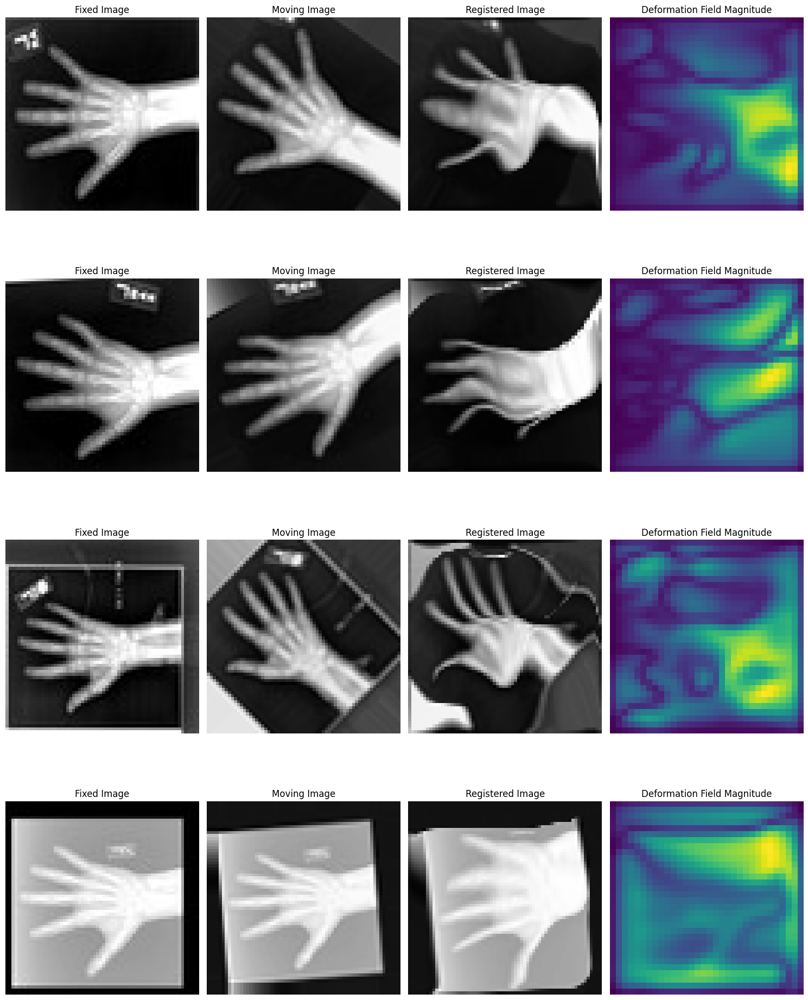

Epoch 2/400 - Validation: 100%|██████████| 32/32 [00:04<00:00,  6.46it/s, val_loss=metatensor(0.0081, device='cuda:0')]


Epoch 2/400 - Duration: 0.32 mins - Train Loss: 0.298, Train DICE: 0.550, Val Loss: 0.018, Val DICE: 0.564


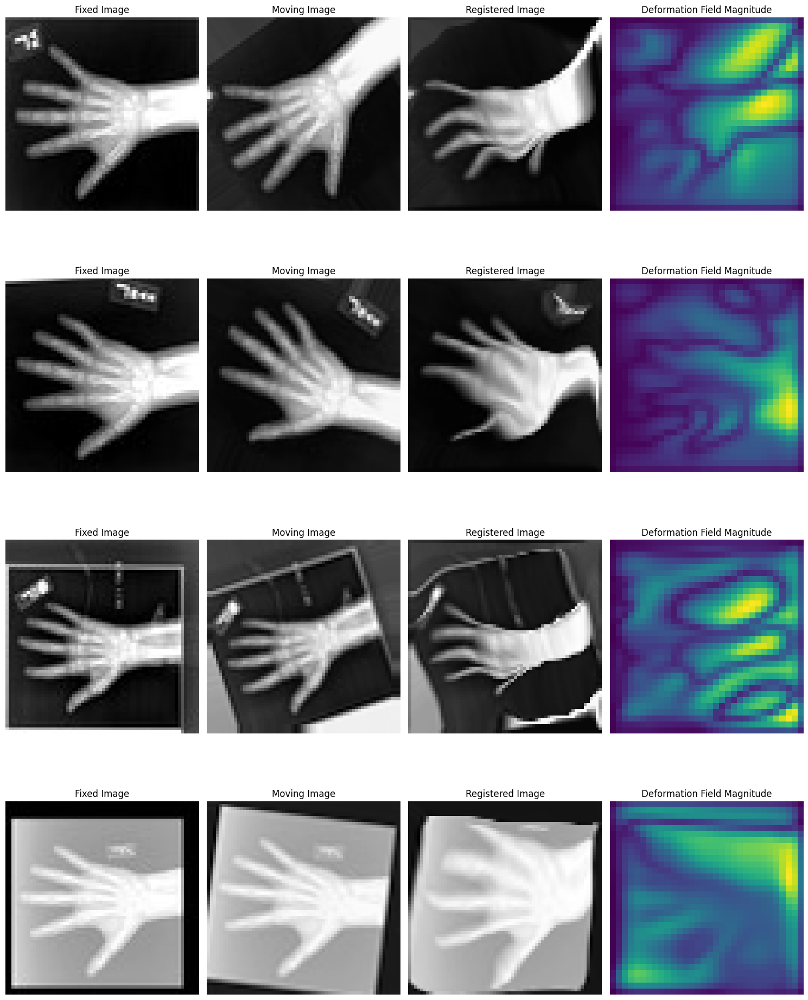

Epoch 3/400 - Validation: 100%|██████████| 32/32 [00:05<00:00,  5.52it/s, val_loss=metatensor(0.0083, device='cuda:0')]


Epoch 3/400 - Duration: 0.32 mins - Train Loss: 0.298, Train DICE: 0.550, Val Loss: 0.018, Val DICE: 0.565


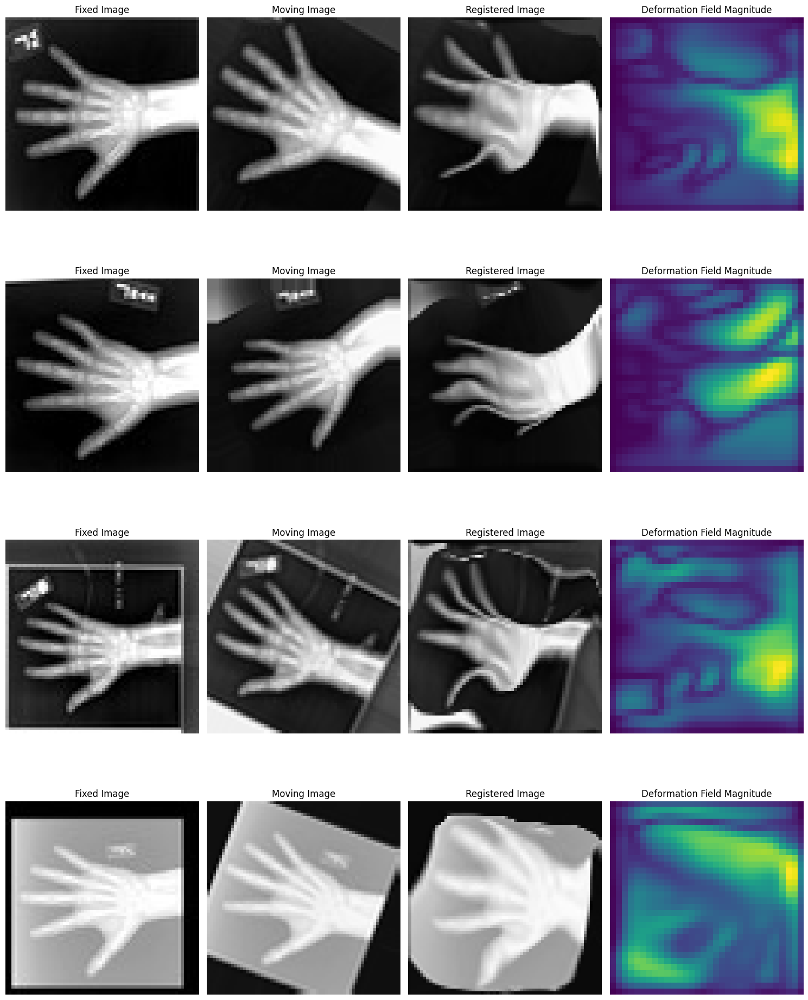

Epoch 4/400 - Validation: 100%|██████████| 32/32 [00:06<00:00,  4.60it/s, val_loss=metatensor(0.0090, device='cuda:0')]


Epoch 4/400 - Duration: 0.31 mins - Train Loss: 0.296, Train DICE: 0.551, Val Loss: 0.020, Val DICE: 0.569


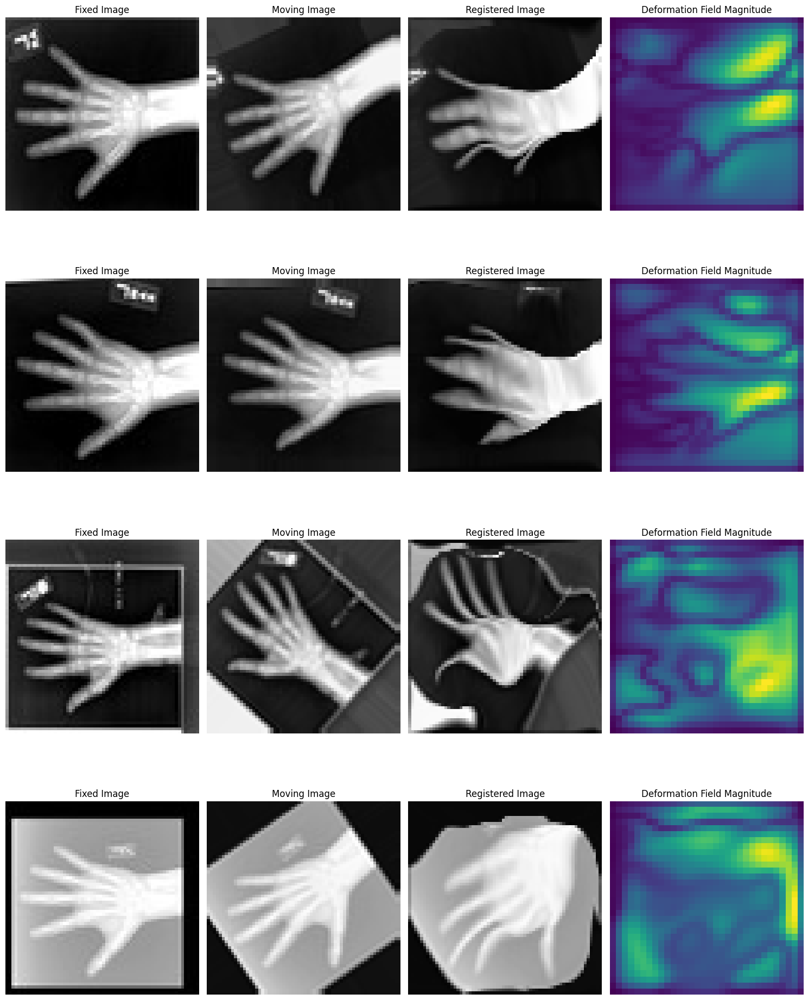

Epoch 5/400 - Validation: 100%|██████████| 32/32 [00:05<00:00,  5.79it/s, val_loss=metatensor(0.0082, device='cuda:0')]


Epoch 5/400 - Duration: 0.34 mins - Train Loss: 0.285, Train DICE: 0.555, Val Loss: 0.018, Val DICE: 0.569


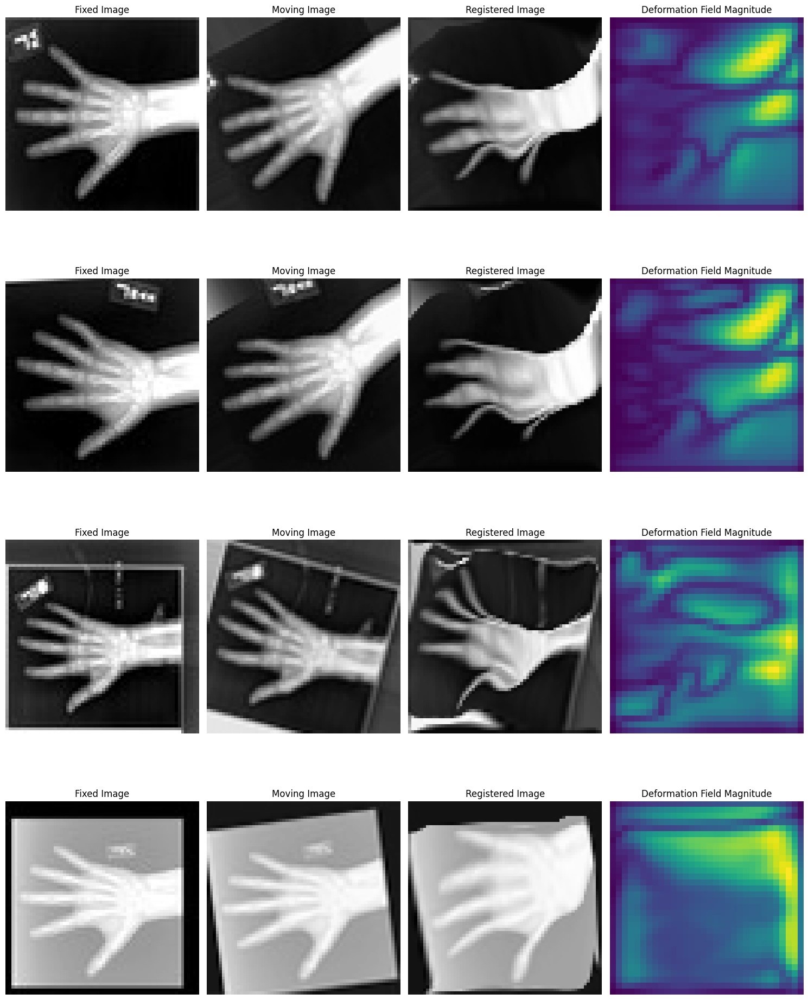

Epoch 6/400 - Validation: 100%|██████████| 32/32 [00:05<00:00,  5.79it/s, val_loss=metatensor(0.0104, device='cuda:0')]


Epoch 6/400 - Duration: 0.33 mins - Train Loss: 0.278, Train DICE: 0.556, Val Loss: 0.023, Val DICE: 0.568


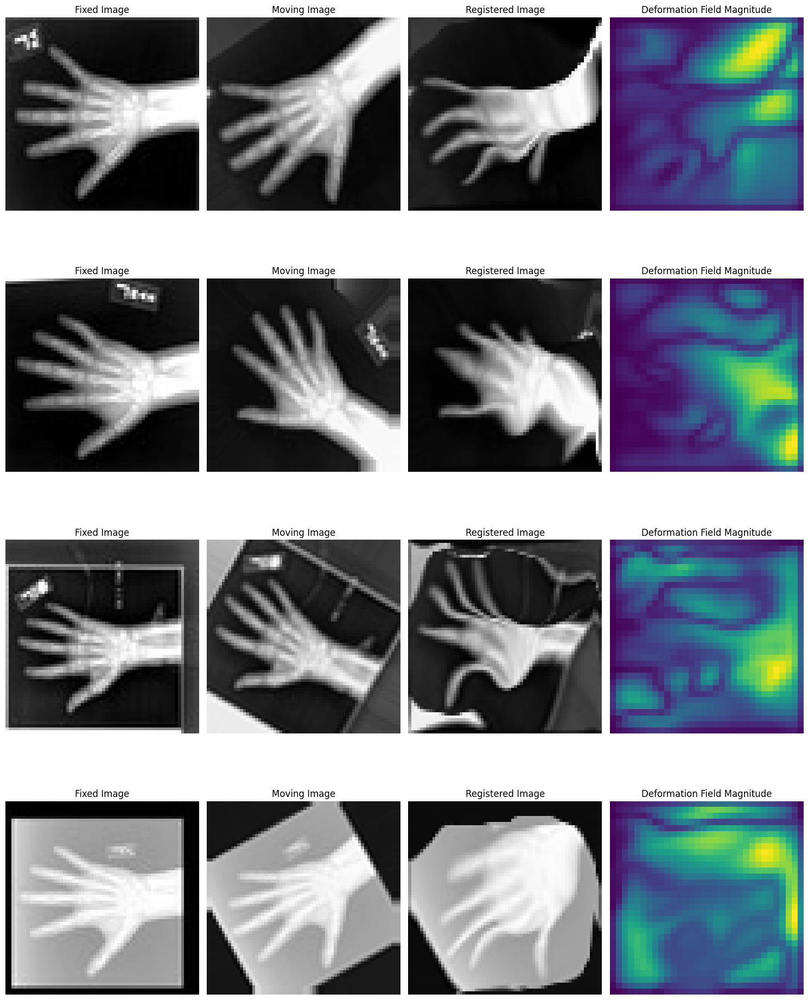

Epoch 7/400 - Validation: 100%|██████████| 32/32 [00:07<00:00,  4.21it/s, val_loss=metatensor(0.0082, device='cuda:0')]


Epoch 7/400 - Duration: 0.36 mins - Train Loss: 0.276, Train DICE: 0.559, Val Loss: 0.018, Val DICE: 0.571


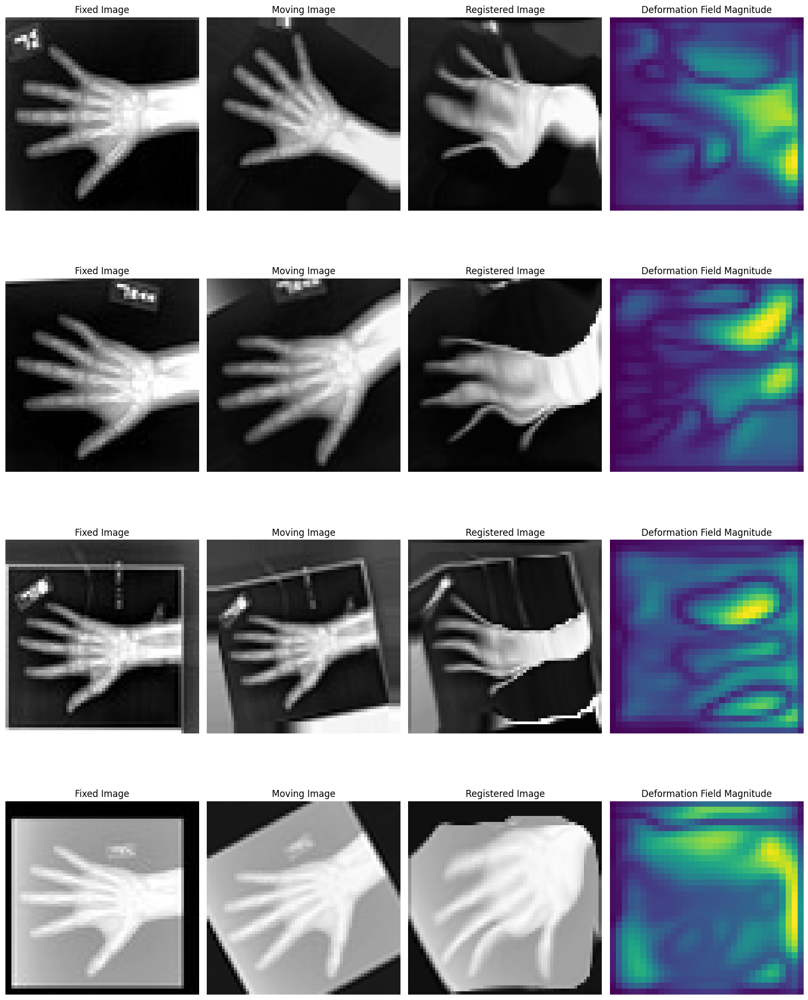

Epoch 8/400 - Validation: 100%|██████████| 32/32 [00:05<00:00,  5.39it/s, val_loss=metatensor(0.0089, device='cuda:0')]


Epoch 8/400 - Duration: 0.32 mins - Train Loss: 0.269, Train DICE: 0.561, Val Loss: 0.020, Val DICE: 0.574


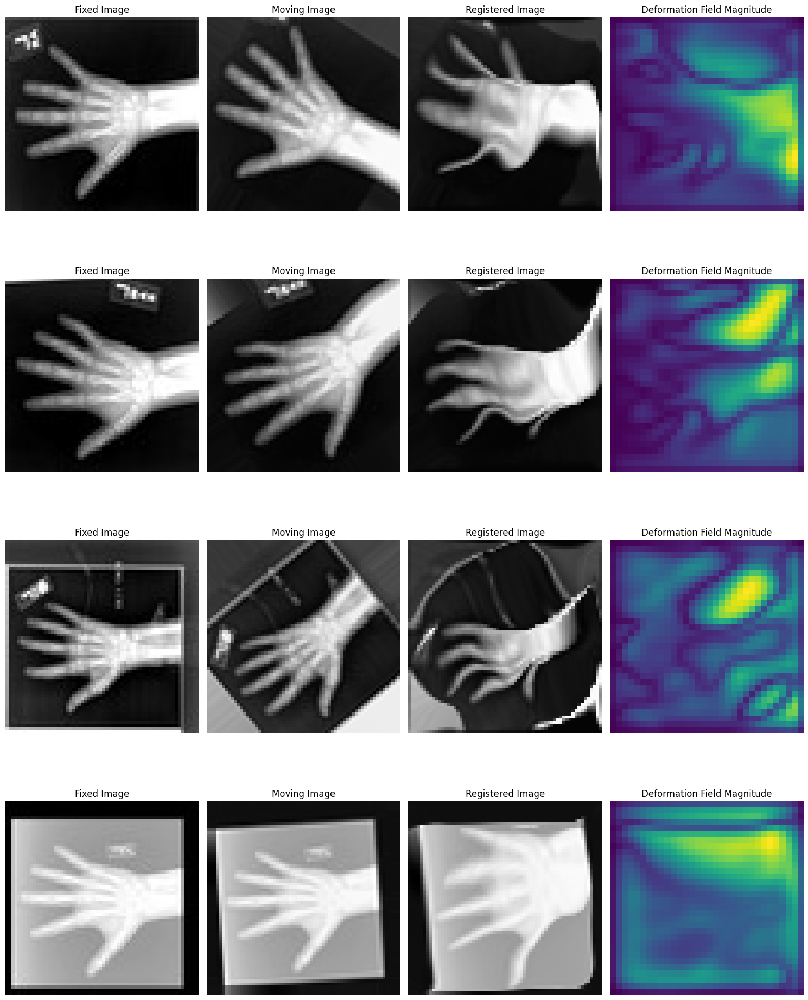

Epoch 9/400 - Validation: 100%|██████████| 32/32 [00:05<00:00,  5.33it/s, val_loss=metatensor(0.0075, device='cuda:0')]


Epoch 9/400 - Duration: 0.34 mins - Train Loss: 0.269, Train DICE: 0.561, Val Loss: 0.017, Val DICE: 0.576


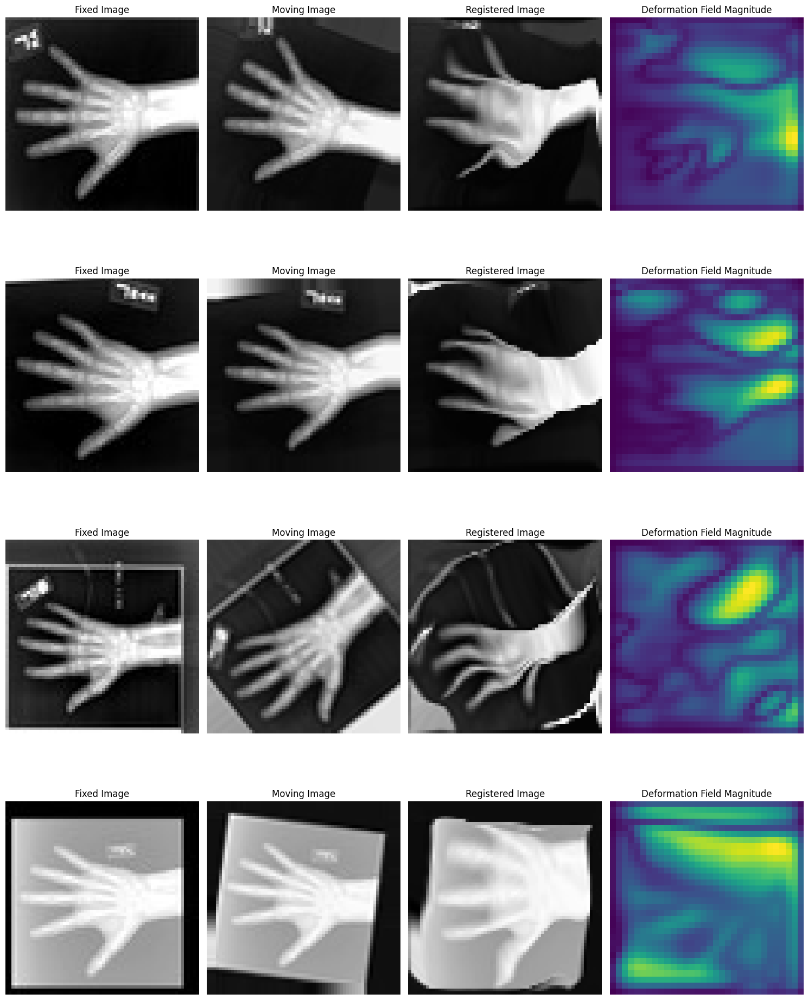

Epoch 10/400 - Validation: 100%|██████████| 32/32 [00:07<00:00,  4.30it/s, val_loss=metatensor(0.0077, device='cuda:0')]


Epoch 10/400 - Duration: 0.36 mins - Train Loss: 0.268, Train DICE: 0.562, Val Loss: 0.017, Val DICE: 0.575


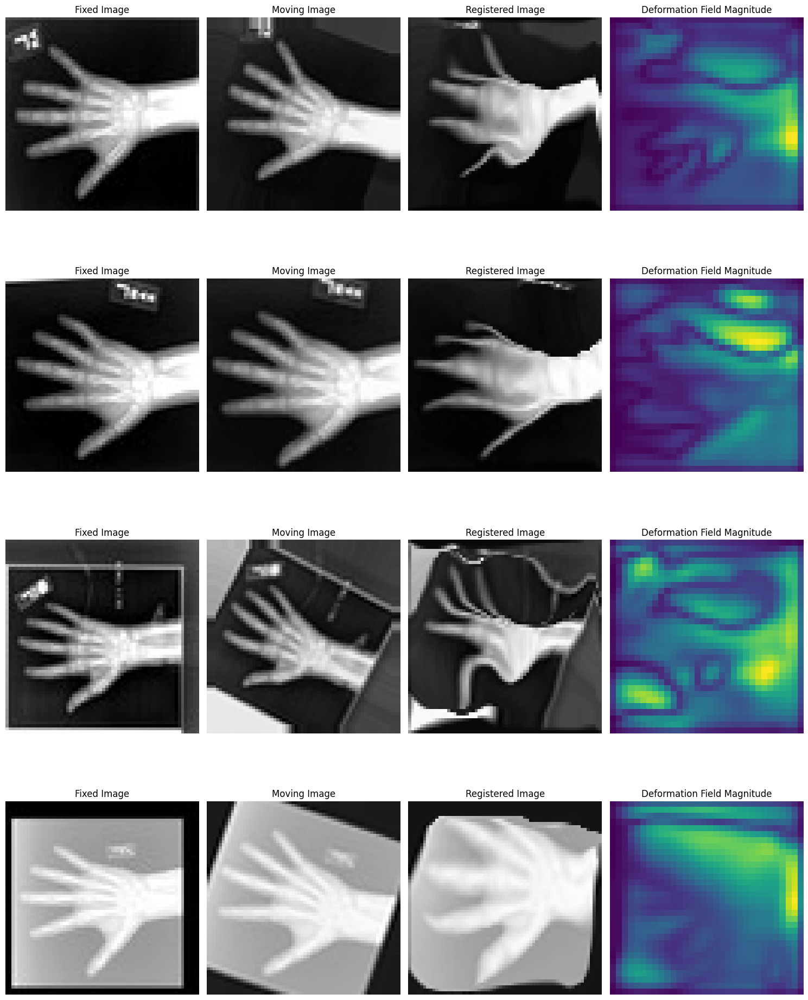

Epoch 11/400 - Validation: 100%|██████████| 32/32 [00:06<00:00,  4.74it/s, val_loss=metatensor(0.0084, device='cuda:0')]


Epoch 11/400 - Duration: 0.33 mins - Train Loss: 0.256, Train DICE: 0.566, Val Loss: 0.018, Val DICE: 0.579


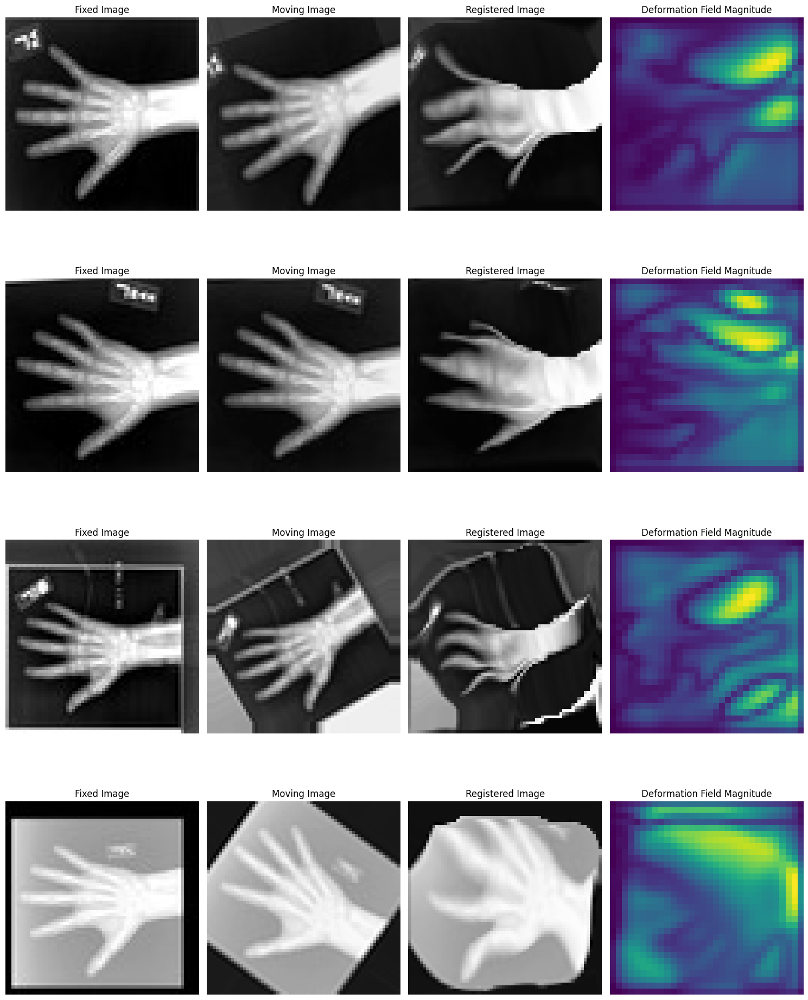

Epoch 12/400 - Validation: 100%|██████████| 32/32 [00:06<00:00,  4.79it/s, val_loss=metatensor(0.0086, device='cuda:0')]


Epoch 12/400 - Duration: 0.37 mins - Train Loss: 0.261, Train DICE: 0.565, Val Loss: 0.019, Val DICE: 0.580


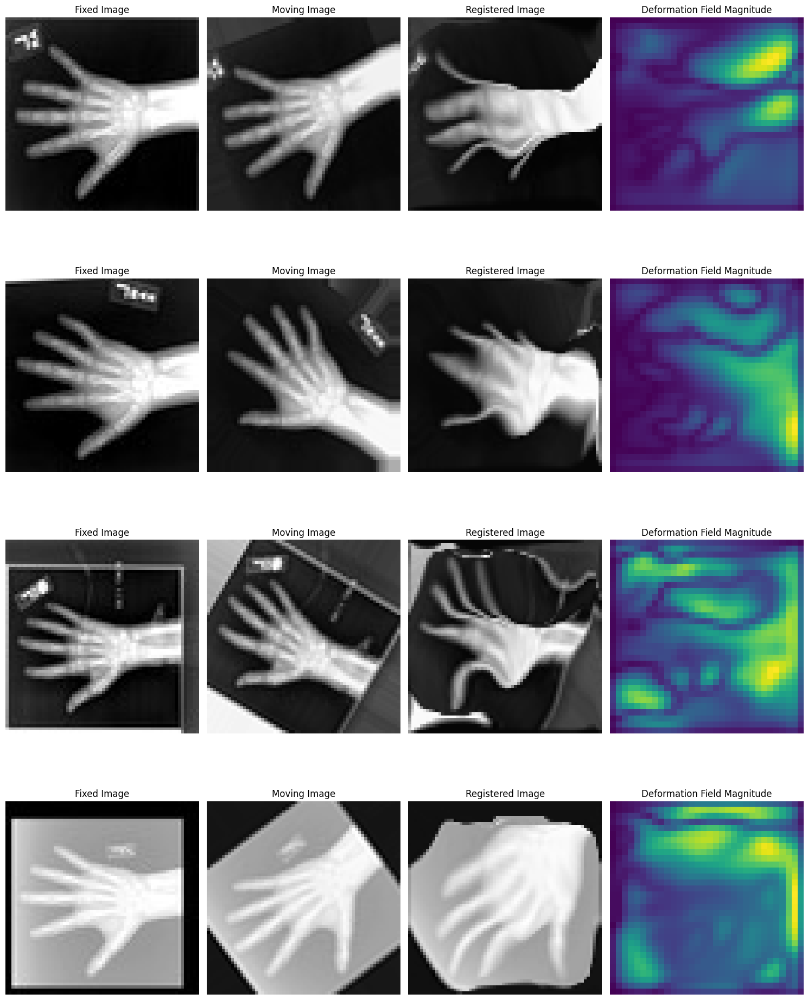

Epoch 13/400 - Validation: 100%|██████████| 32/32 [00:07<00:00,  4.09it/s, val_loss=metatensor(0.0087, device='cuda:0')]


Epoch 13/400 - Duration: 0.36 mins - Train Loss: 0.258, Train DICE: 0.566, Val Loss: 0.019, Val DICE: 0.579


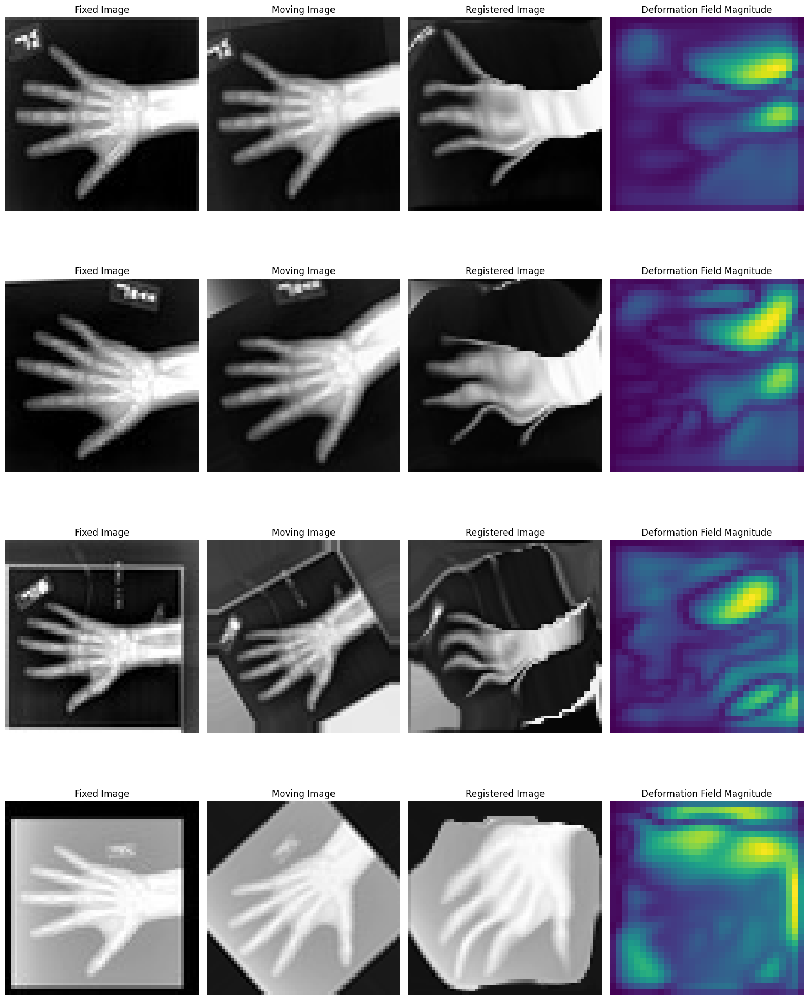

Epoch 14/400 - Validation: 100%|██████████| 32/32 [00:06<00:00,  4.78it/s, val_loss=metatensor(0.0078, device='cuda:0')]


Epoch 14/400 - Duration: 0.37 mins - Train Loss: 0.254, Train DICE: 0.568, Val Loss: 0.017, Val DICE: 0.582


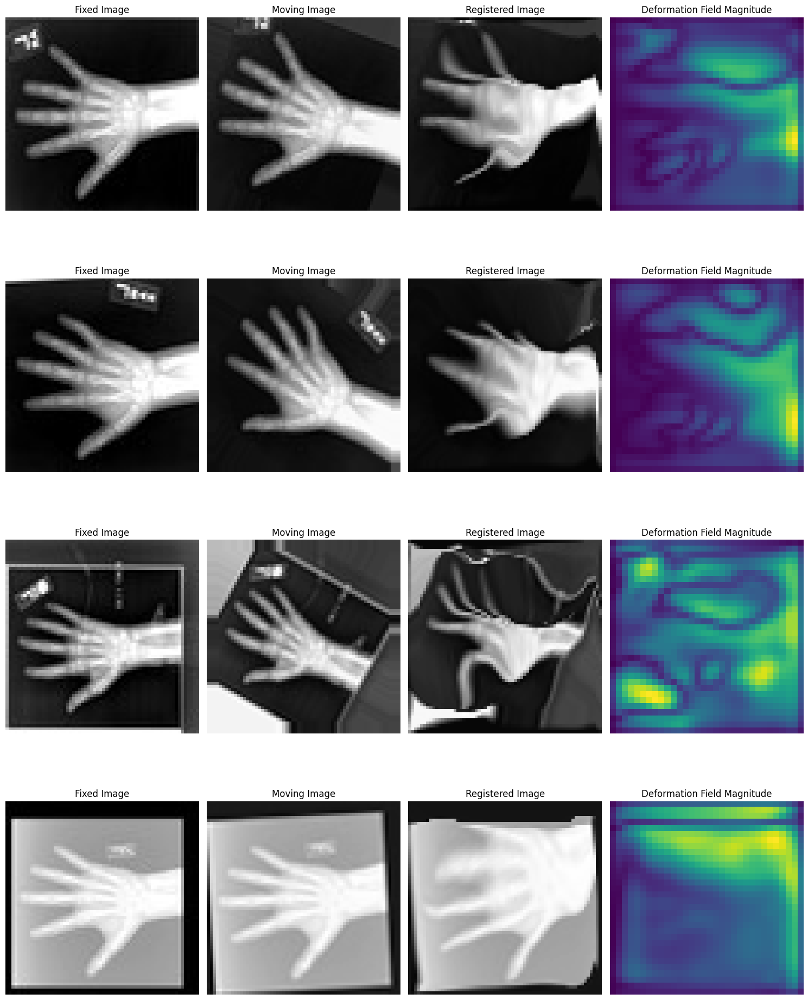

Epoch 15/400 - Validation: 100%|██████████| 32/32 [00:07<00:00,  4.54it/s, val_loss=metatensor(0.0073, device='cuda:0')]


Epoch 15/400 - Duration: 0.37 mins - Train Loss: 0.246, Train DICE: 0.571, Val Loss: 0.016, Val DICE: 0.585


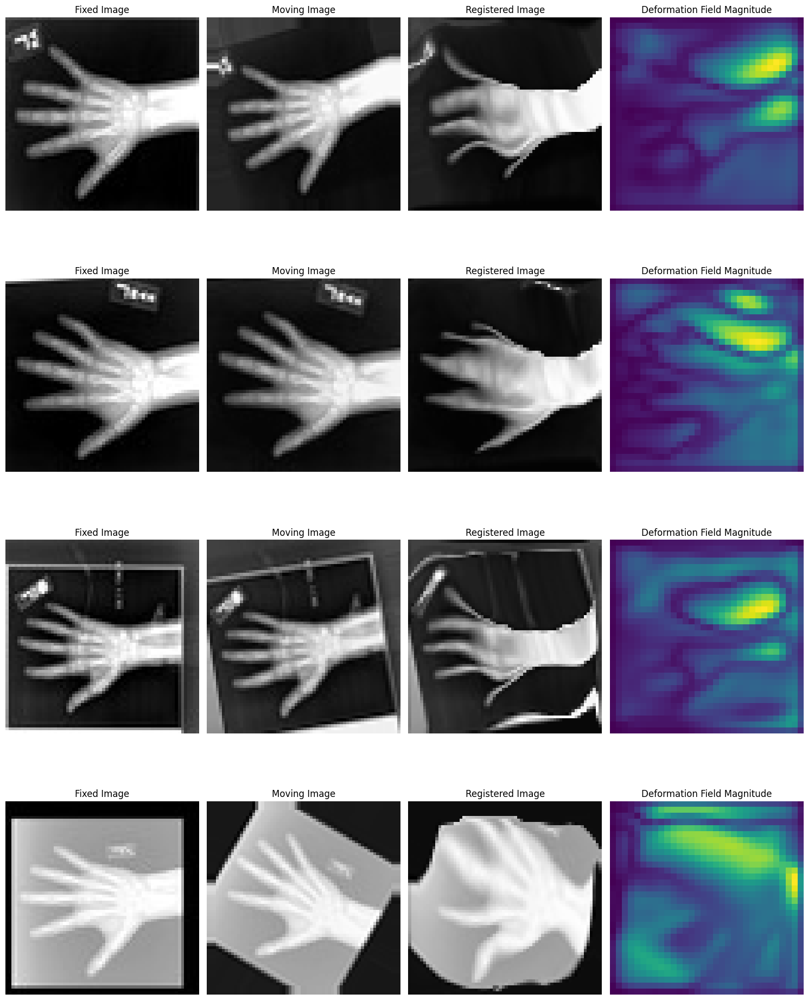

Epoch 16/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.97it/s, val_loss=metatensor(0.0073, device='cuda:0')]


Epoch 16/400 - Duration: 0.37 mins - Train Loss: 0.245, Train DICE: 0.572, Val Loss: 0.016, Val DICE: 0.586


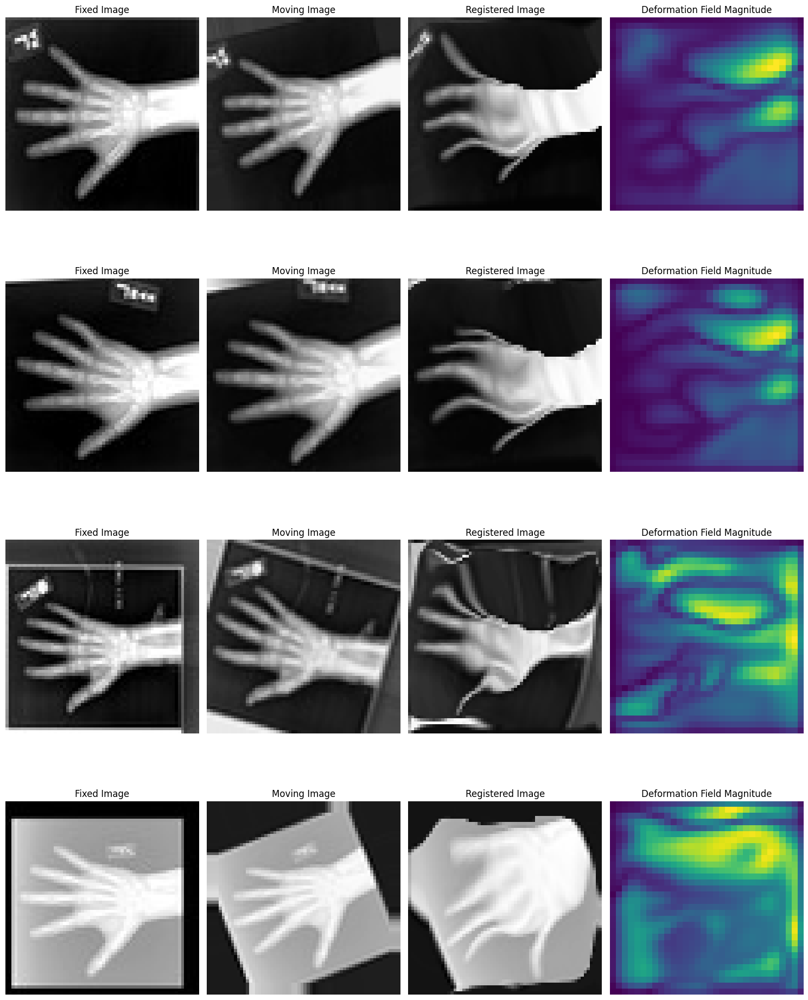

Epoch 17/400 - Validation: 100%|██████████| 32/32 [00:07<00:00,  4.47it/s, val_loss=metatensor(0.0087, device='cuda:0')]


Epoch 17/400 - Duration: 0.38 mins - Train Loss: 0.244, Train DICE: 0.572, Val Loss: 0.019, Val DICE: 0.586


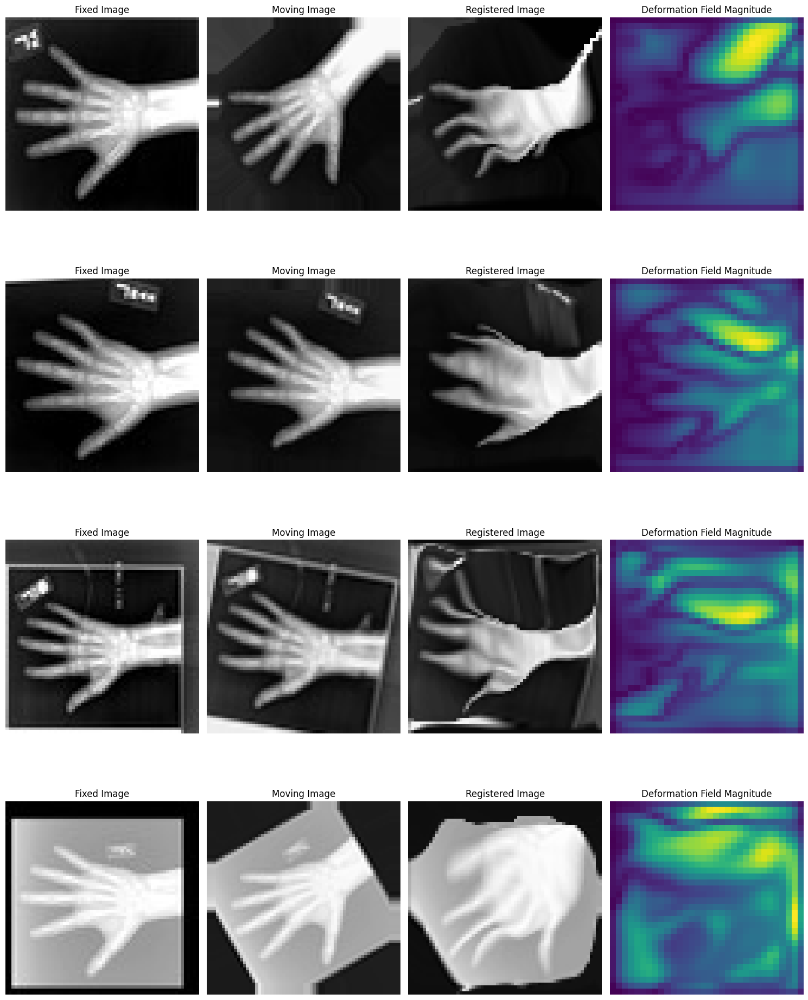

Epoch 18/400 - Validation: 100%|██████████| 32/32 [00:07<00:00,  4.07it/s, val_loss=metatensor(0.0088, device='cuda:0')]


Epoch 18/400 - Duration: 0.39 mins - Train Loss: 0.242, Train DICE: 0.573, Val Loss: 0.019, Val DICE: 0.587


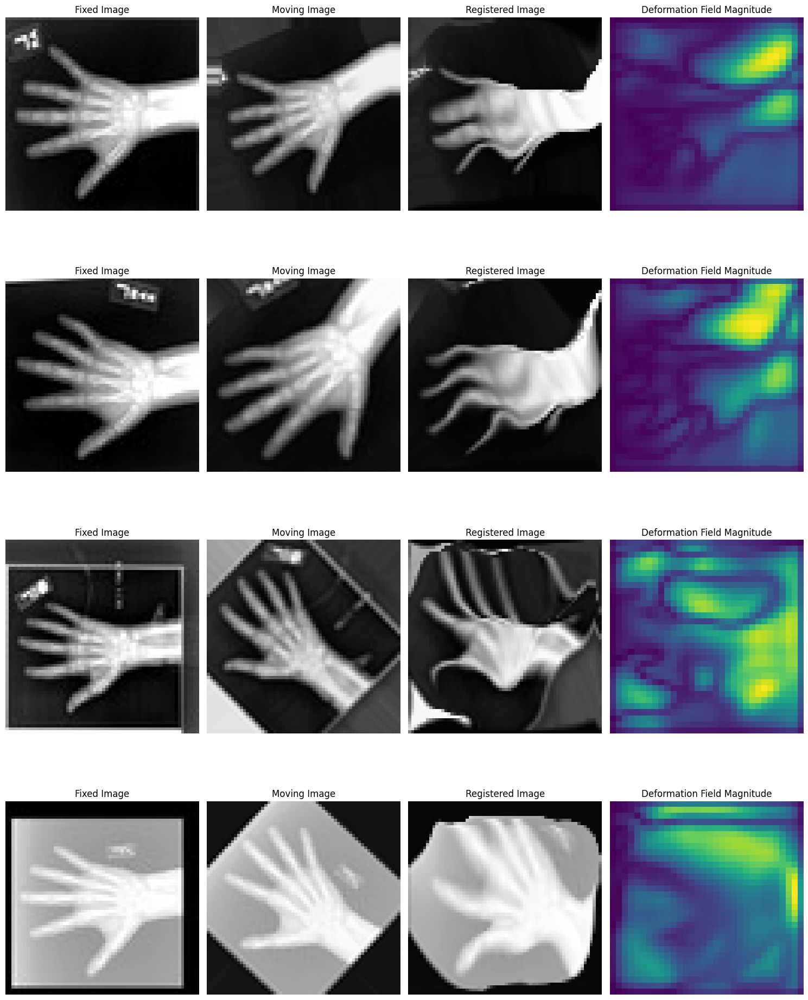

Epoch 19/400 - Validation: 100%|██████████| 32/32 [00:07<00:00,  4.09it/s, val_loss=metatensor(0.0076, device='cuda:0')]


Epoch 19/400 - Duration: 0.37 mins - Train Loss: 0.239, Train DICE: 0.575, Val Loss: 0.016, Val DICE: 0.587


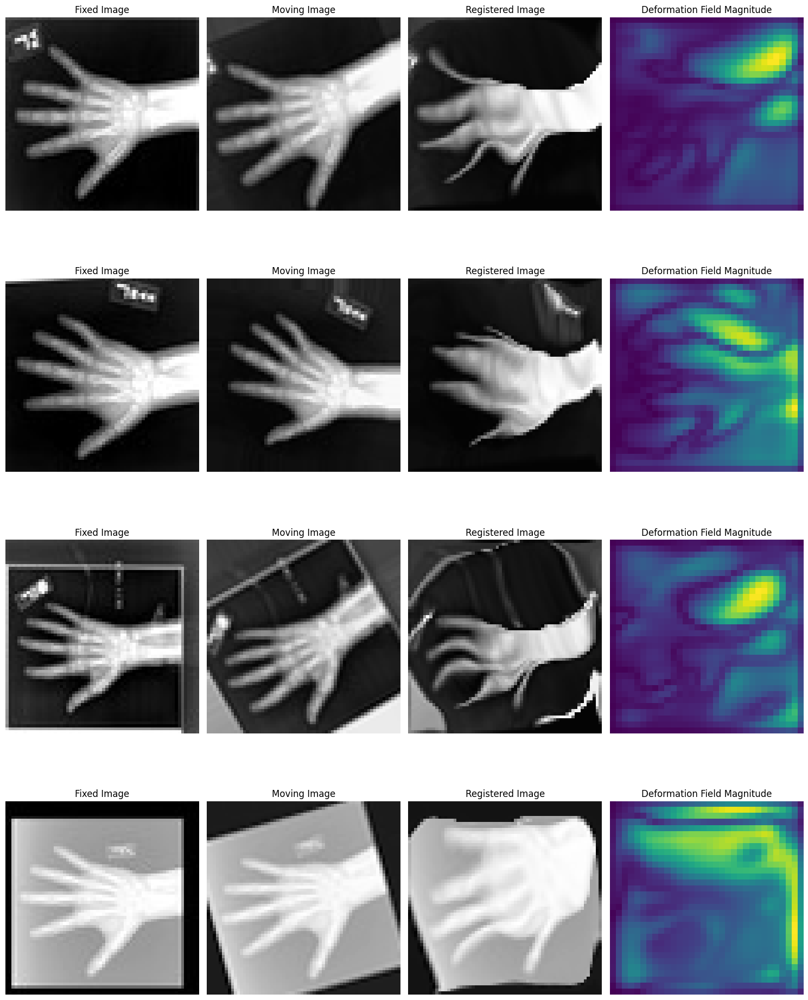

Epoch 20/400 - Validation: 100%|██████████| 32/32 [00:07<00:00,  4.40it/s, val_loss=metatensor(0.0076, device='cuda:0')]


Epoch 20/400 - Duration: 0.41 mins - Train Loss: 0.237, Train DICE: 0.575, Val Loss: 0.016, Val DICE: 0.587


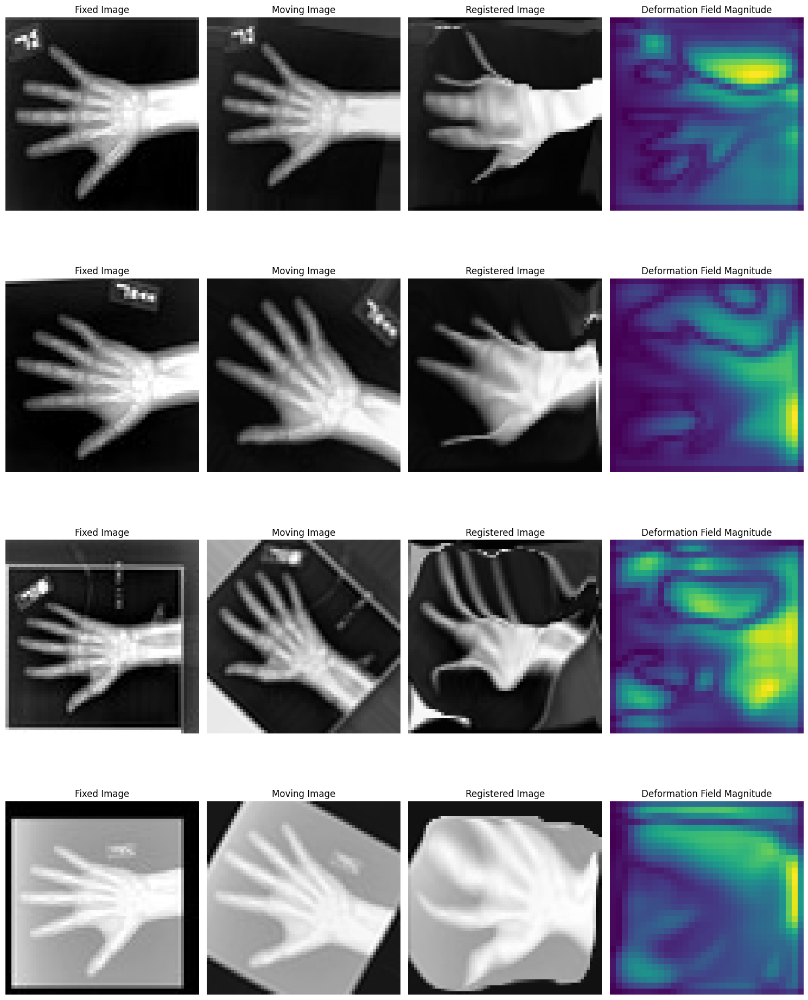

Epoch 21/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.63it/s, val_loss=metatensor(0.0078, device='cuda:0')]


Epoch 21/400 - Duration: 0.44 mins - Train Loss: 0.233, Train DICE: 0.576, Val Loss: 0.017, Val DICE: 0.589


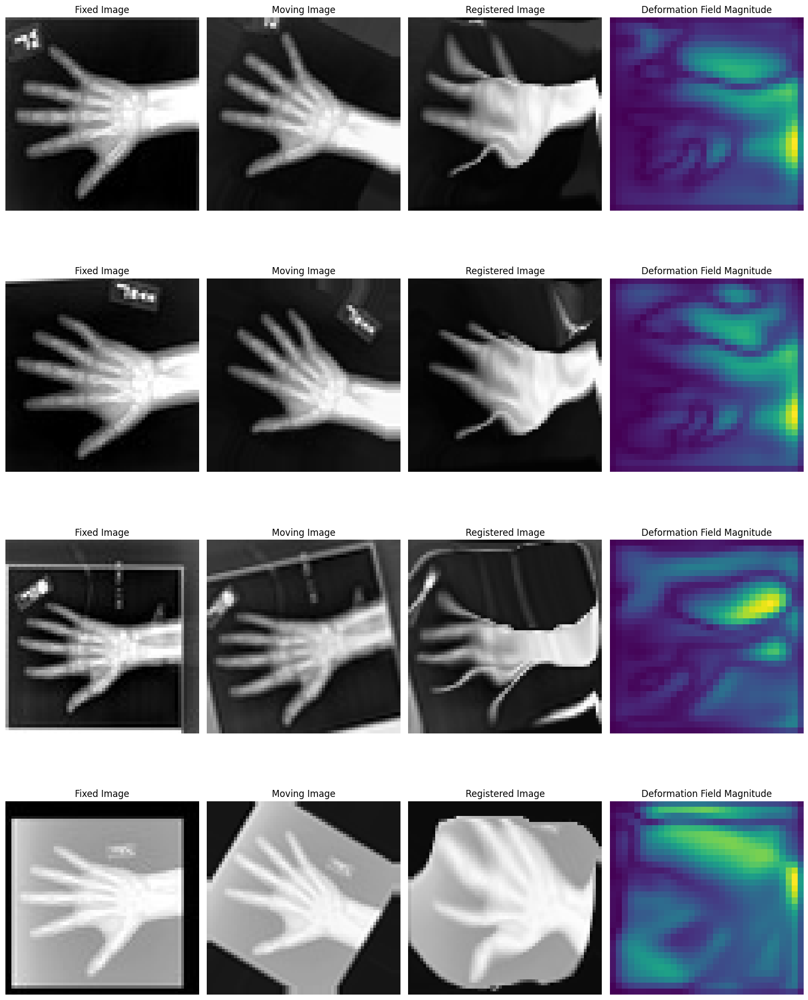

Epoch 22/400 - Validation: 100%|██████████| 32/32 [00:07<00:00,  4.10it/s, val_loss=metatensor(0.0074, device='cuda:0')]


Epoch 22/400 - Duration: 0.39 mins - Train Loss: 0.232, Train DICE: 0.578, Val Loss: 0.016, Val DICE: 0.591


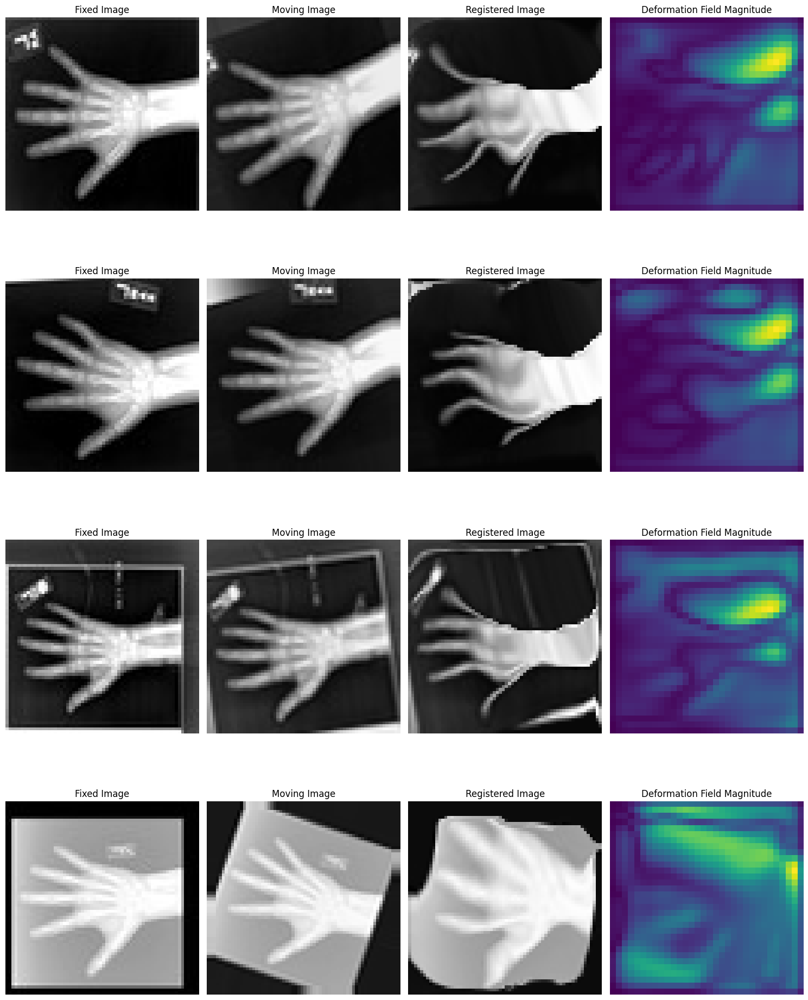

Epoch 23/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.91it/s, val_loss=metatensor(0.0082, device='cuda:0')]


Epoch 23/400 - Duration: 0.41 mins - Train Loss: 0.232, Train DICE: 0.578, Val Loss: 0.018, Val DICE: 0.589


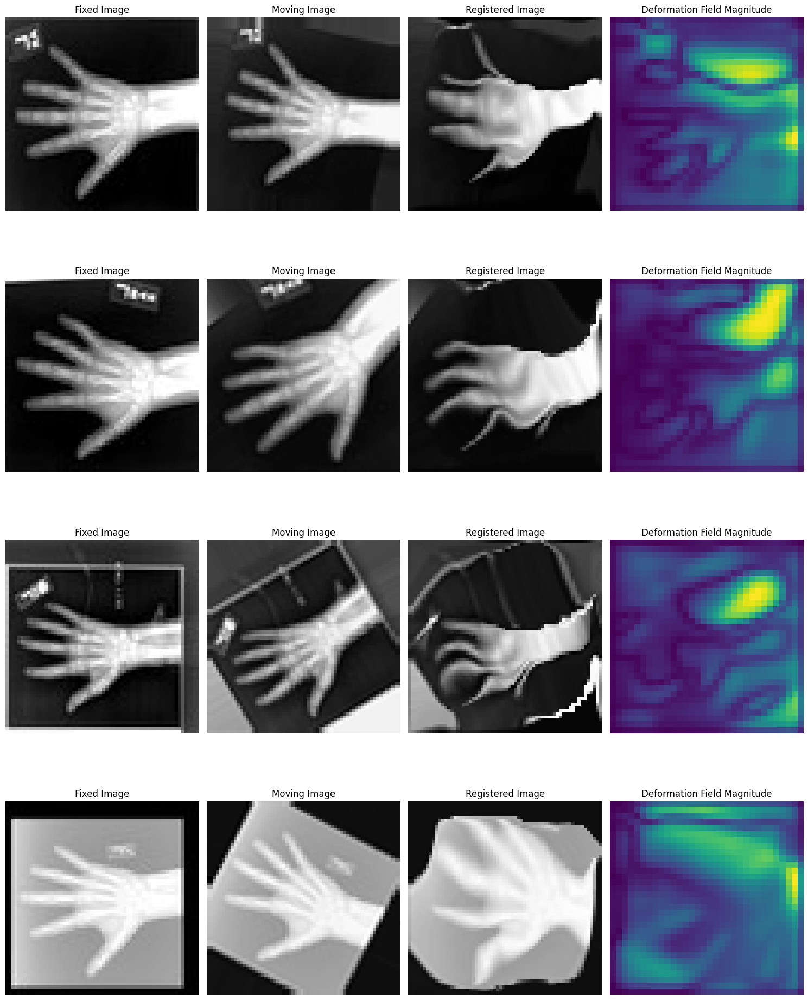

Epoch 24/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.86it/s, val_loss=metatensor(0.0082, device='cuda:0')]


Epoch 24/400 - Duration: 0.39 mins - Train Loss: 0.228, Train DICE: 0.579, Val Loss: 0.018, Val DICE: 0.592


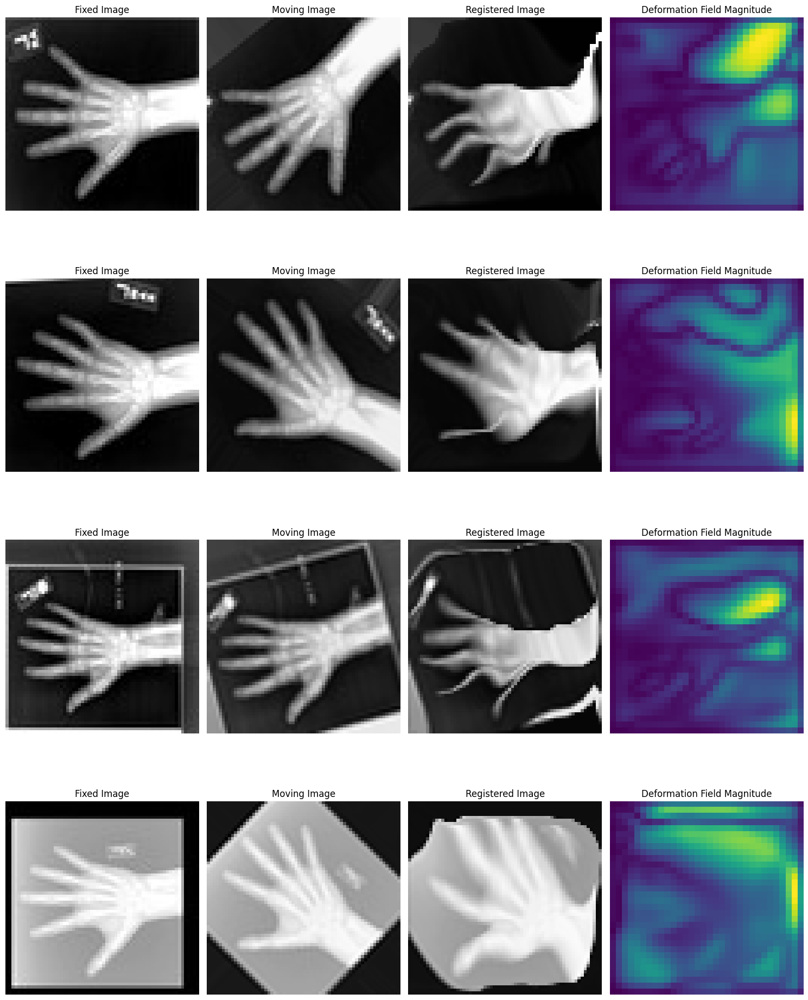

Epoch 25/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.99it/s, val_loss=metatensor(0.0092, device='cuda:0')]


Epoch 25/400 - Duration: 0.43 mins - Train Loss: 0.228, Train DICE: 0.579, Val Loss: 0.020, Val DICE: 0.591


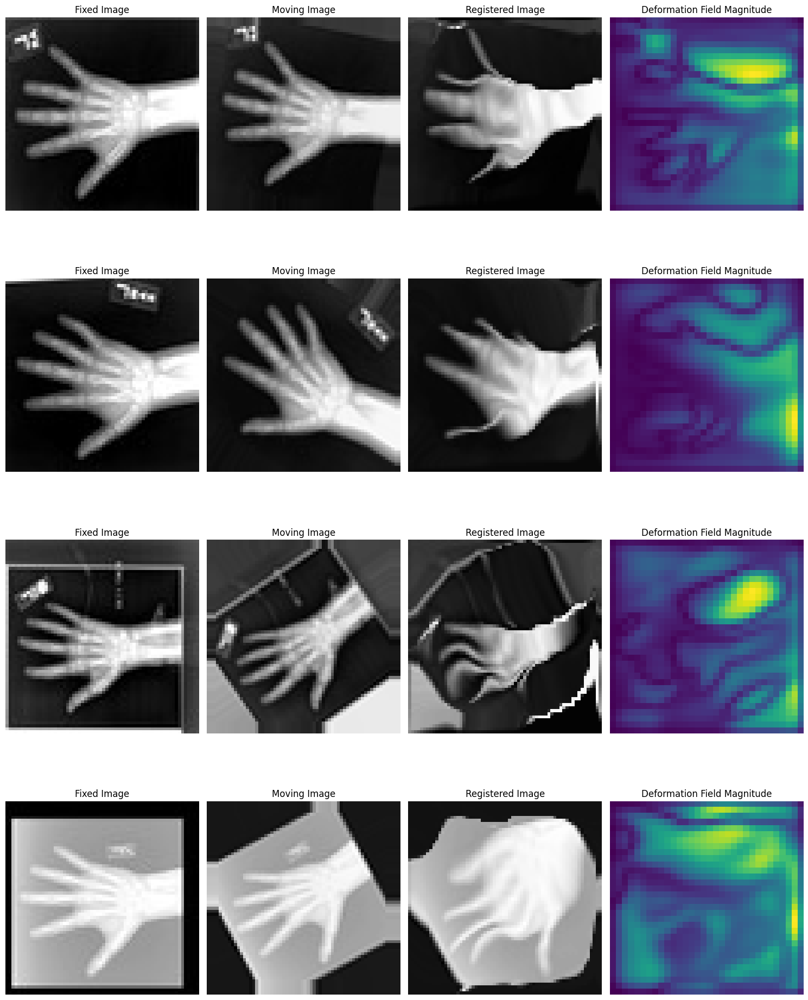

Epoch 26/400 - Validation: 100%|██████████| 32/32 [00:09<00:00,  3.54it/s, val_loss=metatensor(0.0079, device='cuda:0')]


Epoch 26/400 - Duration: 0.43 mins - Train Loss: 0.224, Train DICE: 0.581, Val Loss: 0.017, Val DICE: 0.595


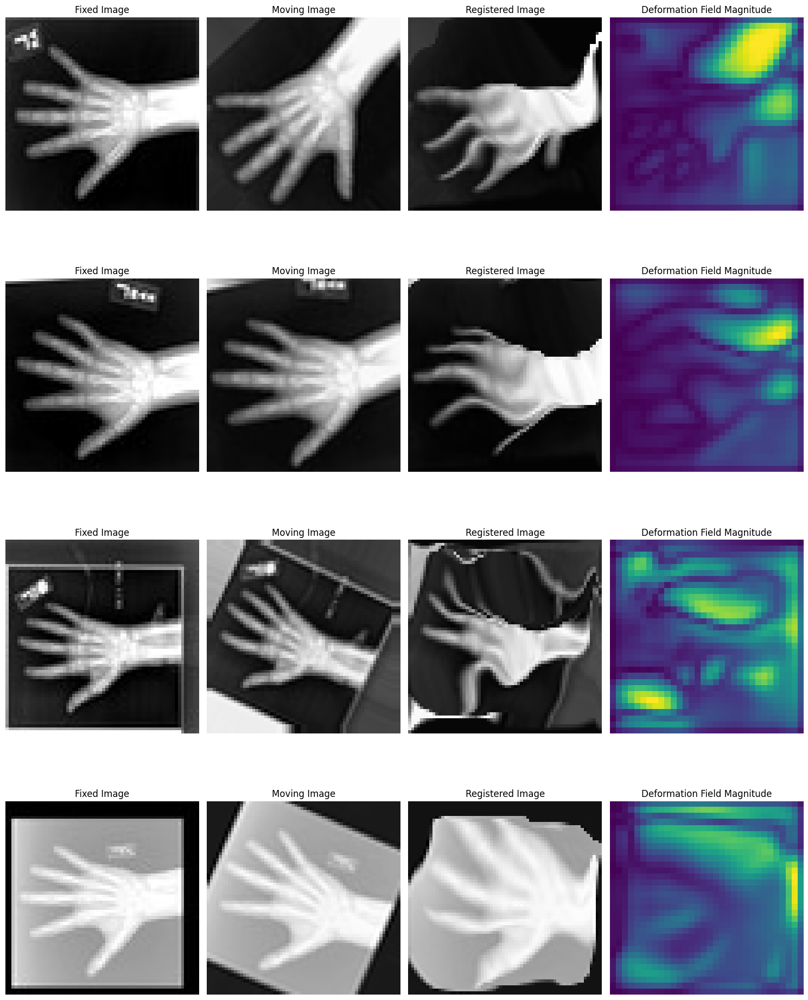

Epoch 27/400 - Validation: 100%|██████████| 32/32 [00:07<00:00,  4.03it/s, val_loss=metatensor(0.0078, device='cuda:0')]


Epoch 27/400 - Duration: 0.40 mins - Train Loss: 0.225, Train DICE: 0.580, Val Loss: 0.017, Val DICE: 0.594


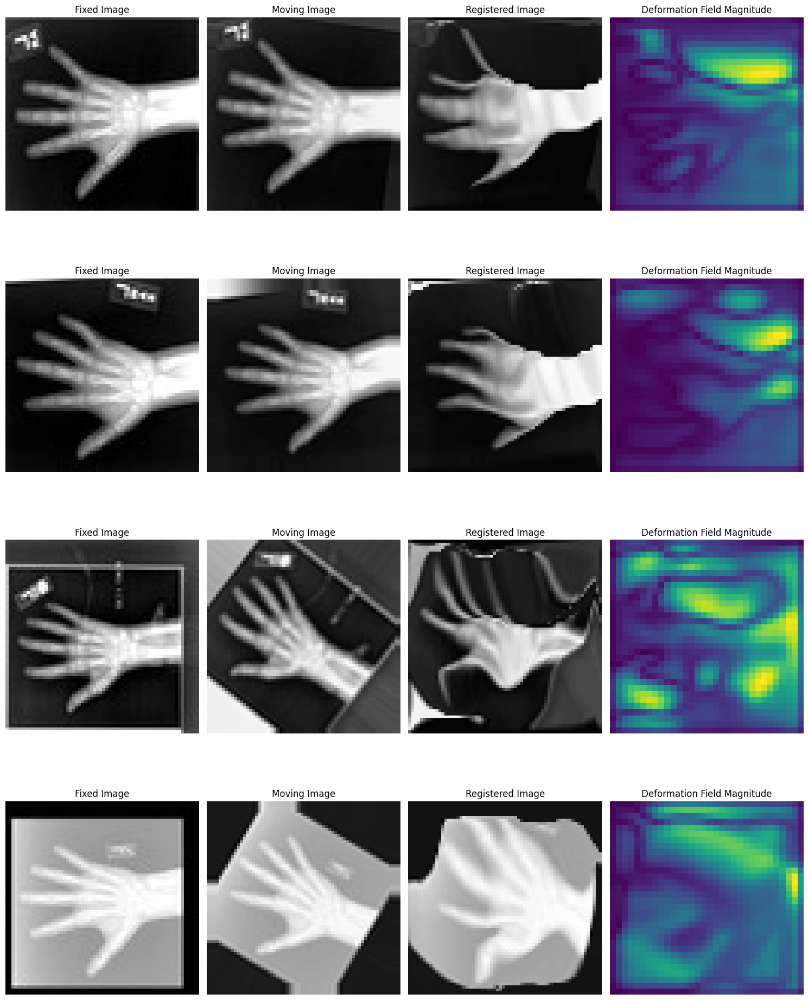

Epoch 28/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.92it/s, val_loss=metatensor(0.0079, device='cuda:0')]


Epoch 28/400 - Duration: 0.44 mins - Train Loss: 0.222, Train DICE: 0.582, Val Loss: 0.017, Val DICE: 0.593


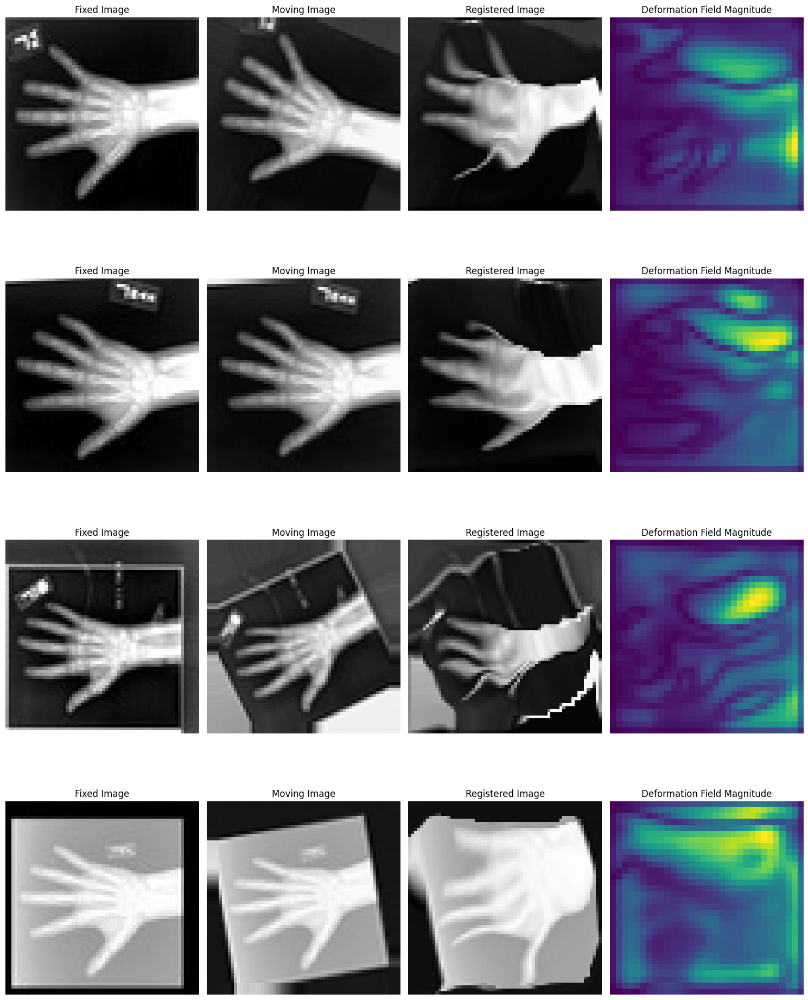

Epoch 29/400 - Validation: 100%|██████████| 32/32 [00:09<00:00,  3.52it/s, val_loss=metatensor(0.0077, device='cuda:0')]


Epoch 29/400 - Duration: 0.43 mins - Train Loss: 0.220, Train DICE: 0.581, Val Loss: 0.017, Val DICE: 0.594


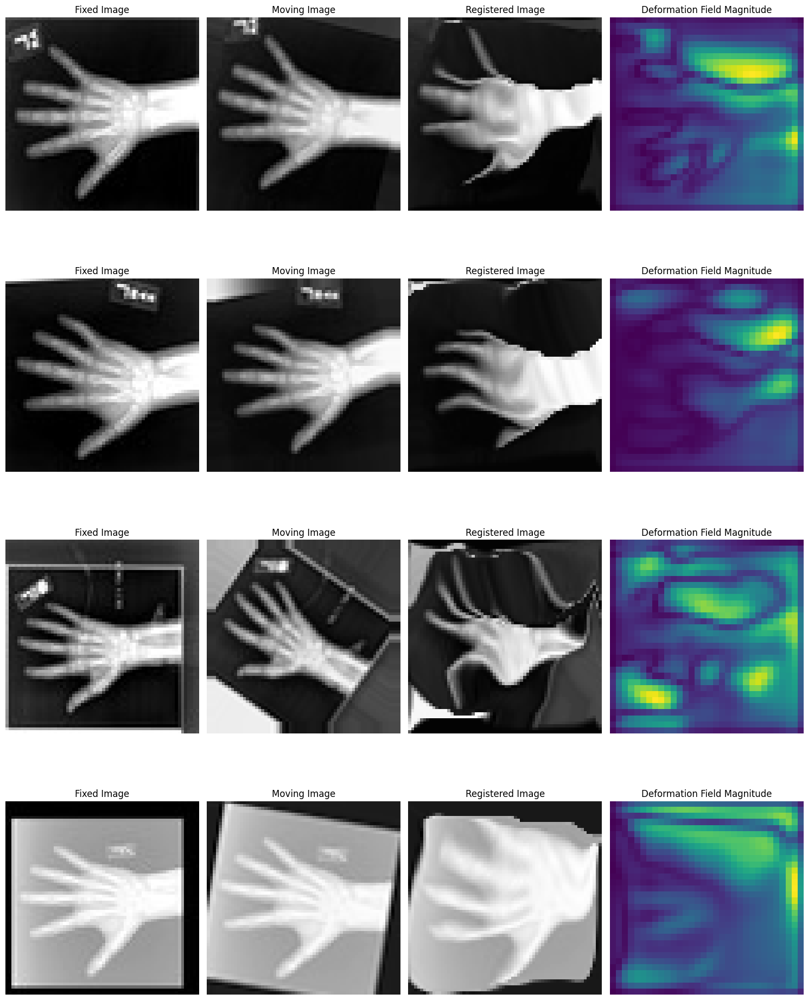

Epoch 30/400 - Validation: 100%|██████████| 32/32 [00:07<00:00,  4.00it/s, val_loss=metatensor(0.0077, device='cuda:0')]


Epoch 30/400 - Duration: 0.43 mins - Train Loss: 0.219, Train DICE: 0.582, Val Loss: 0.017, Val DICE: 0.594


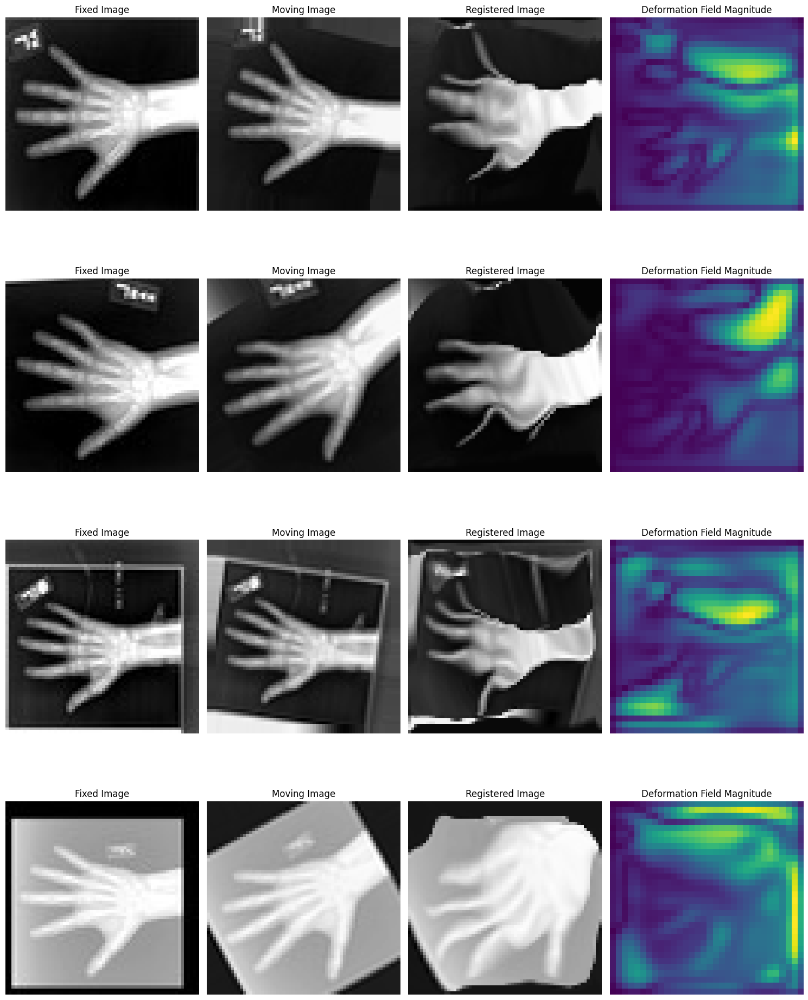

Epoch 31/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.81it/s, val_loss=metatensor(0.0079, device='cuda:0')]


Epoch 31/400 - Duration: 0.44 mins - Train Loss: 0.218, Train DICE: 0.583, Val Loss: 0.017, Val DICE: 0.596


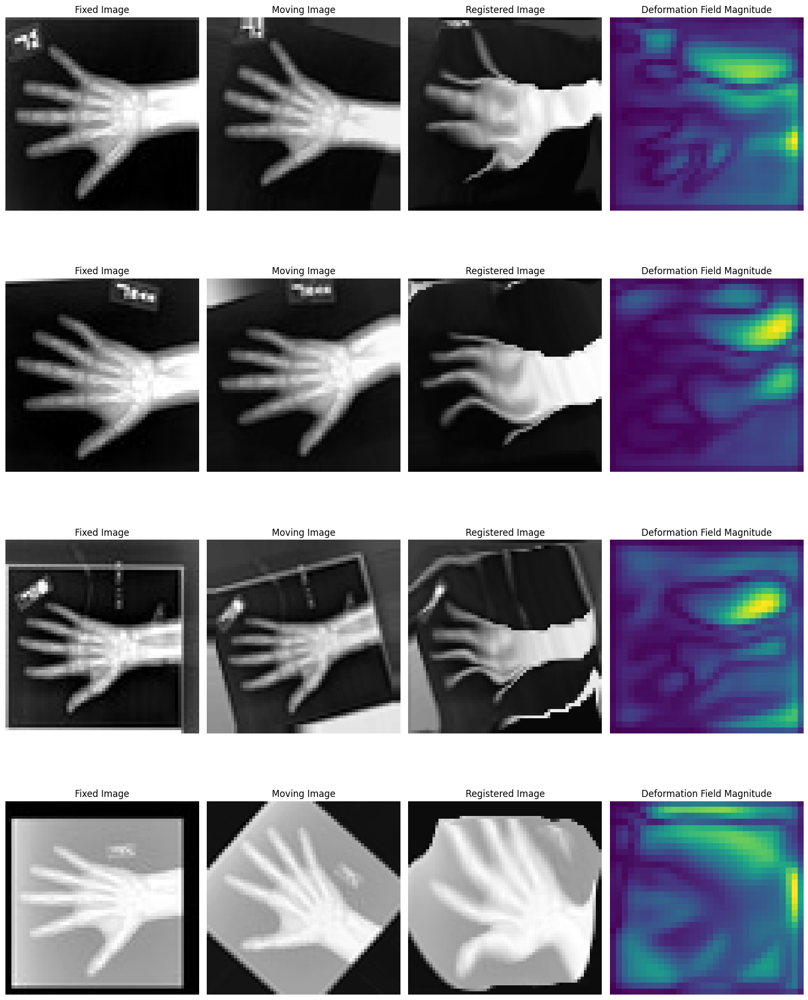

Epoch 32/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.86it/s, val_loss=metatensor(0.0078, device='cuda:0')]


Epoch 32/400 - Duration: 0.44 mins - Train Loss: 0.214, Train DICE: 0.584, Val Loss: 0.017, Val DICE: 0.595


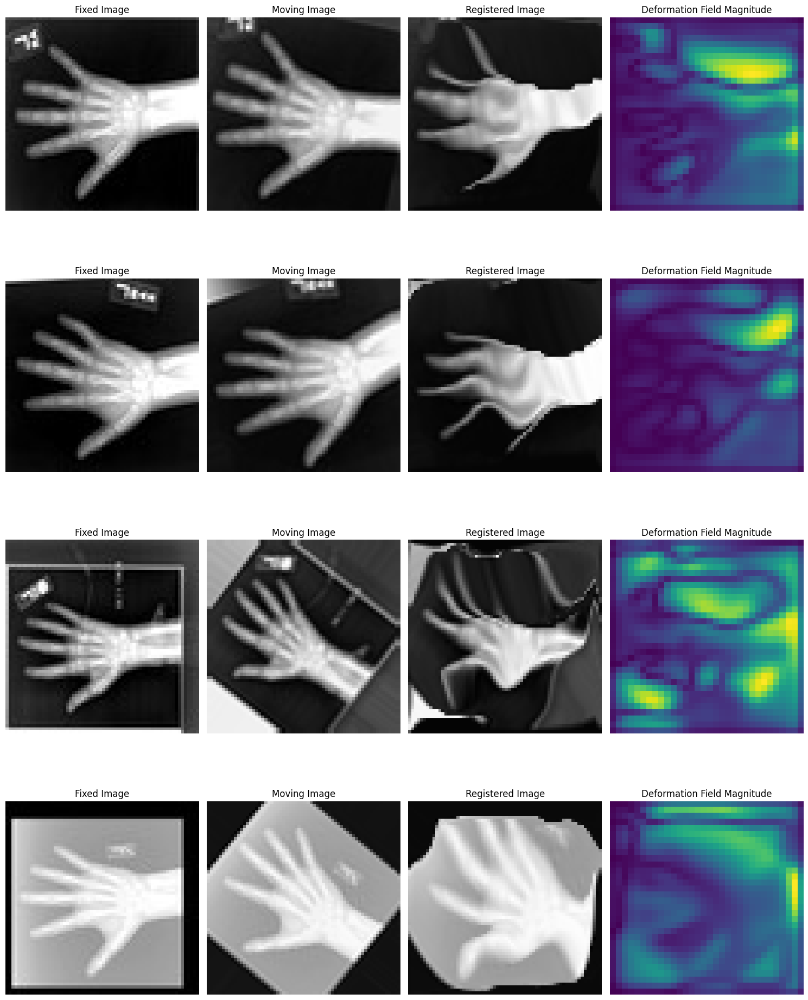

Epoch 33/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.62it/s, val_loss=metatensor(0.0069, device='cuda:0')]


Epoch 33/400 - Duration: 0.45 mins - Train Loss: 0.216, Train DICE: 0.583, Val Loss: 0.015, Val DICE: 0.596


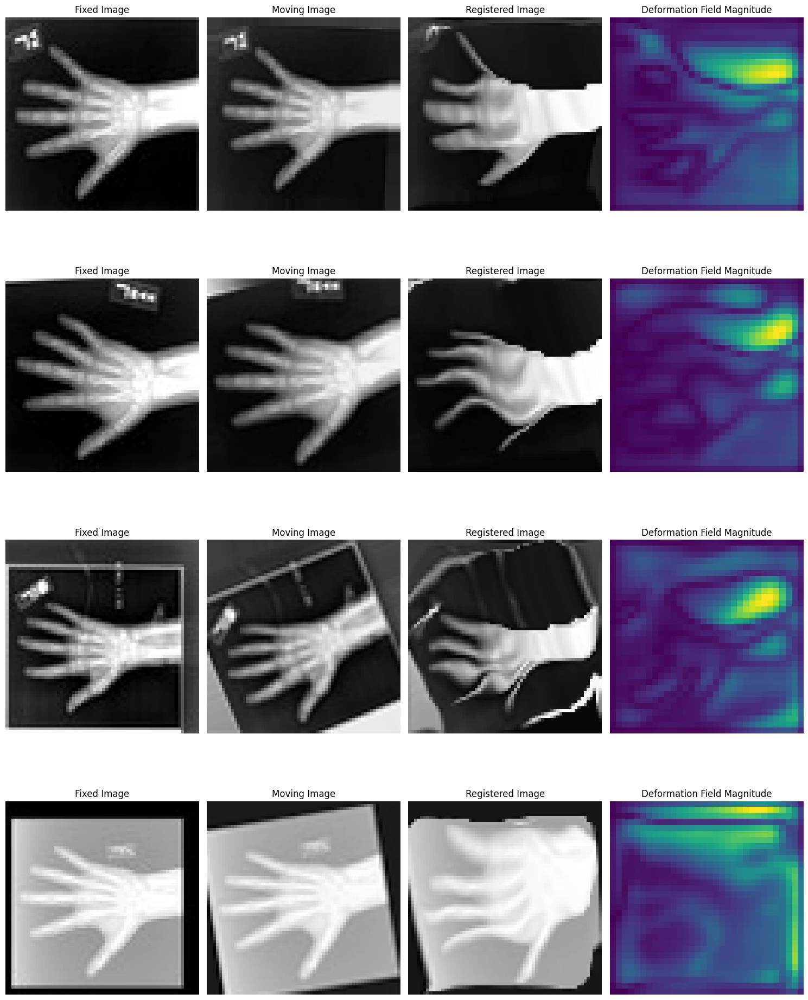

Epoch 34/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.86it/s, val_loss=metatensor(0.0078, device='cuda:0')]


Epoch 34/400 - Duration: 0.44 mins - Train Loss: 0.212, Train DICE: 0.585, Val Loss: 0.017, Val DICE: 0.598


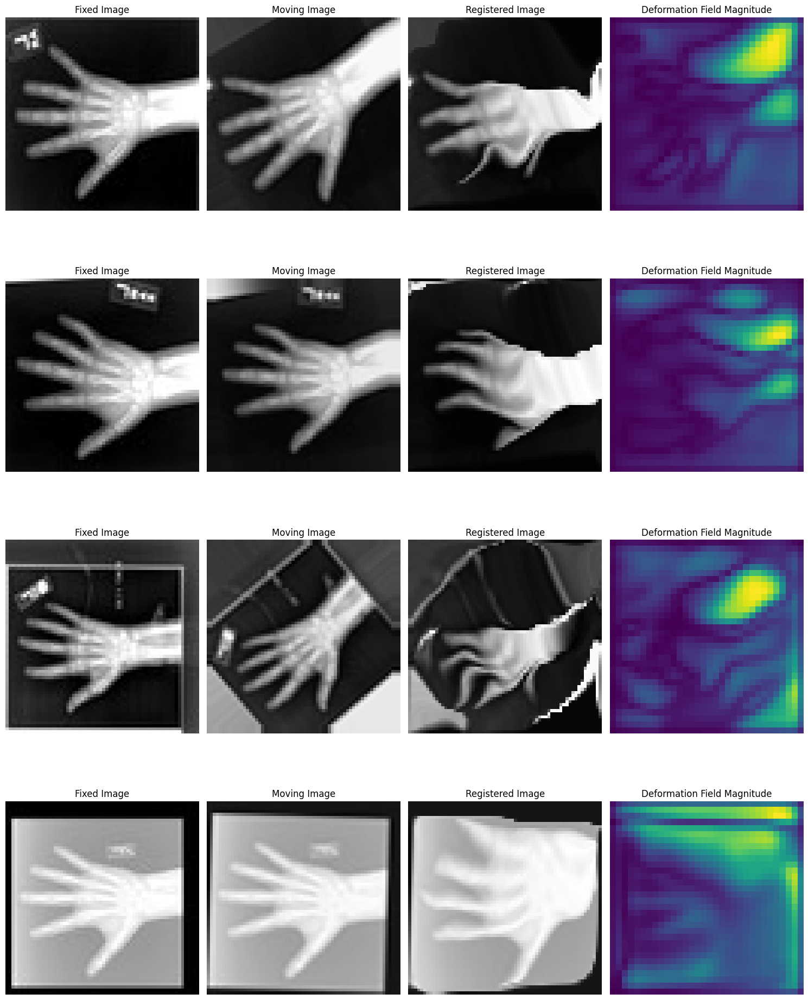

Epoch 35/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.56it/s, val_loss=metatensor(0.0062, device='cuda:0')]


Epoch 35/400 - Duration: 0.47 mins - Train Loss: 0.213, Train DICE: 0.584, Val Loss: 0.013, Val DICE: 0.599


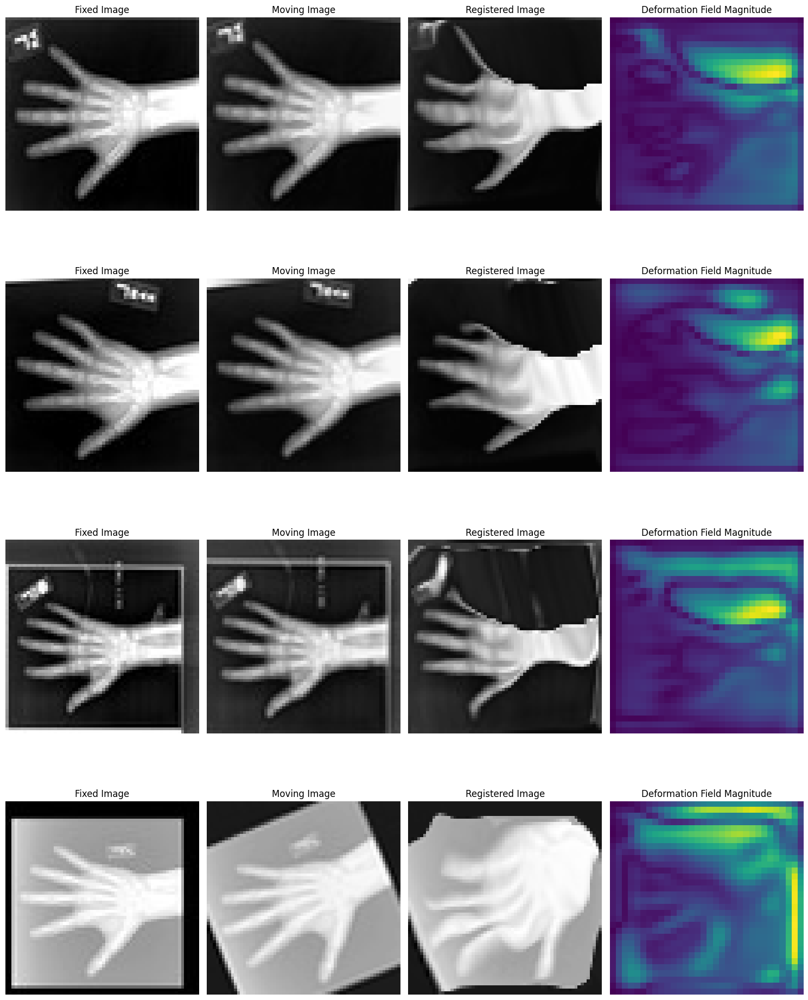

Epoch 36/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.95it/s, val_loss=metatensor(0.0080, device='cuda:0')]


Epoch 36/400 - Duration: 0.44 mins - Train Loss: 0.208, Train DICE: 0.586, Val Loss: 0.017, Val DICE: 0.596


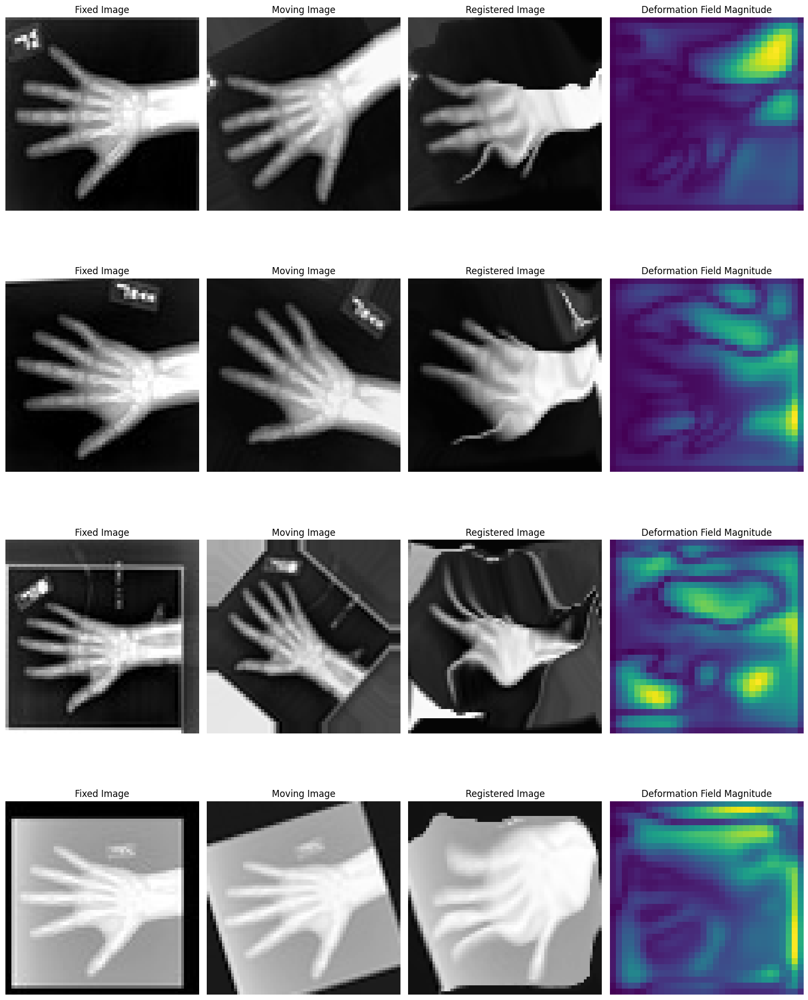

Epoch 37/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.60it/s, val_loss=metatensor(0.0078, device='cuda:0')]


Epoch 37/400 - Duration: 0.46 mins - Train Loss: 0.211, Train DICE: 0.585, Val Loss: 0.017, Val DICE: 0.598


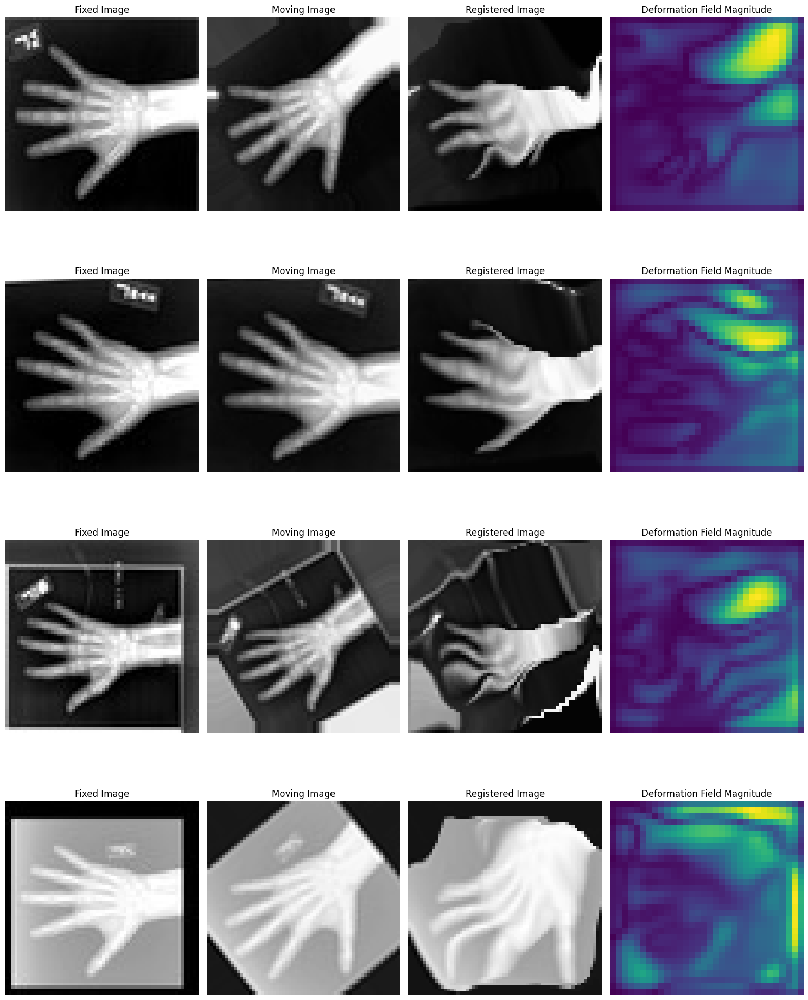

Epoch 38/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.65it/s, val_loss=metatensor(0.0073, device='cuda:0')]


Epoch 38/400 - Duration: 0.44 mins - Train Loss: 0.210, Train DICE: 0.585, Val Loss: 0.016, Val DICE: 0.600


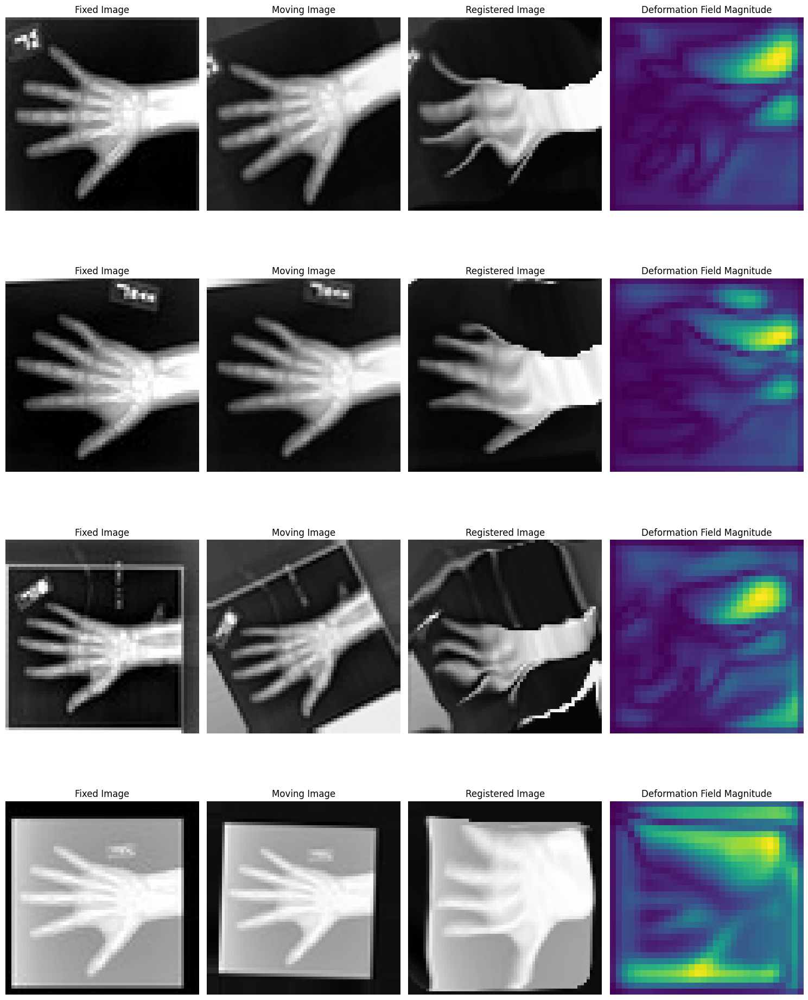

Epoch 39/400 - Validation: 100%|██████████| 32/32 [00:09<00:00,  3.45it/s, val_loss=metatensor(0.0073, device='cuda:0')]


Epoch 39/400 - Duration: 0.45 mins - Train Loss: 0.205, Train DICE: 0.587, Val Loss: 0.016, Val DICE: 0.598


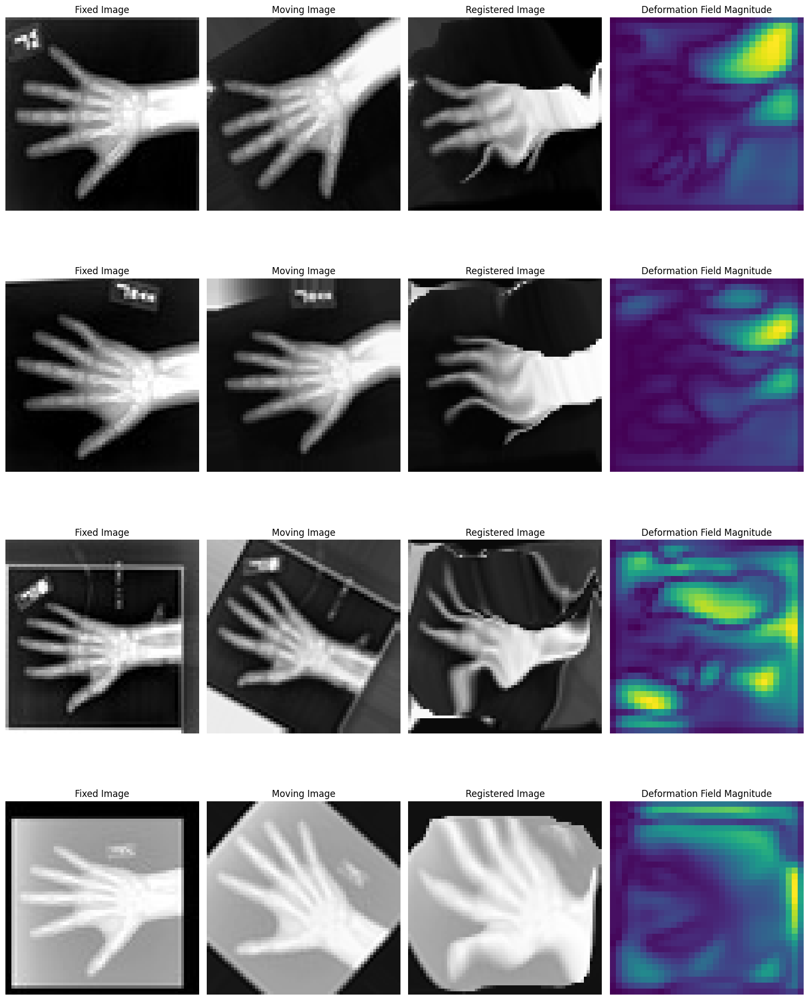

Epoch 40/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.76it/s, val_loss=metatensor(0.0074, device='cuda:0')]


Epoch 40/400 - Duration: 0.45 mins - Train Loss: 0.209, Train DICE: 0.586, Val Loss: 0.016, Val DICE: 0.599


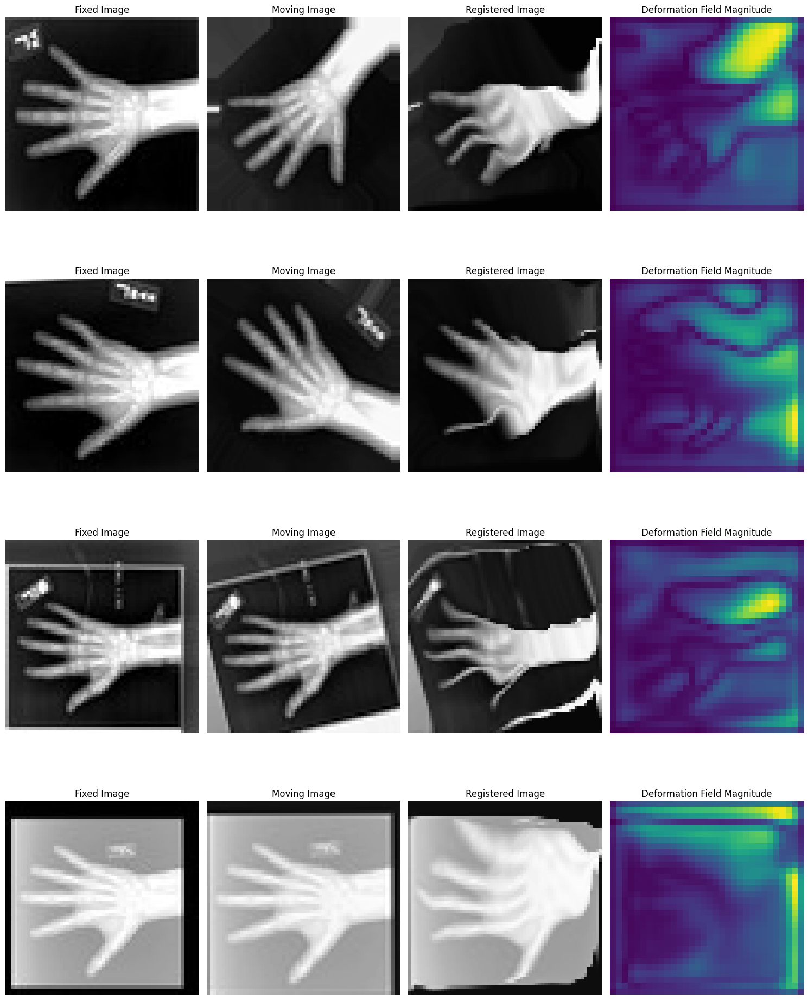

Epoch 41/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.64it/s, val_loss=metatensor(0.0081, device='cuda:0')]


Epoch 41/400 - Duration: 0.45 mins - Train Loss: 0.203, Train DICE: 0.588, Val Loss: 0.017, Val DICE: 0.597


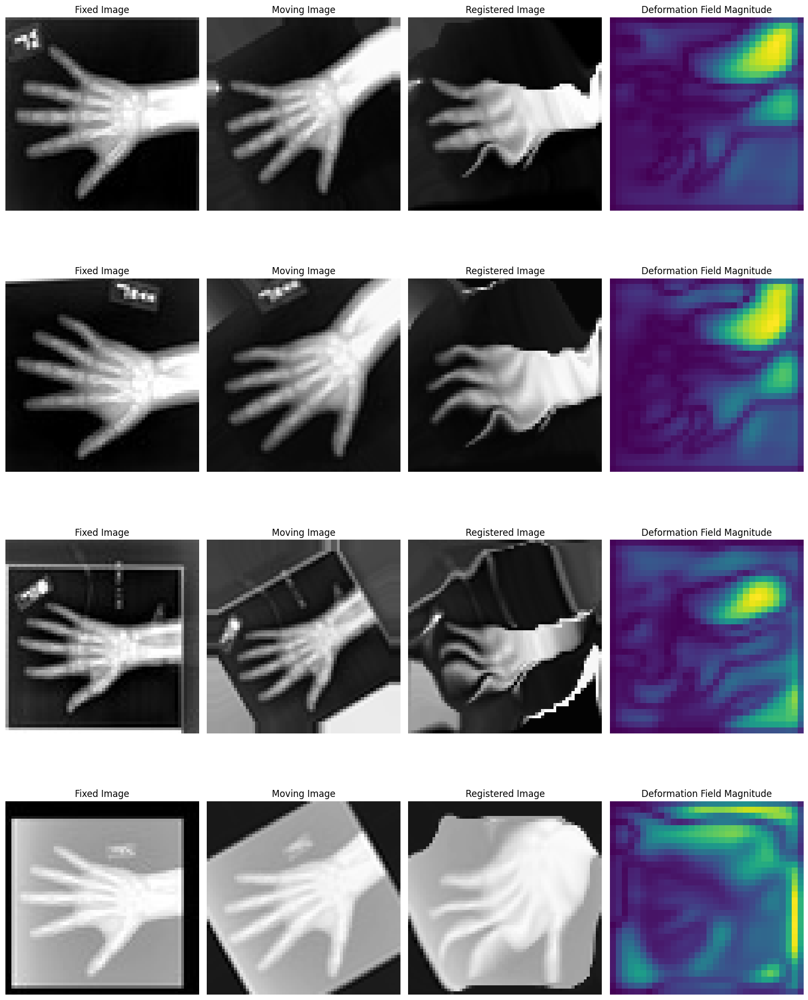

Epoch 42/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.63it/s, val_loss=metatensor(0.0067, device='cuda:0')]


Epoch 42/400 - Duration: 0.44 mins - Train Loss: 0.204, Train DICE: 0.587, Val Loss: 0.014, Val DICE: 0.600


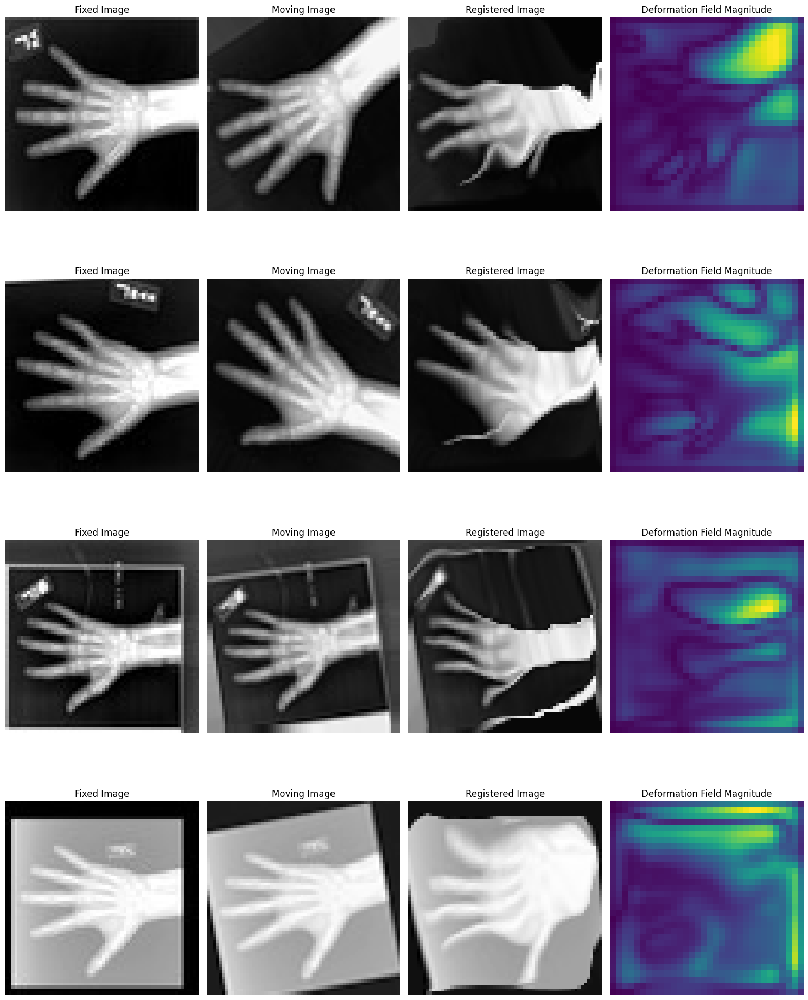

Epoch 43/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.83it/s, val_loss=metatensor(0.0066, device='cuda:0')]


Epoch 43/400 - Duration: 0.44 mins - Train Loss: 0.204, Train DICE: 0.588, Val Loss: 0.014, Val DICE: 0.600


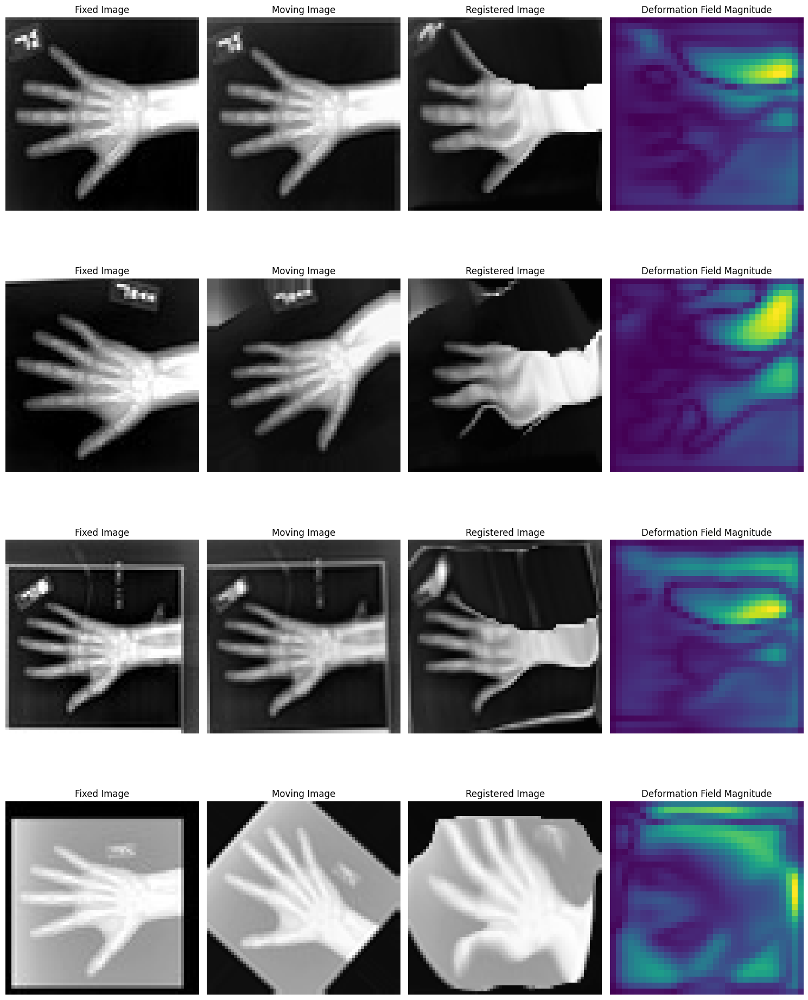

Epoch 44/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.70it/s, val_loss=metatensor(0.0075, device='cuda:0')]


Epoch 44/400 - Duration: 0.45 mins - Train Loss: 0.202, Train DICE: 0.589, Val Loss: 0.016, Val DICE: 0.600


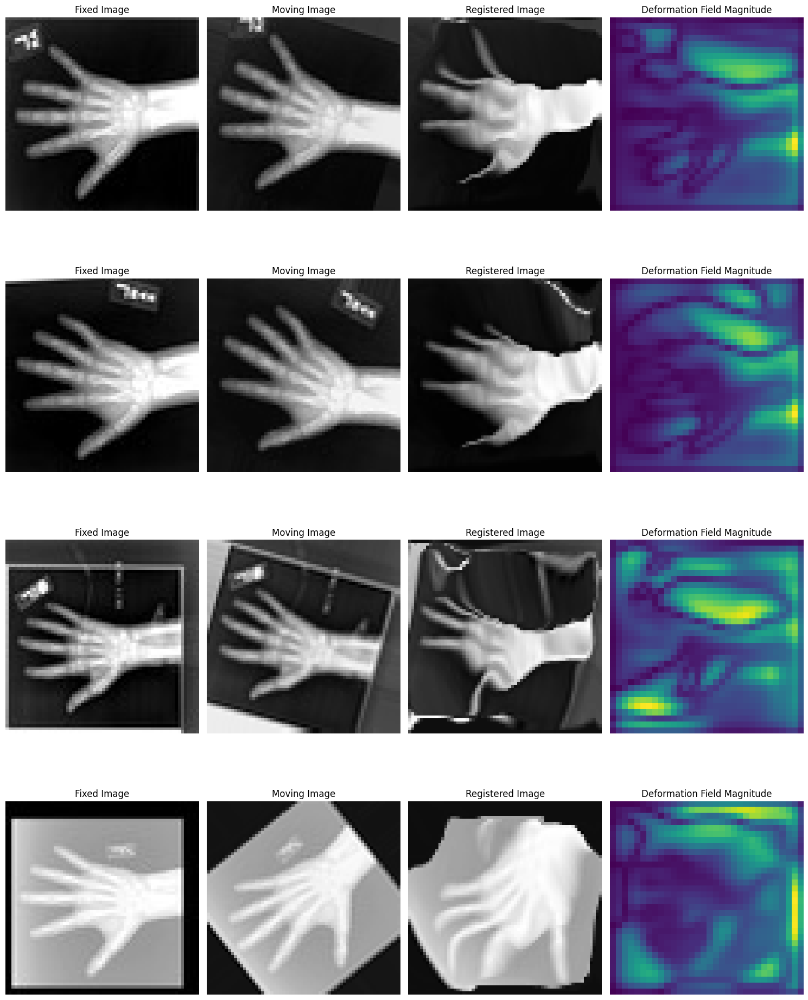

Epoch 45/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.70it/s, val_loss=metatensor(0.0075, device='cuda:0')]


Epoch 45/400 - Duration: 0.45 mins - Train Loss: 0.201, Train DICE: 0.589, Val Loss: 0.016, Val DICE: 0.601


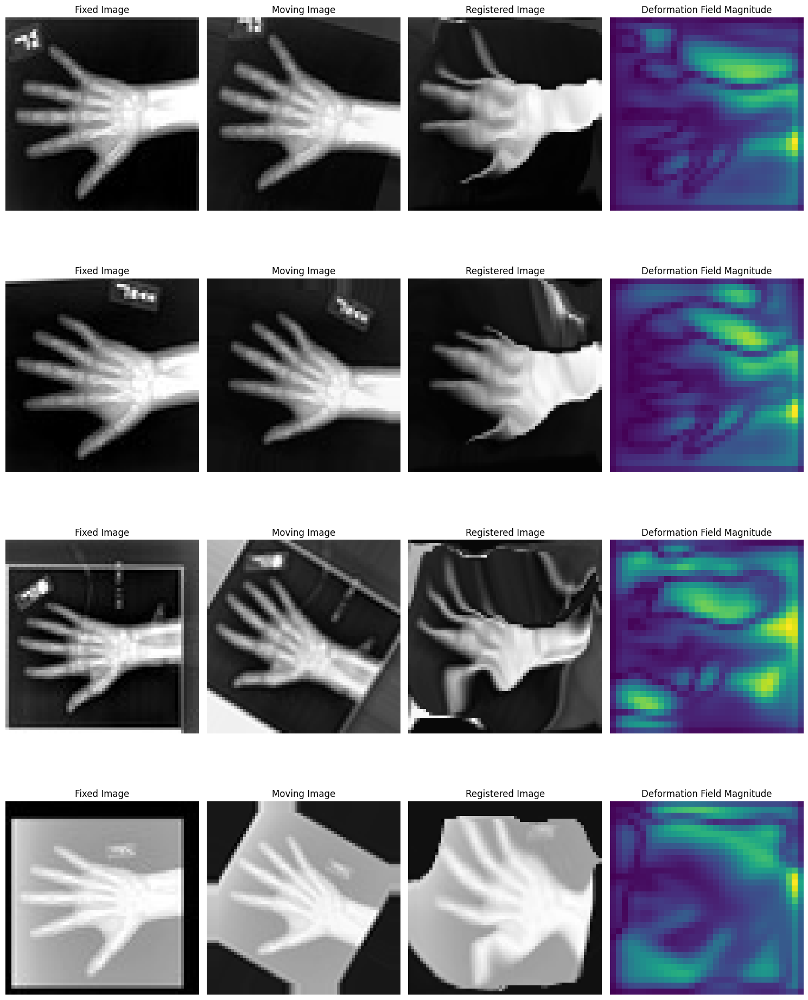

Epoch 46/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.67it/s, val_loss=metatensor(0.0073, device='cuda:0')]


Epoch 46/400 - Duration: 0.45 mins - Train Loss: 0.203, Train DICE: 0.588, Val Loss: 0.016, Val DICE: 0.601


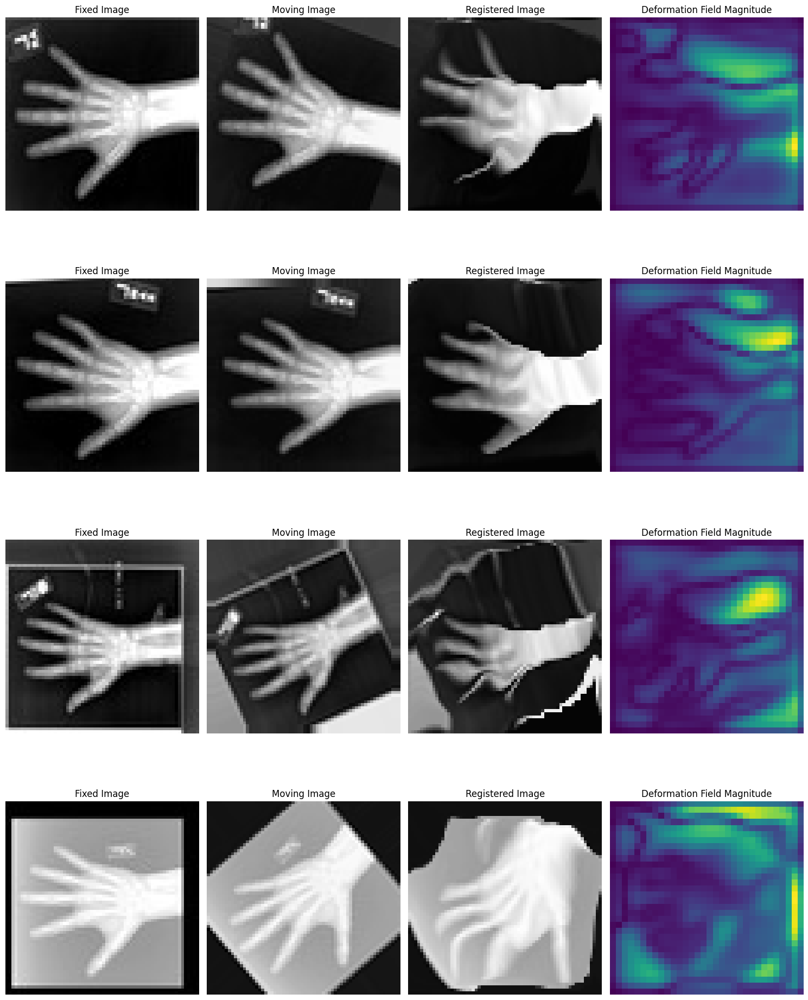

Epoch 47/400 - Validation: 100%|██████████| 32/32 [00:09<00:00,  3.50it/s, val_loss=metatensor(0.0076, device='cuda:0')]


Epoch 47/400 - Duration: 0.46 mins - Train Loss: 0.201, Train DICE: 0.589, Val Loss: 0.016, Val DICE: 0.601


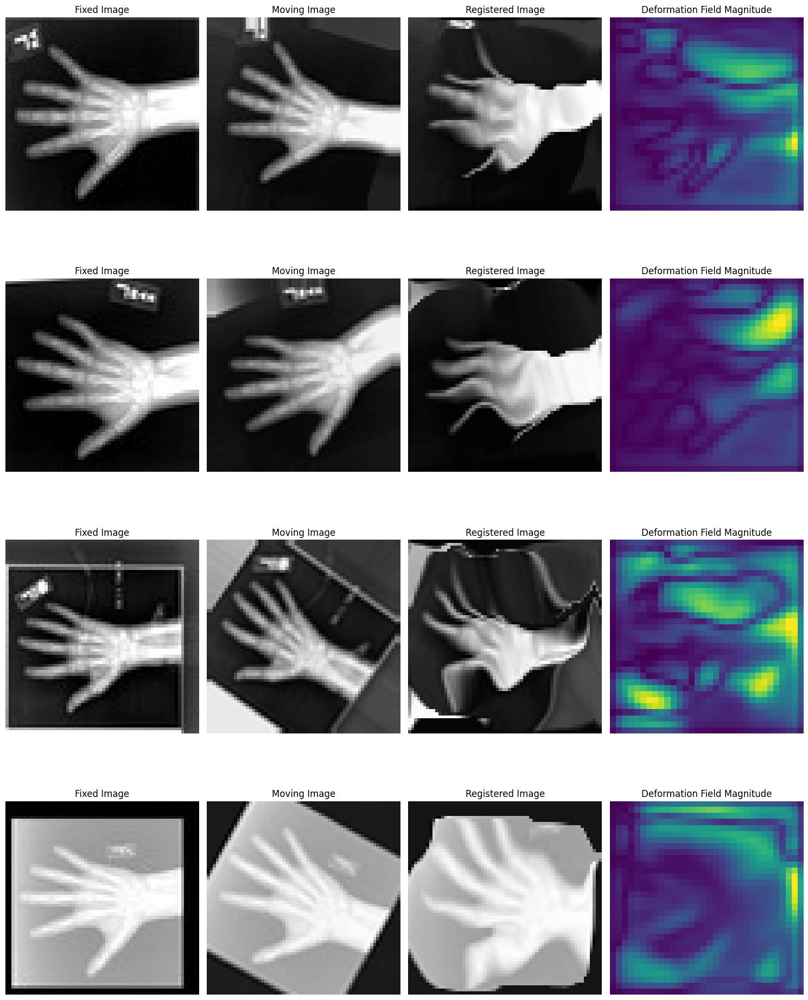

Epoch 48/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.73it/s, val_loss=metatensor(0.0069, device='cuda:0')]


Epoch 48/400 - Duration: 0.43 mins - Train Loss: 0.198, Train DICE: 0.590, Val Loss: 0.015, Val DICE: 0.601


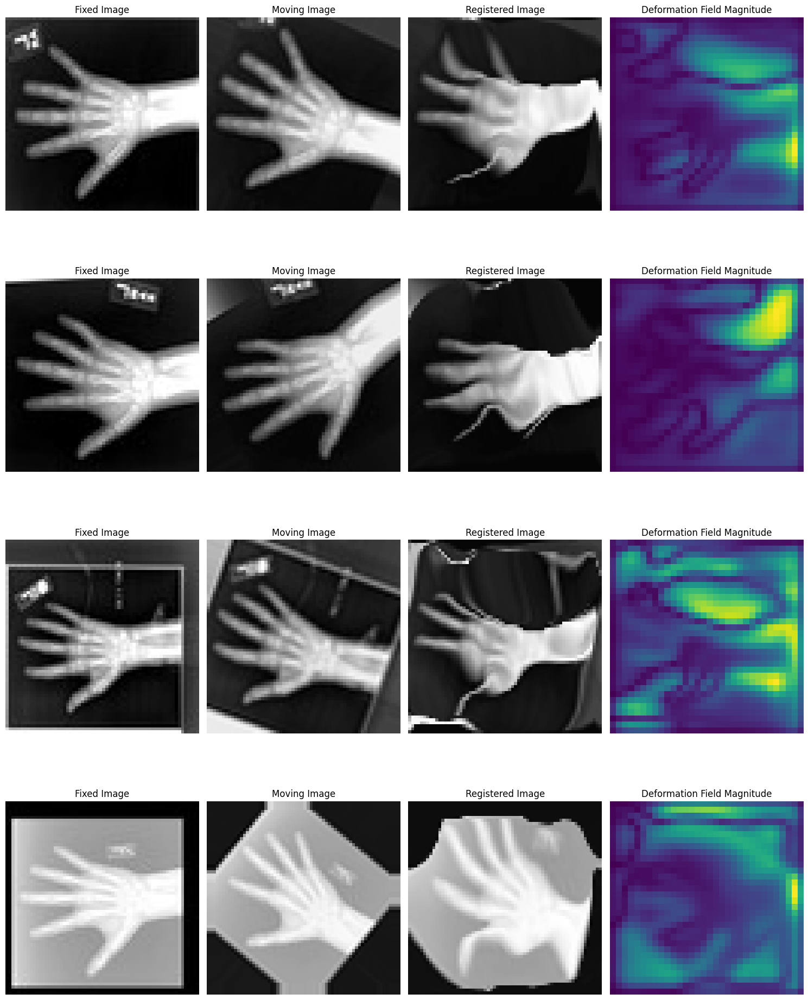

Epoch 49/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.66it/s, val_loss=metatensor(0.0074, device='cuda:0')]


Epoch 49/400 - Duration: 0.45 mins - Train Loss: 0.196, Train DICE: 0.591, Val Loss: 0.016, Val DICE: 0.602


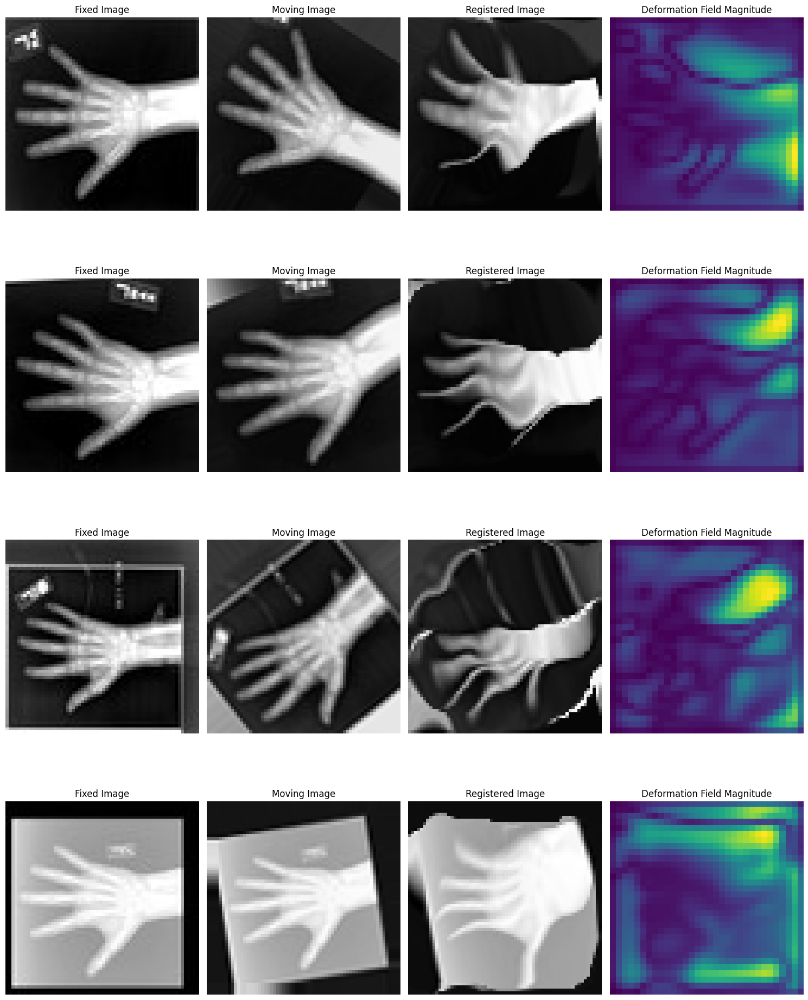

Epoch 50/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.96it/s, val_loss=metatensor(0.0059, device='cuda:0')]


Epoch 50/400 - Duration: 0.44 mins - Train Loss: 0.198, Train DICE: 0.590, Val Loss: 0.013, Val DICE: 0.603


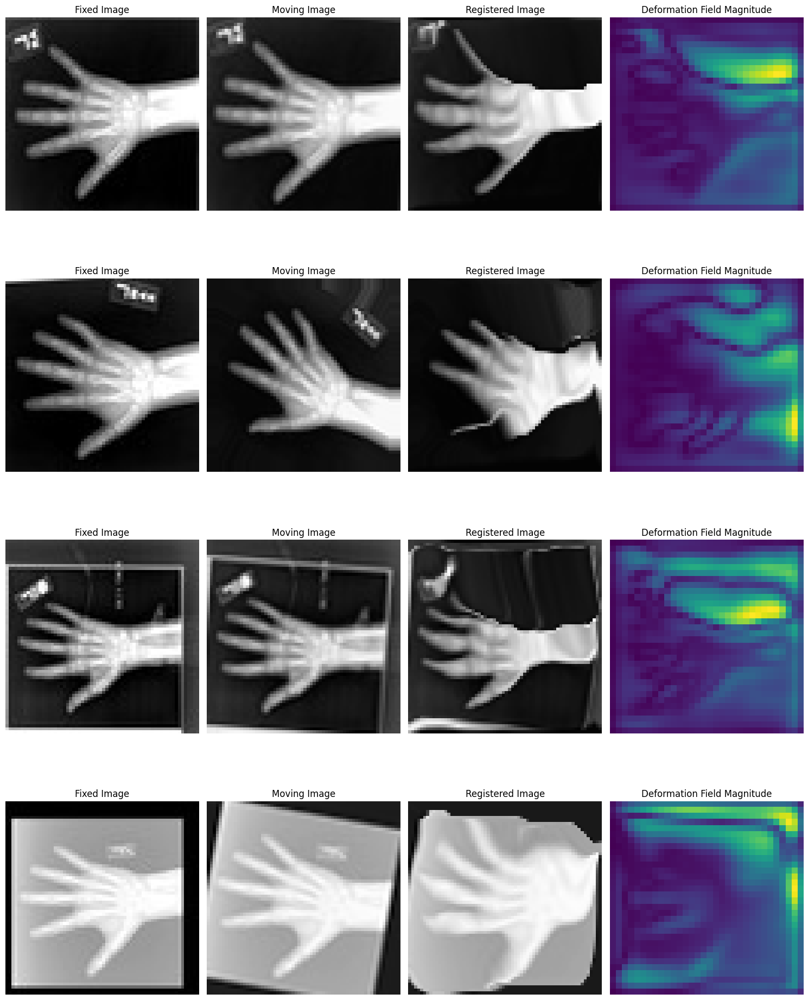

Epoch 51/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.69it/s, val_loss=metatensor(0.0071, device='cuda:0')]


Epoch 51/400 - Duration: 0.45 mins - Train Loss: 0.198, Train DICE: 0.591, Val Loss: 0.015, Val DICE: 0.601


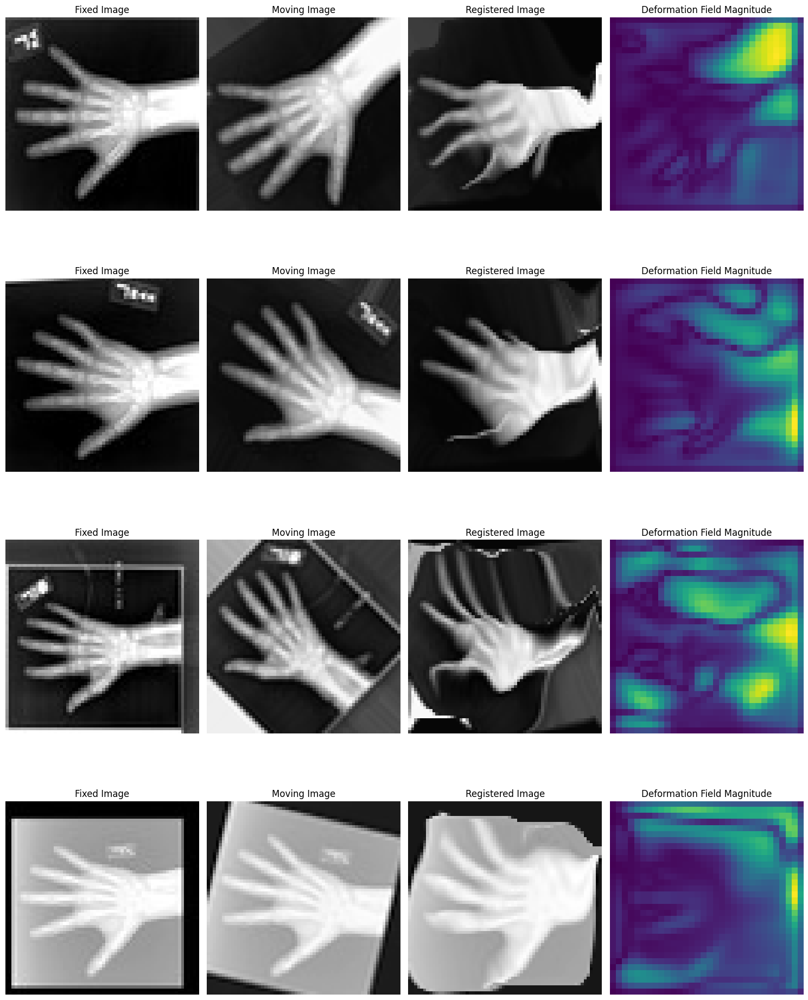

Epoch 52/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.73it/s, val_loss=metatensor(0.0060, device='cuda:0')]


Epoch 52/400 - Duration: 0.45 mins - Train Loss: 0.193, Train DICE: 0.592, Val Loss: 0.013, Val DICE: 0.604


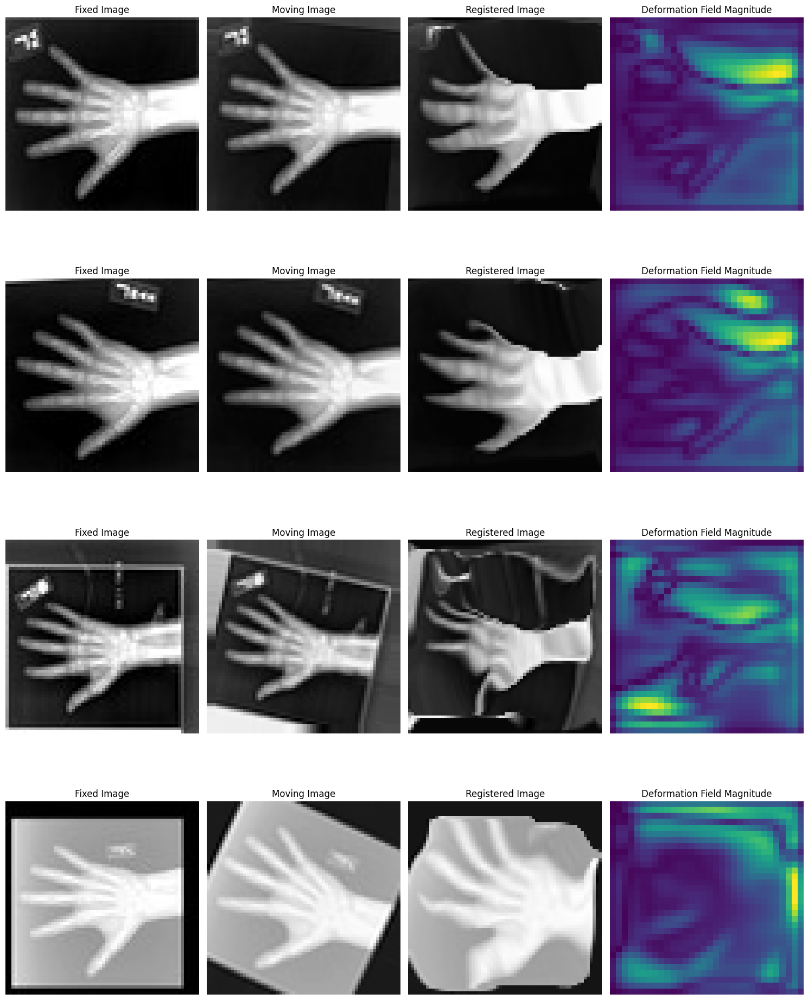

Epoch 53/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.63it/s, val_loss=metatensor(0.0070, device='cuda:0')]


Epoch 53/400 - Duration: 0.45 mins - Train Loss: 0.197, Train DICE: 0.591, Val Loss: 0.015, Val DICE: 0.604


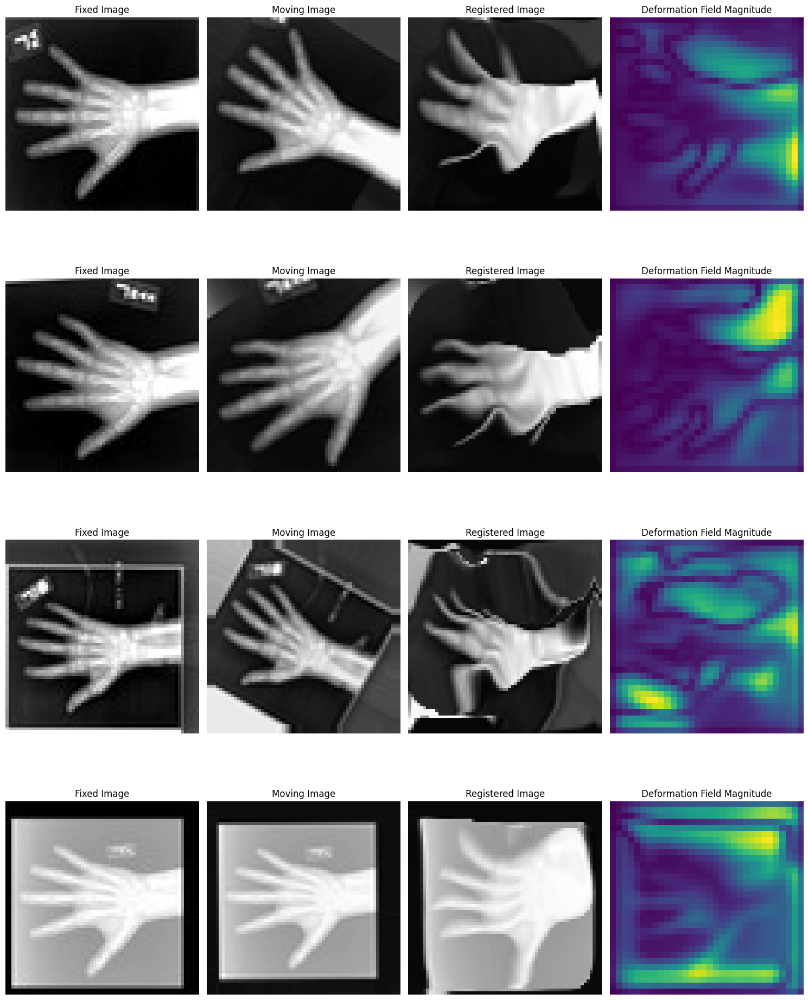

Epoch 54/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.69it/s, val_loss=metatensor(0.0066, device='cuda:0')]


Epoch 54/400 - Duration: 0.44 mins - Train Loss: 0.197, Train DICE: 0.591, Val Loss: 0.014, Val DICE: 0.603


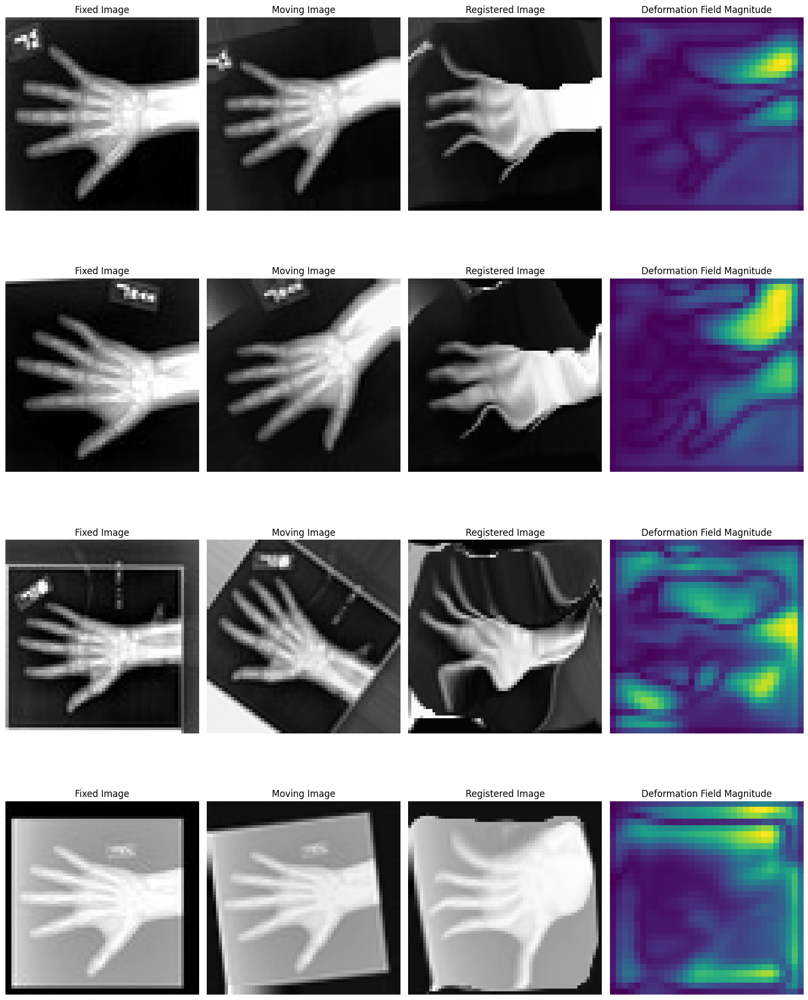

Epoch 55/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.78it/s, val_loss=metatensor(0.0074, device='cuda:0')]


Epoch 55/400 - Duration: 0.45 mins - Train Loss: 0.193, Train DICE: 0.592, Val Loss: 0.016, Val DICE: 0.602


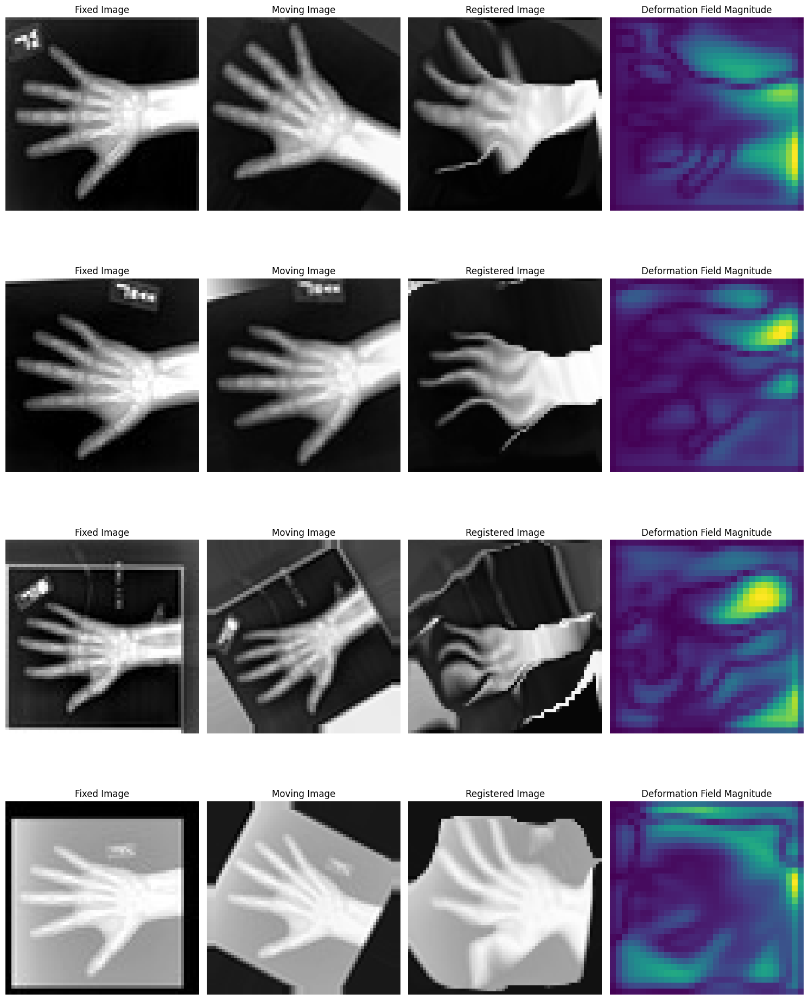

Epoch 56/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.72it/s, val_loss=metatensor(0.0067, device='cuda:0')]


Epoch 56/400 - Duration: 0.44 mins - Train Loss: 0.194, Train DICE: 0.591, Val Loss: 0.015, Val DICE: 0.602


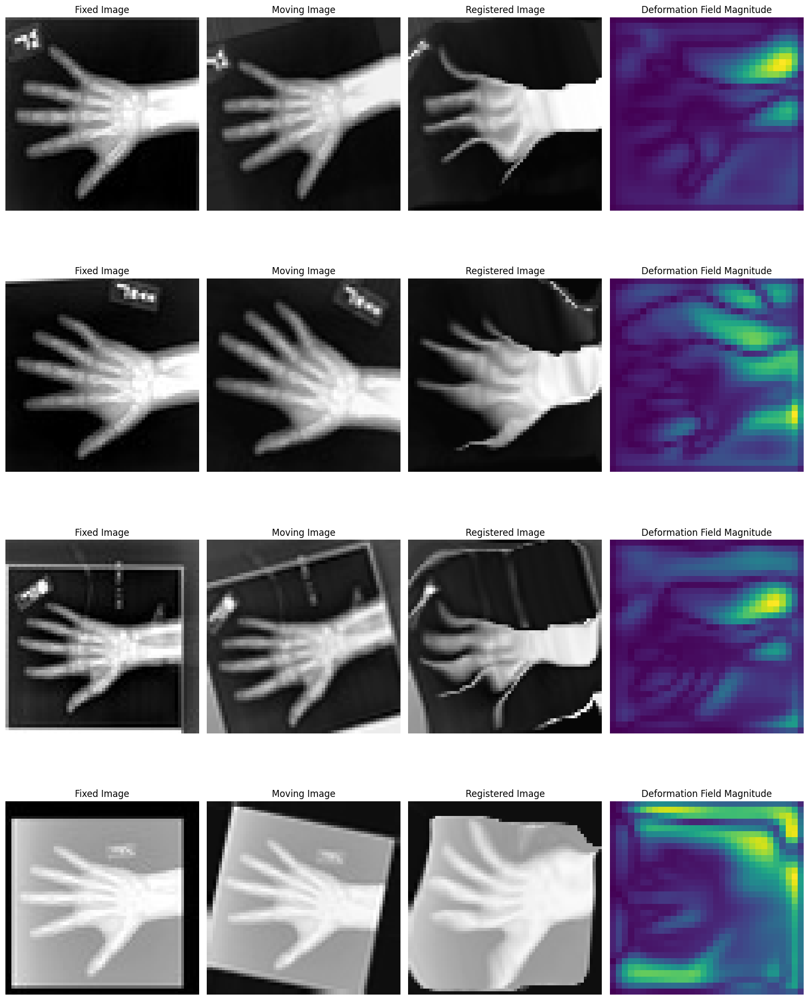

Epoch 57/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.56it/s, val_loss=metatensor(0.0072, device='cuda:0')]


Epoch 57/400 - Duration: 0.45 mins - Train Loss: 0.192, Train DICE: 0.592, Val Loss: 0.016, Val DICE: 0.602


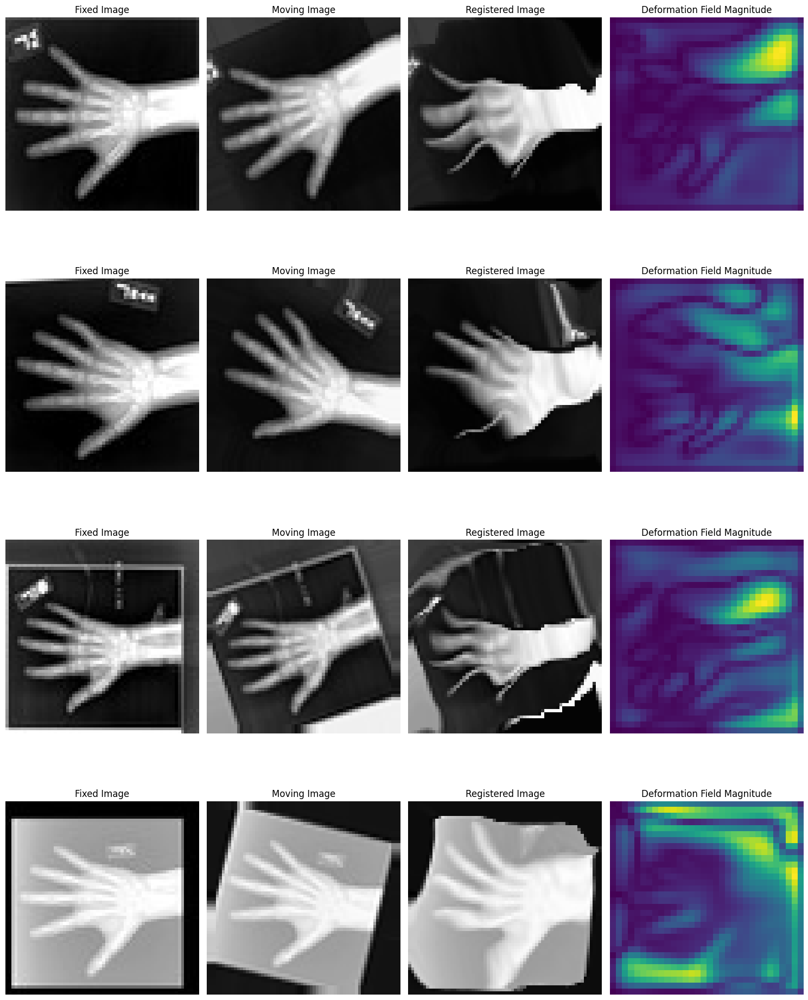

Epoch 58/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.72it/s, val_loss=metatensor(0.0062, device='cuda:0')]


Epoch 58/400 - Duration: 0.45 mins - Train Loss: 0.193, Train DICE: 0.592, Val Loss: 0.013, Val DICE: 0.603


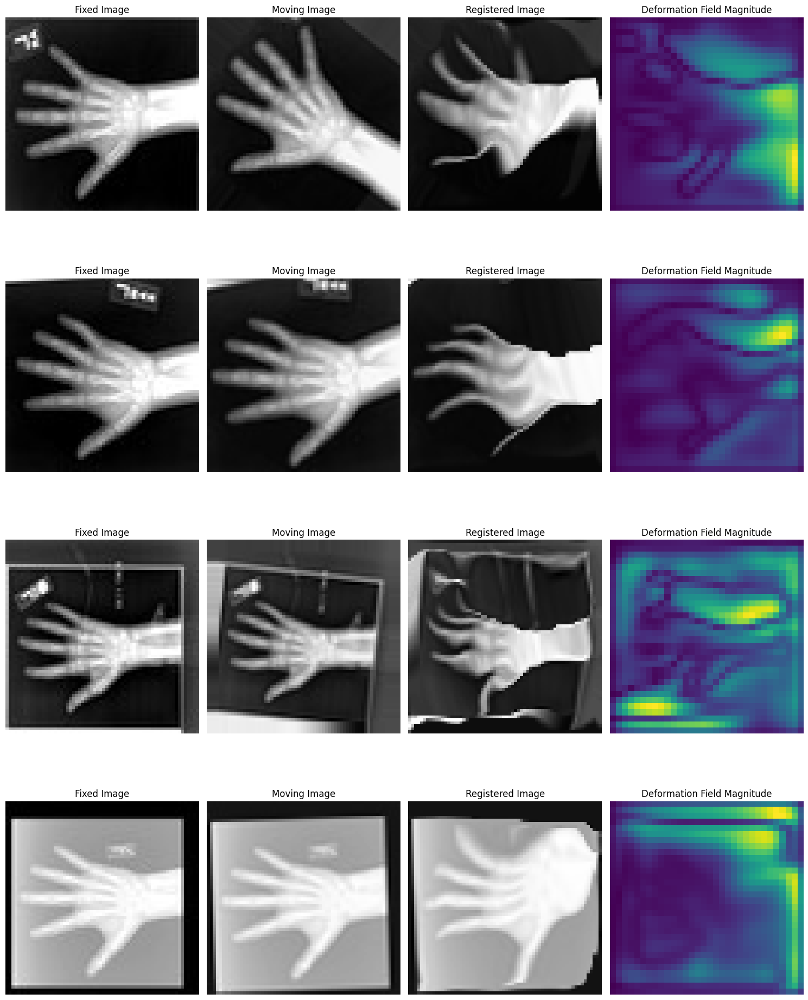

Epoch 59/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.60it/s, val_loss=metatensor(0.0065, device='cuda:0')]


Epoch 59/400 - Duration: 0.46 mins - Train Loss: 0.193, Train DICE: 0.592, Val Loss: 0.014, Val DICE: 0.604


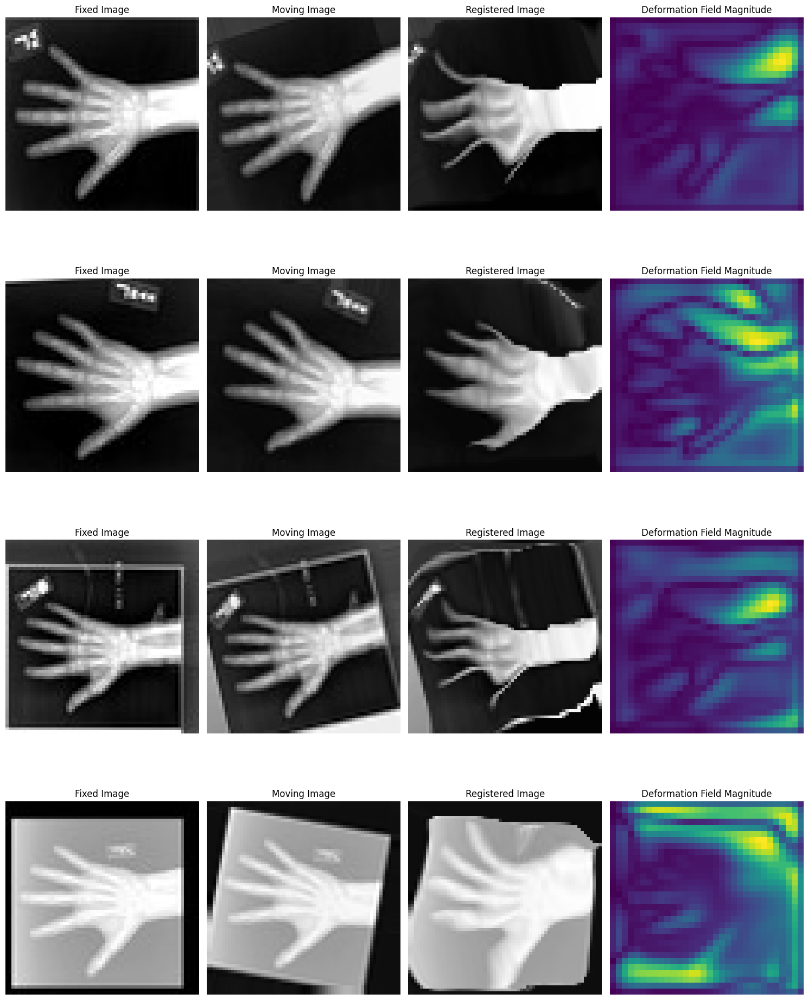

Epoch 60/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.73it/s, val_loss=metatensor(0.0061, device='cuda:0')]


Epoch 60/400 - Duration: 0.45 mins - Train Loss: 0.191, Train DICE: 0.592, Val Loss: 0.013, Val DICE: 0.605


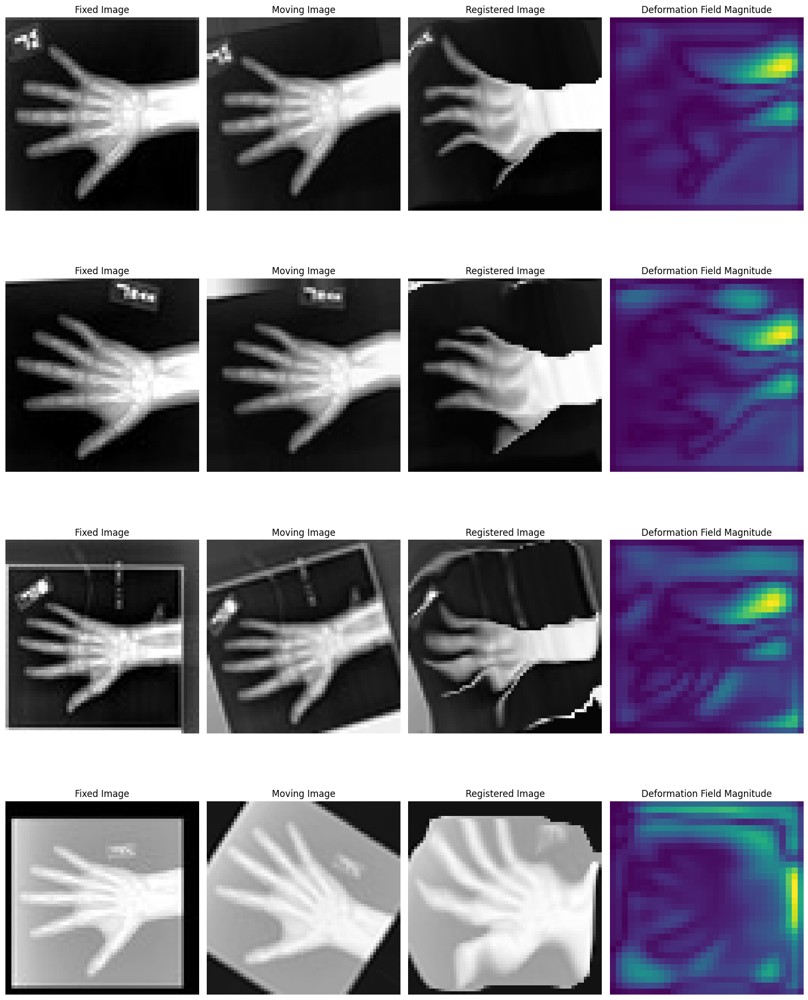

Epoch 61/400 - Validation: 100%|██████████| 32/32 [00:09<00:00,  3.50it/s, val_loss=metatensor(0.0075, device='cuda:0')]


Epoch 61/400 - Duration: 0.46 mins - Train Loss: 0.192, Train DICE: 0.593, Val Loss: 0.016, Val DICE: 0.602


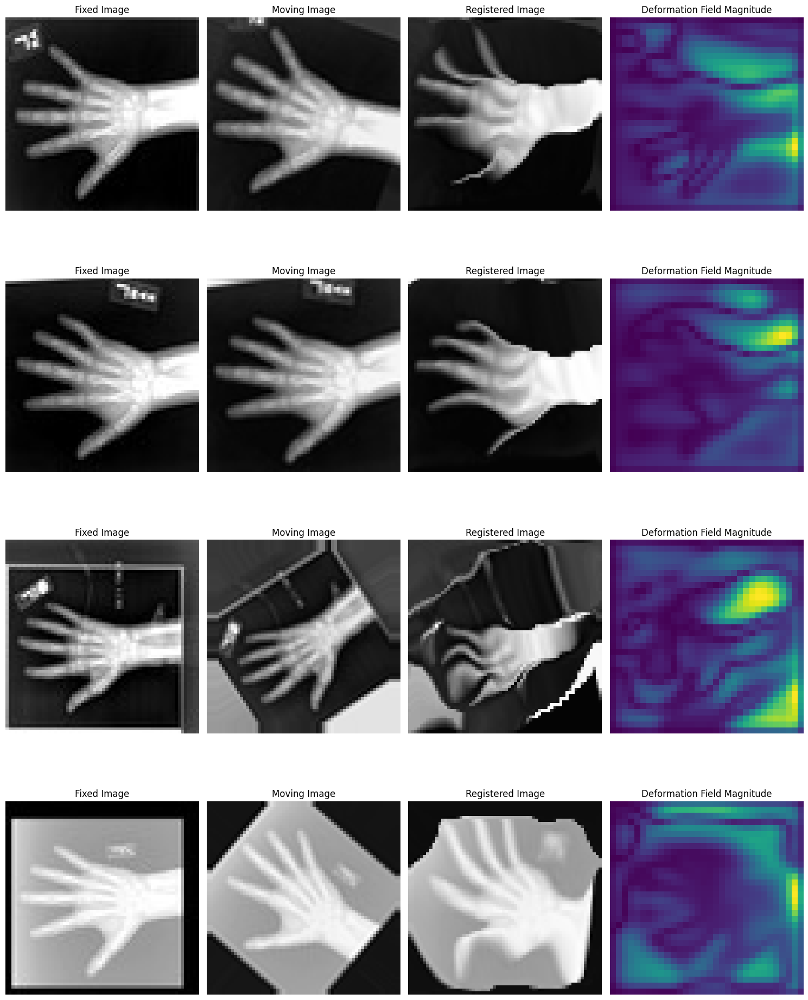

Epoch 62/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.68it/s, val_loss=metatensor(0.0060, device='cuda:0')]


Epoch 62/400 - Duration: 0.45 mins - Train Loss: 0.189, Train DICE: 0.594, Val Loss: 0.013, Val DICE: 0.604


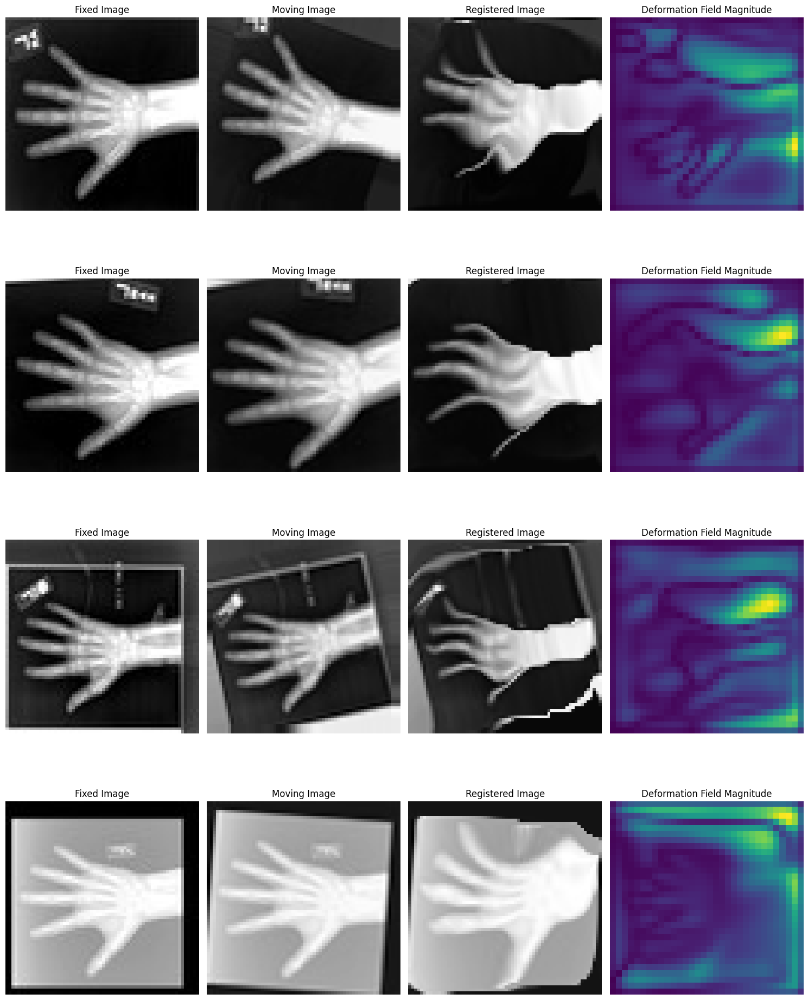

Epoch 63/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.81it/s, val_loss=metatensor(0.0073, device='cuda:0')]


Epoch 63/400 - Duration: 0.45 mins - Train Loss: 0.189, Train DICE: 0.593, Val Loss: 0.016, Val DICE: 0.603


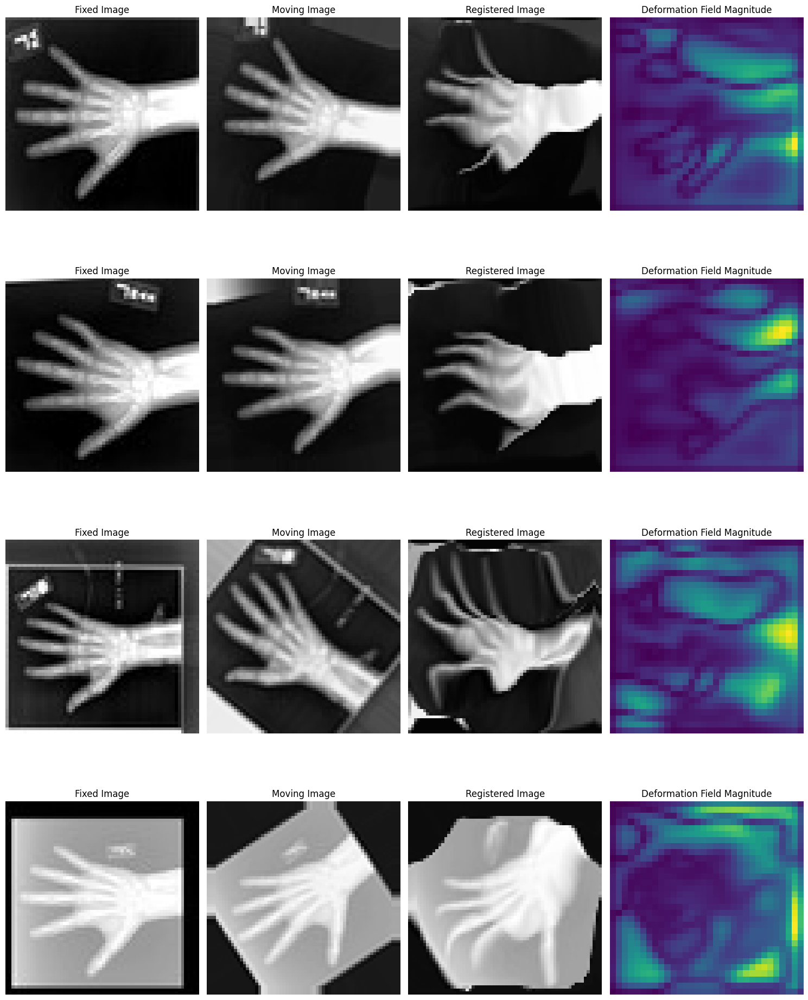

Epoch 64/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.84it/s, val_loss=metatensor(0.0074, device='cuda:0')]


Epoch 64/400 - Duration: 0.47 mins - Train Loss: 0.190, Train DICE: 0.592, Val Loss: 0.016, Val DICE: 0.606


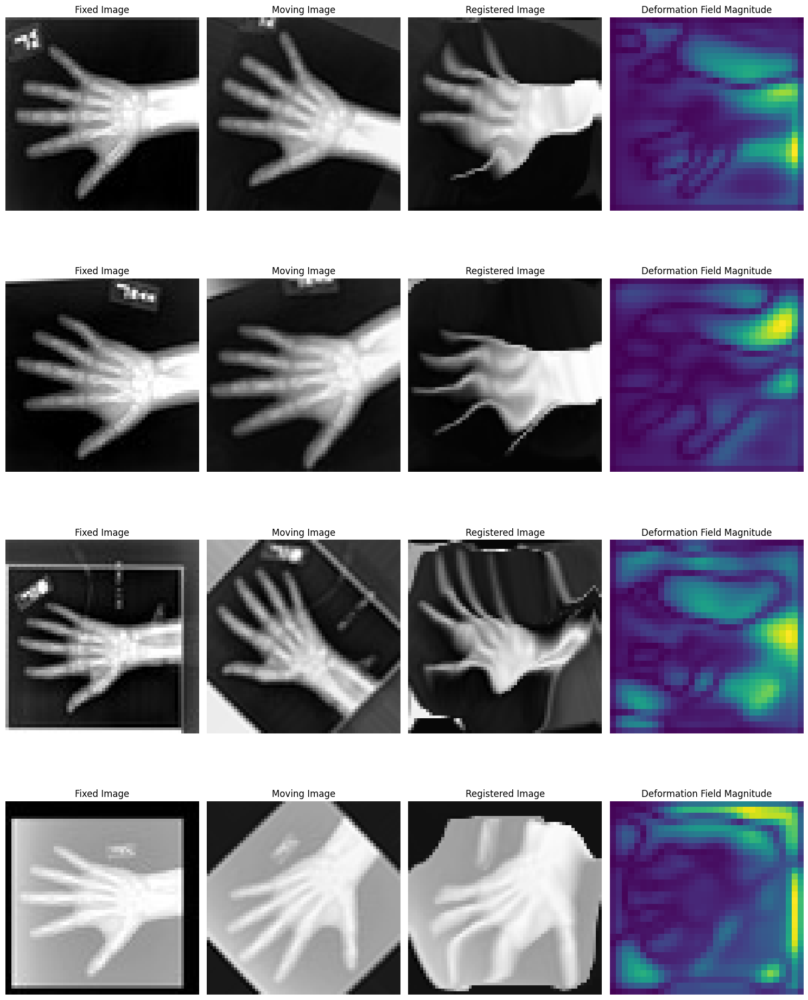

Epoch 65/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.77it/s, val_loss=metatensor(0.0080, device='cuda:0')]


Epoch 65/400 - Duration: 0.46 mins - Train Loss: 0.190, Train DICE: 0.593, Val Loss: 0.017, Val DICE: 0.604


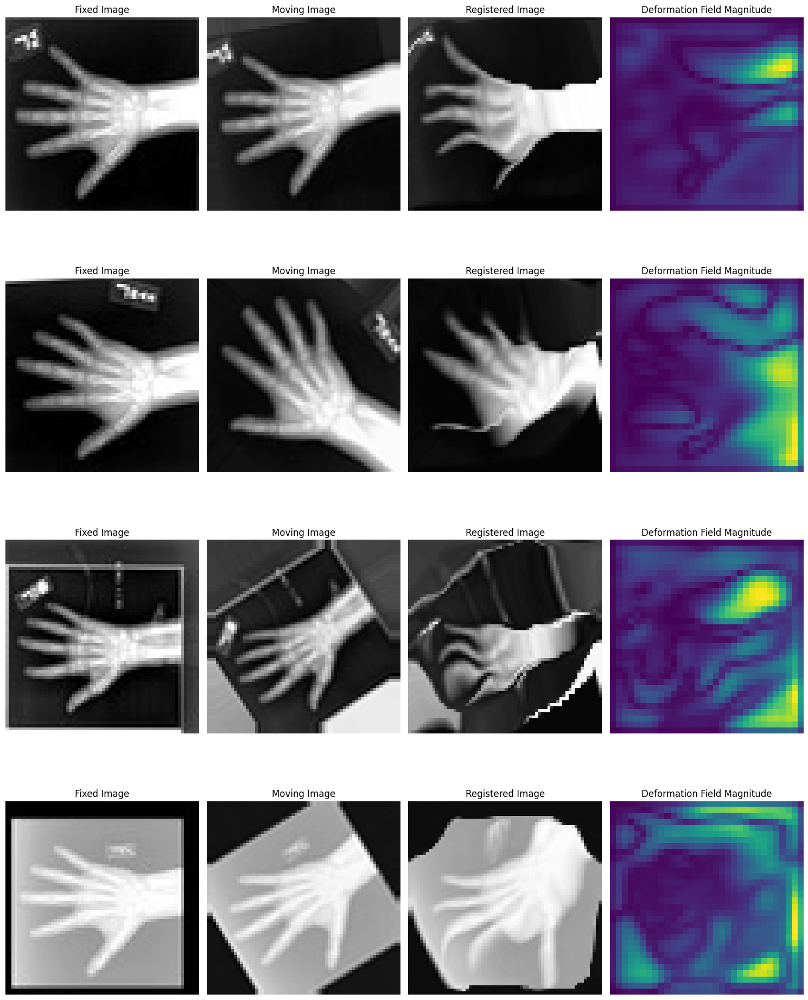

Epoch 66/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.69it/s, val_loss=metatensor(0.0060, device='cuda:0')]


Epoch 66/400 - Duration: 0.45 mins - Train Loss: 0.187, Train DICE: 0.594, Val Loss: 0.013, Val DICE: 0.603


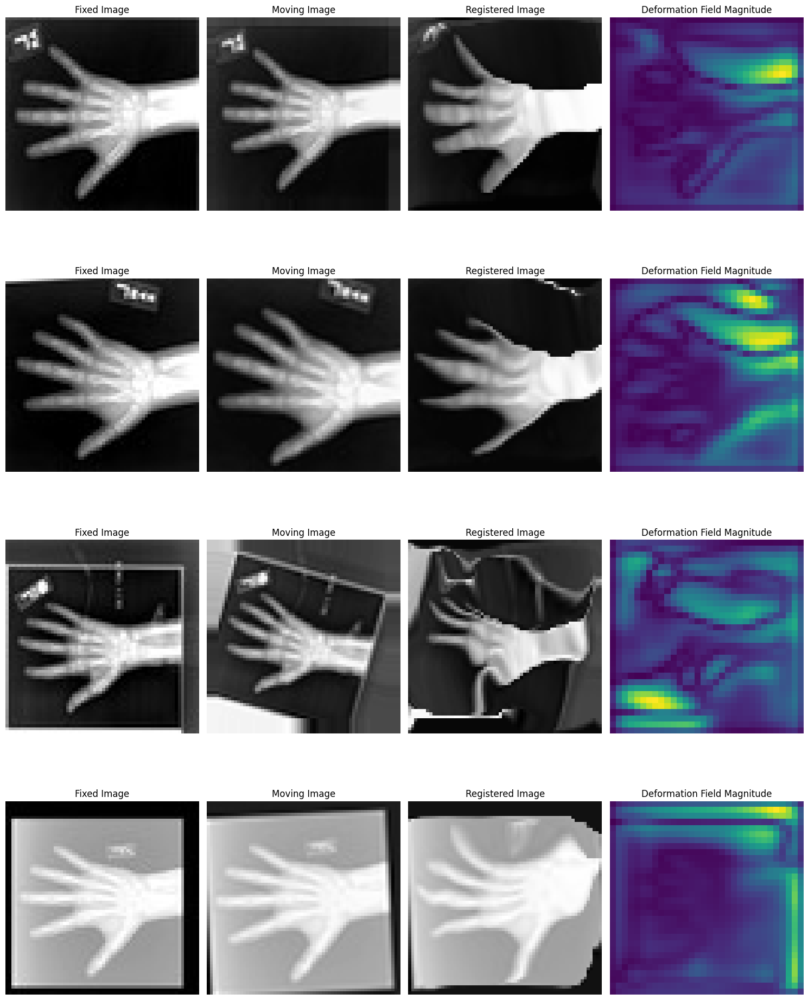

Epoch 67/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.67it/s, val_loss=metatensor(0.0062, device='cuda:0')]


Epoch 67/400 - Duration: 0.44 mins - Train Loss: 0.185, Train DICE: 0.594, Val Loss: 0.013, Val DICE: 0.607


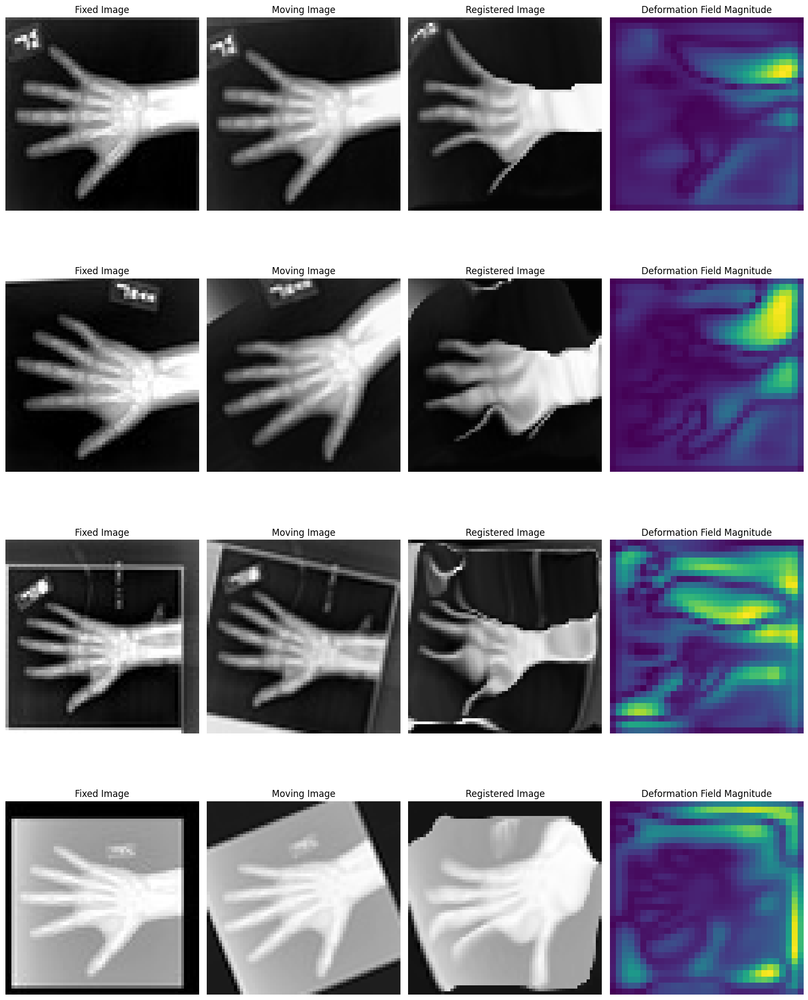

Epoch 68/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.70it/s, val_loss=metatensor(0.0057, device='cuda:0')]


Epoch 68/400 - Duration: 0.44 mins - Train Loss: 0.185, Train DICE: 0.594, Val Loss: 0.012, Val DICE: 0.606


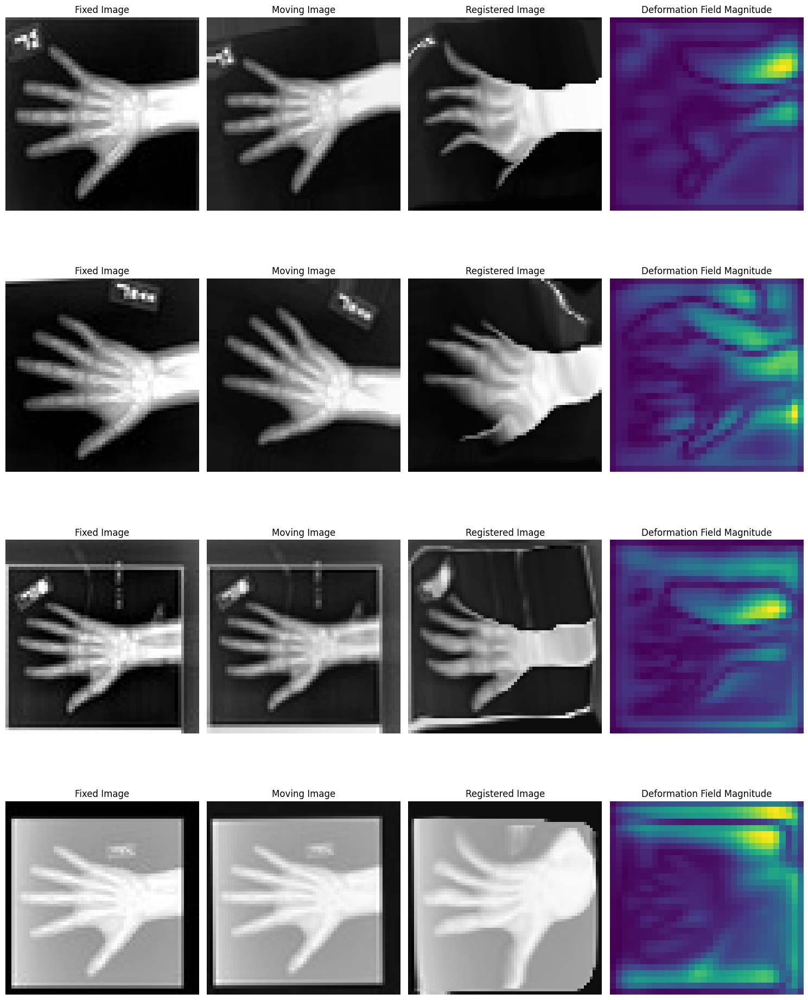

Epoch 69/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.61it/s, val_loss=metatensor(0.0056, device='cuda:0')]


Epoch 69/400 - Duration: 0.46 mins - Train Loss: 0.184, Train DICE: 0.595, Val Loss: 0.012, Val DICE: 0.607


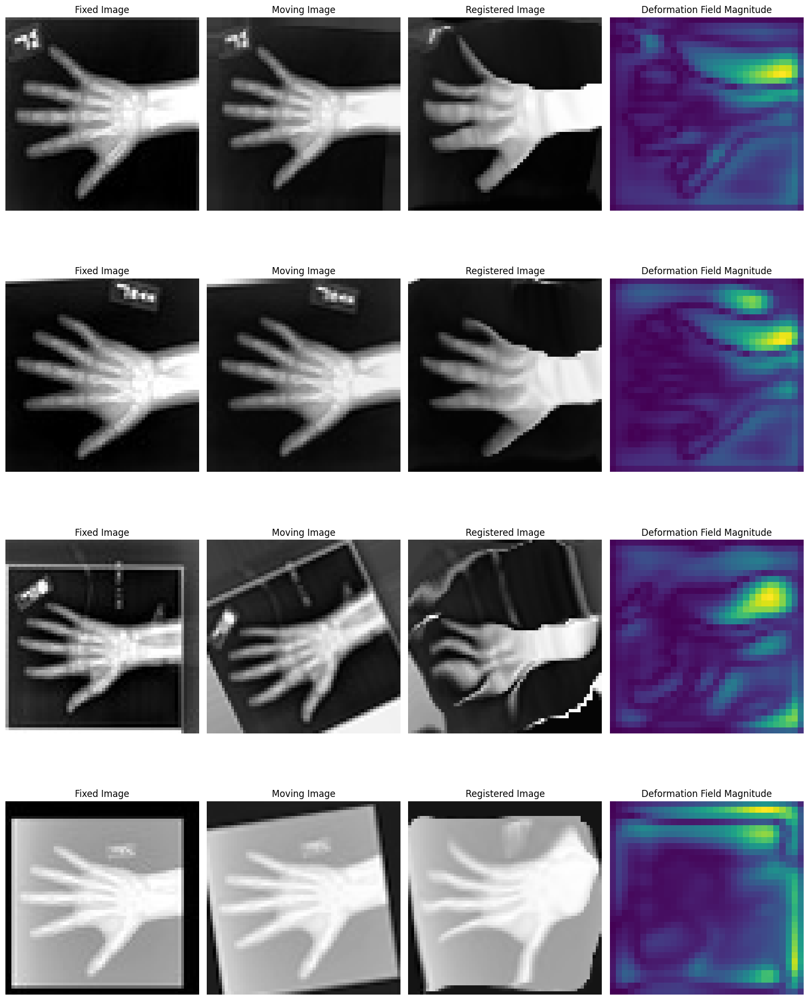

Epoch 70/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.63it/s, val_loss=metatensor(0.0065, device='cuda:0')]


Epoch 70/400 - Duration: 0.45 mins - Train Loss: 0.182, Train DICE: 0.596, Val Loss: 0.014, Val DICE: 0.606


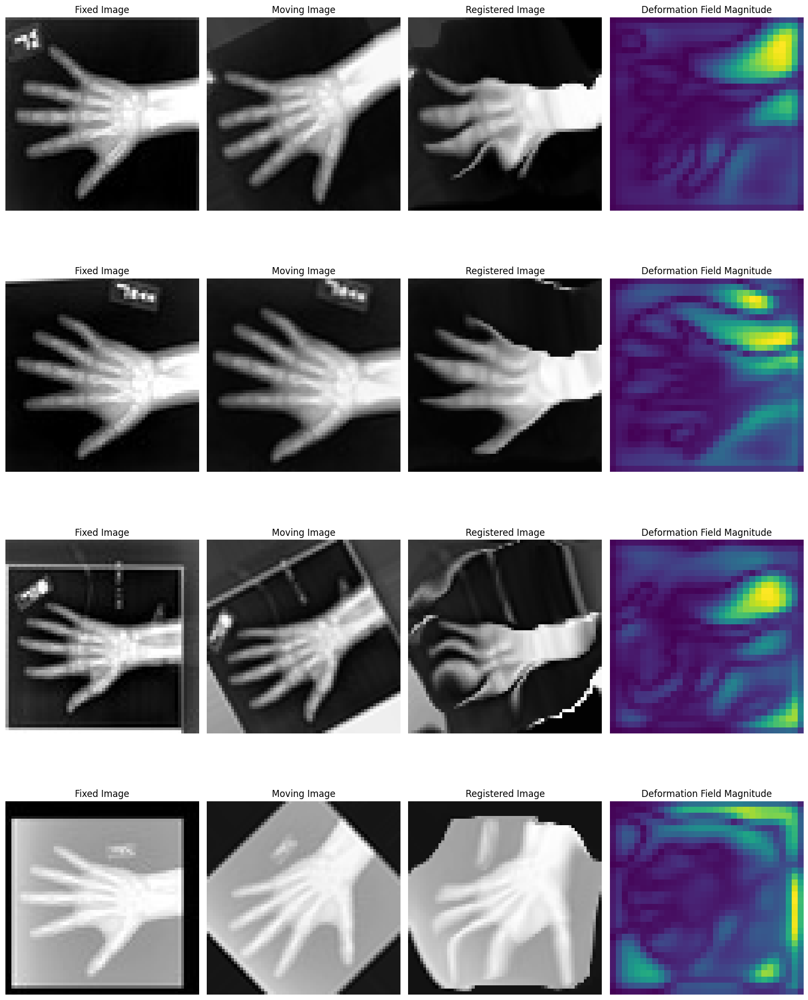

Epoch 71/400 - Validation: 100%|██████████| 32/32 [00:09<00:00,  3.50it/s, val_loss=metatensor(0.0071, device='cuda:0')]


Epoch 71/400 - Duration: 0.46 mins - Train Loss: 0.184, Train DICE: 0.595, Val Loss: 0.015, Val DICE: 0.607


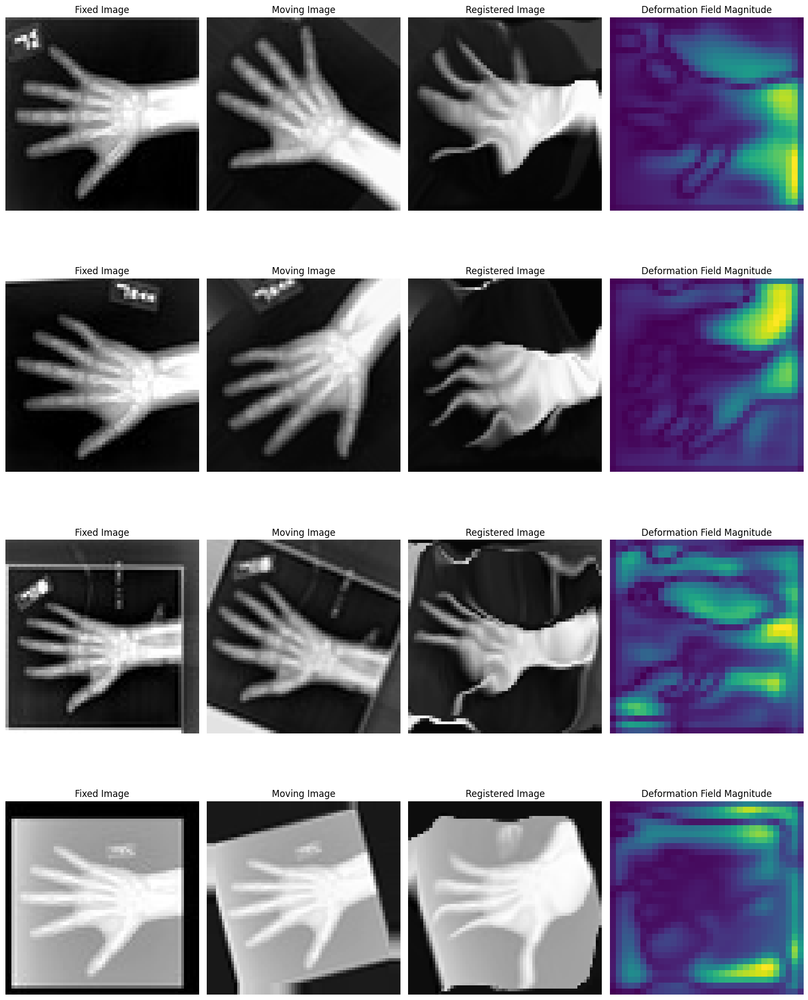

Epoch 72/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.71it/s, val_loss=metatensor(0.0067, device='cuda:0')]


Epoch 72/400 - Duration: 0.44 mins - Train Loss: 0.183, Train DICE: 0.594, Val Loss: 0.014, Val DICE: 0.606


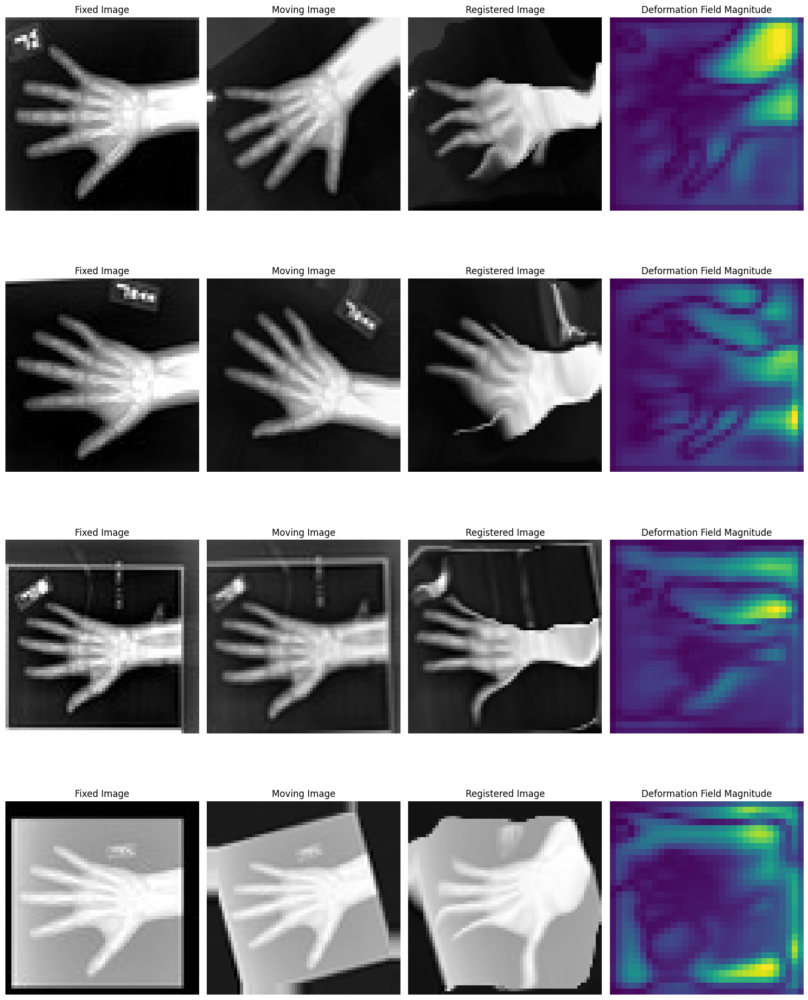

Epoch 73/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.64it/s, val_loss=metatensor(0.0065, device='cuda:0')]


Epoch 73/400 - Duration: 0.46 mins - Train Loss: 0.182, Train DICE: 0.596, Val Loss: 0.014, Val DICE: 0.606


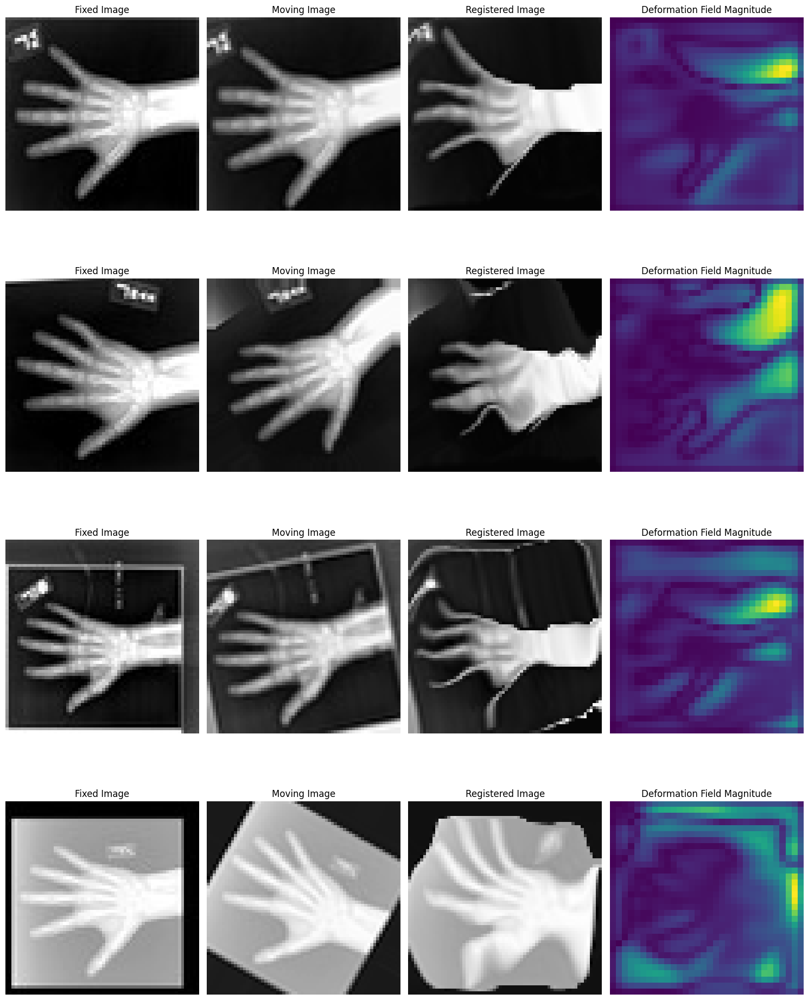

Epoch 74/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.73it/s, val_loss=metatensor(0.0068, device='cuda:0')]


Epoch 74/400 - Duration: 0.45 mins - Train Loss: 0.180, Train DICE: 0.596, Val Loss: 0.015, Val DICE: 0.606


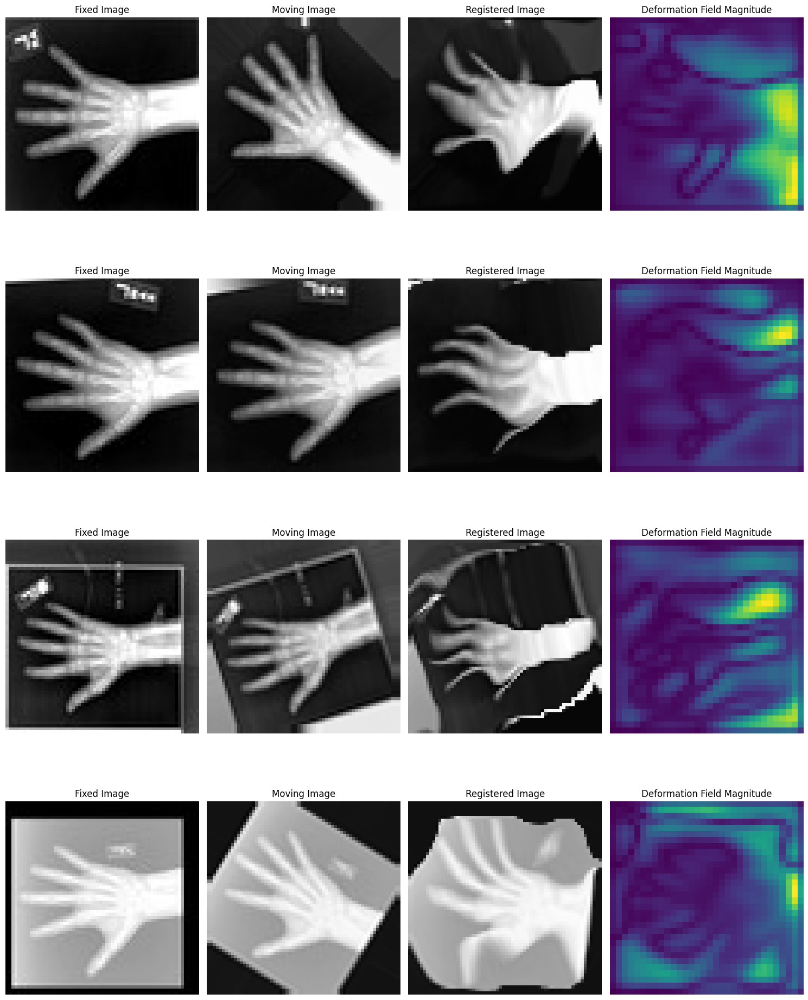

Epoch 75/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.60it/s, val_loss=metatensor(0.0063, device='cuda:0')]


Epoch 75/400 - Duration: 0.45 mins - Train Loss: 0.182, Train DICE: 0.596, Val Loss: 0.014, Val DICE: 0.606


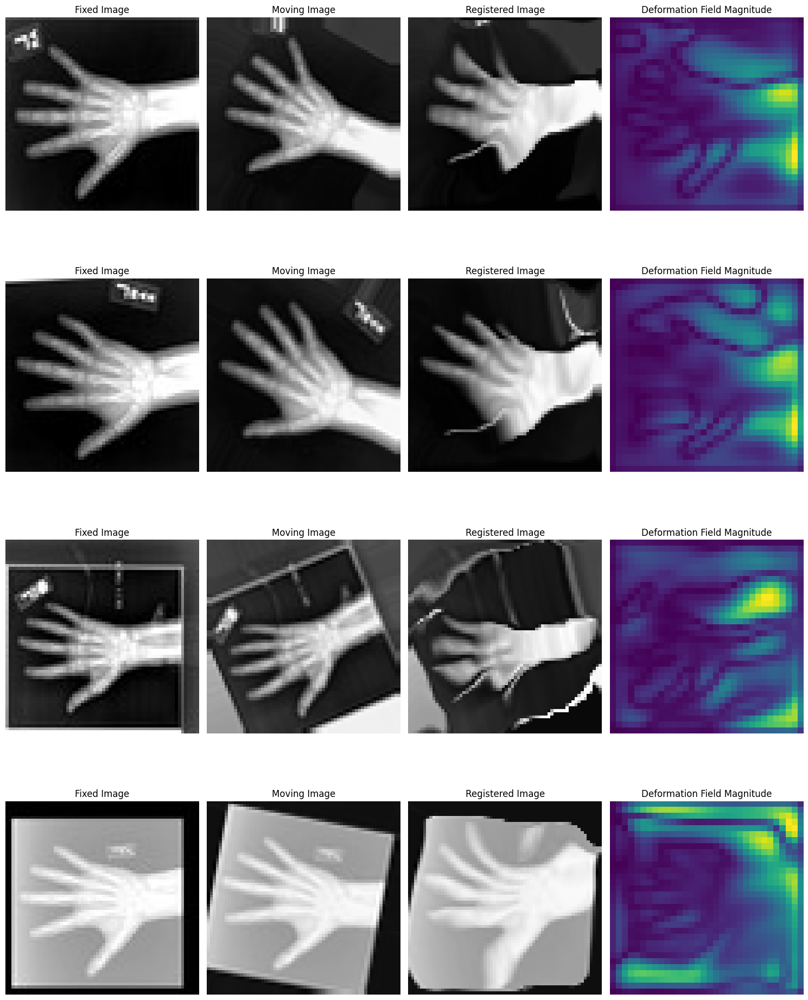

Epoch 76/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.62it/s, val_loss=metatensor(0.0066, device='cuda:0')]


Epoch 76/400 - Duration: 0.45 mins - Train Loss: 0.183, Train DICE: 0.596, Val Loss: 0.014, Val DICE: 0.607


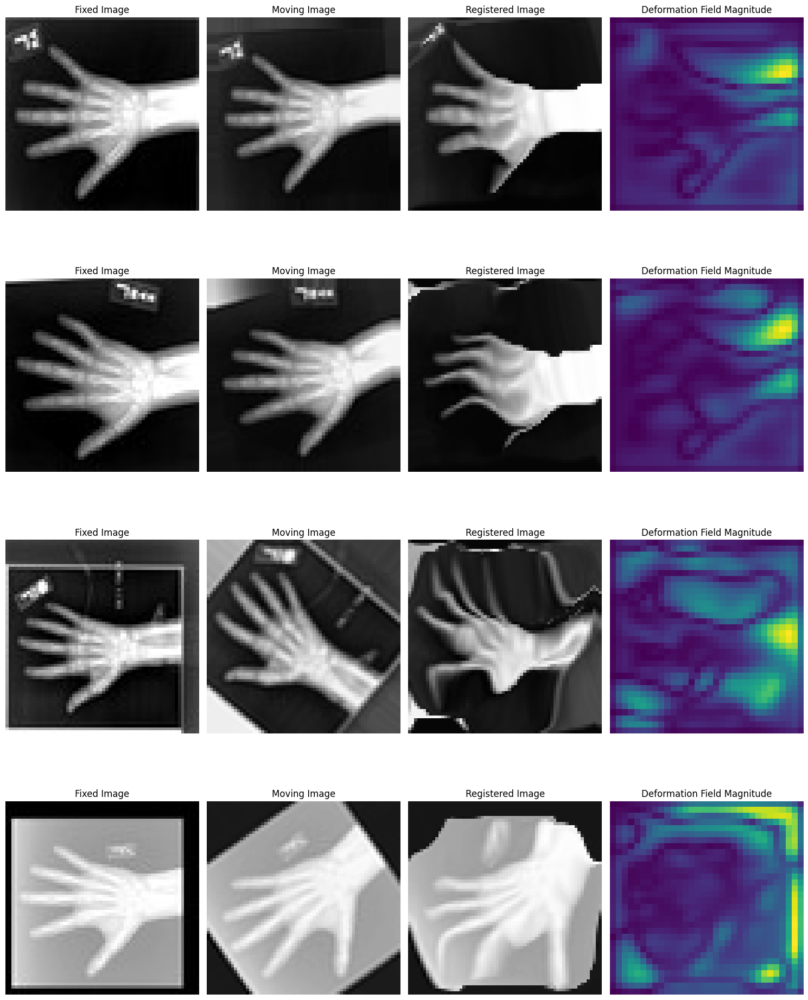

Epoch 77/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.72it/s, val_loss=metatensor(0.0057, device='cuda:0')]


Epoch 77/400 - Duration: 0.45 mins - Train Loss: 0.182, Train DICE: 0.596, Val Loss: 0.012, Val DICE: 0.606


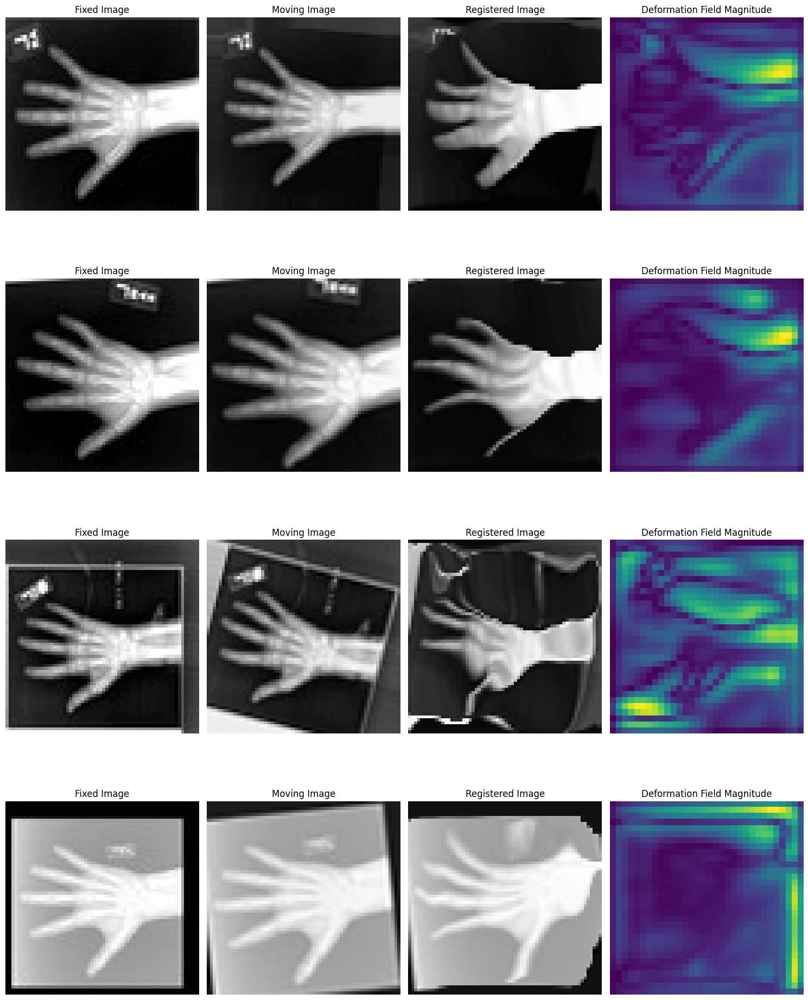

Epoch 78/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.68it/s, val_loss=metatensor(0.0065, device='cuda:0')]


Epoch 78/400 - Duration: 0.46 mins - Train Loss: 0.183, Train DICE: 0.595, Val Loss: 0.014, Val DICE: 0.607


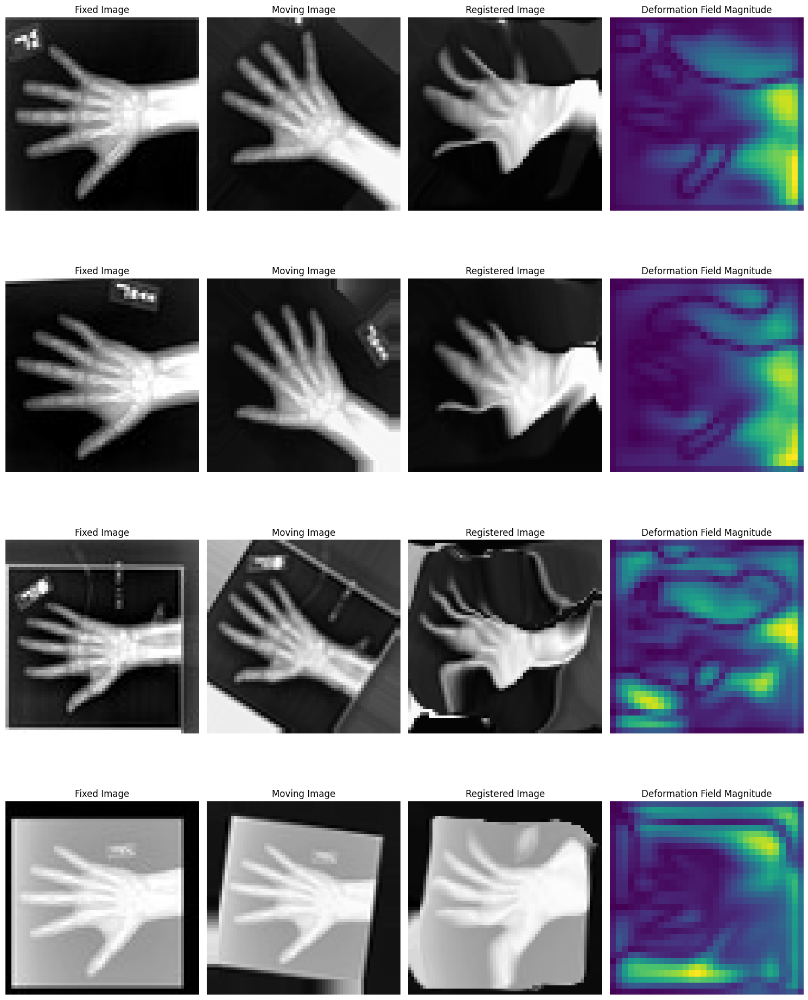

Epoch 79/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.61it/s, val_loss=metatensor(0.0072, device='cuda:0')]


Epoch 79/400 - Duration: 0.46 mins - Train Loss: 0.180, Train DICE: 0.595, Val Loss: 0.016, Val DICE: 0.606


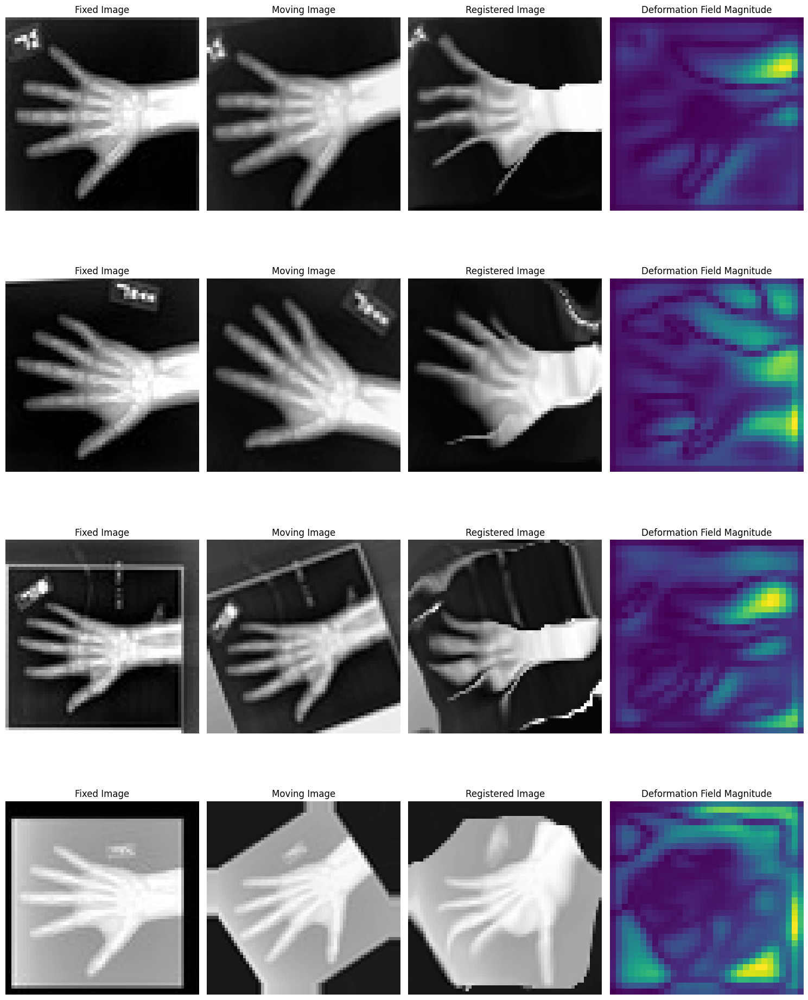

Epoch 80/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.74it/s, val_loss=metatensor(0.0068, device='cuda:0')]


Epoch 80/400 - Duration: 0.44 mins - Train Loss: 0.179, Train DICE: 0.597, Val Loss: 0.015, Val DICE: 0.607


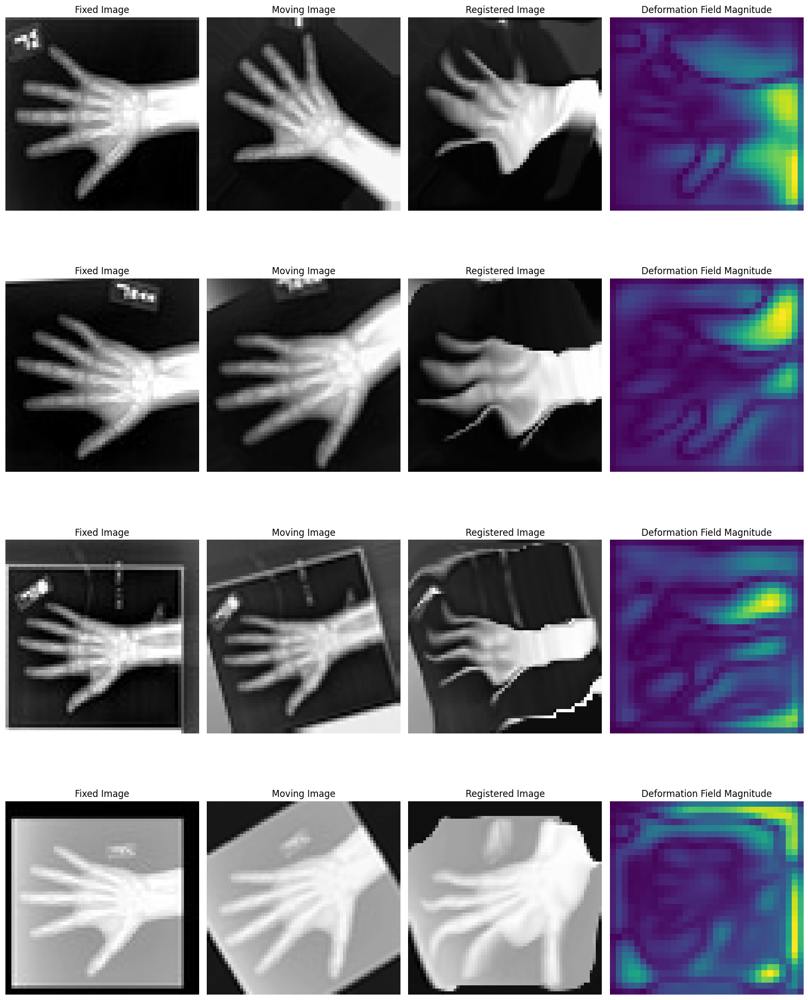

Epoch 81/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.64it/s, val_loss=metatensor(0.0072, device='cuda:0')]


Epoch 81/400 - Duration: 0.45 mins - Train Loss: 0.180, Train DICE: 0.596, Val Loss: 0.015, Val DICE: 0.608


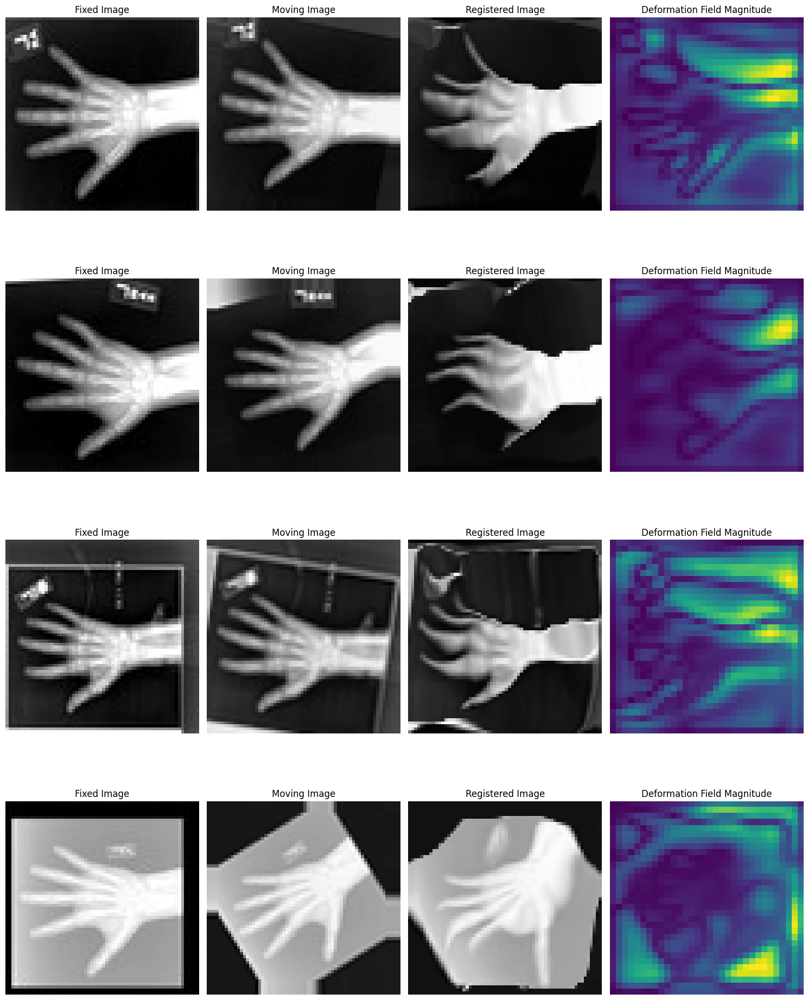

Epoch 82/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.85it/s, val_loss=metatensor(0.0073, device='cuda:0')]


Epoch 82/400 - Duration: 0.43 mins - Train Loss: 0.177, Train DICE: 0.597, Val Loss: 0.016, Val DICE: 0.607


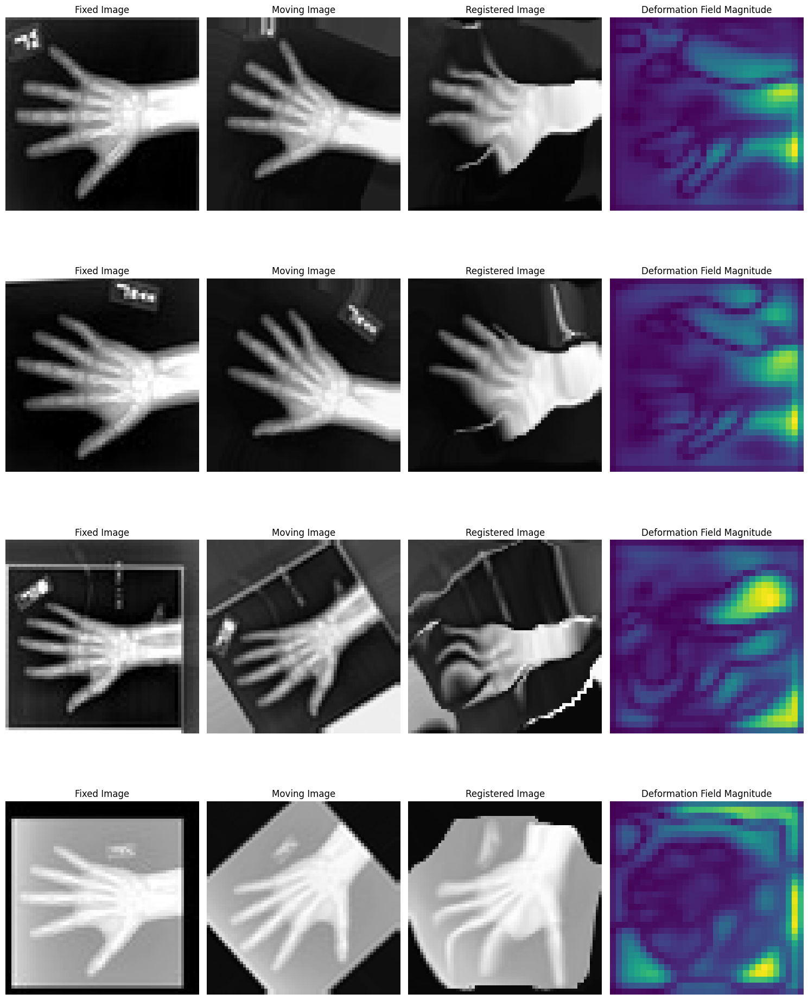

Epoch 83/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.63it/s, val_loss=metatensor(0.0064, device='cuda:0')]


Epoch 83/400 - Duration: 0.49 mins - Train Loss: 0.180, Train DICE: 0.596, Val Loss: 0.014, Val DICE: 0.608


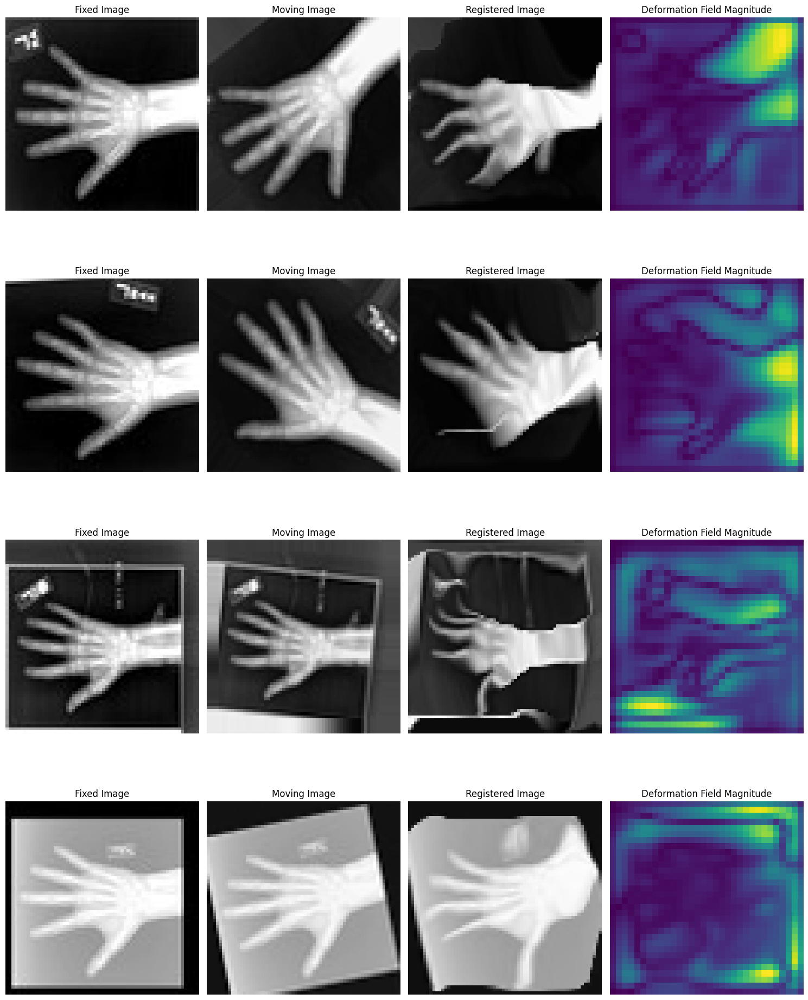

Epoch 84/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.81it/s, val_loss=metatensor(0.0064, device='cuda:0')]


Epoch 84/400 - Duration: 0.45 mins - Train Loss: 0.180, Train DICE: 0.597, Val Loss: 0.014, Val DICE: 0.608


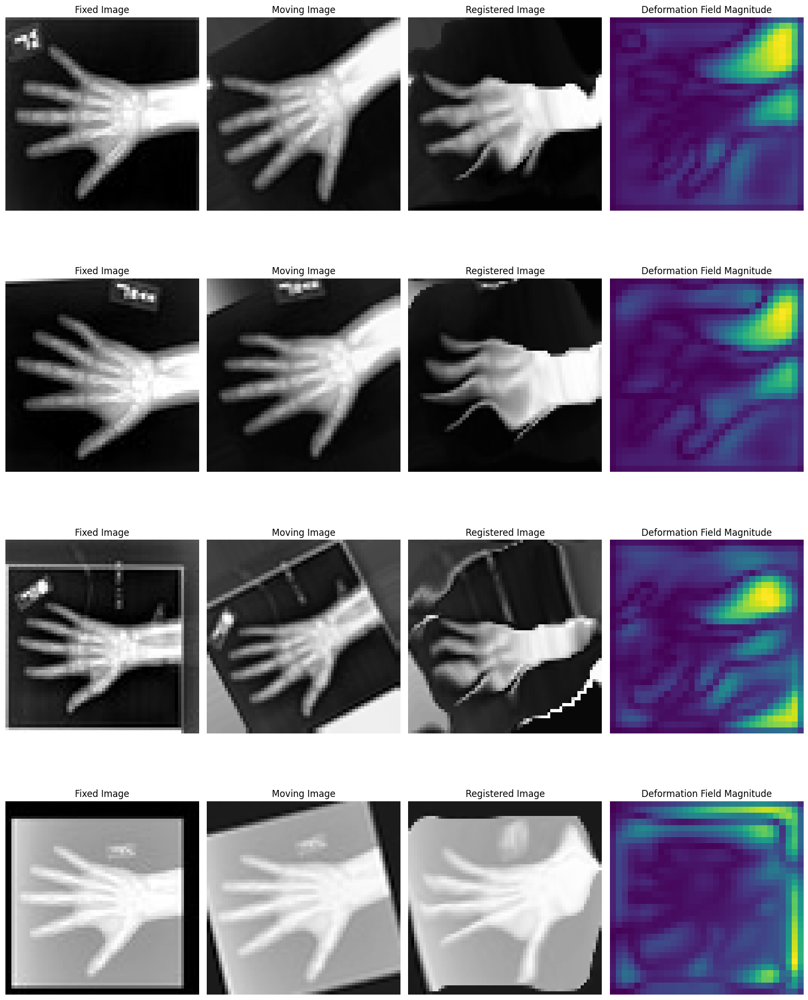

Epoch 85/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.63it/s, val_loss=metatensor(0.0068, device='cuda:0')]


Epoch 85/400 - Duration: 0.45 mins - Train Loss: 0.179, Train DICE: 0.596, Val Loss: 0.015, Val DICE: 0.607


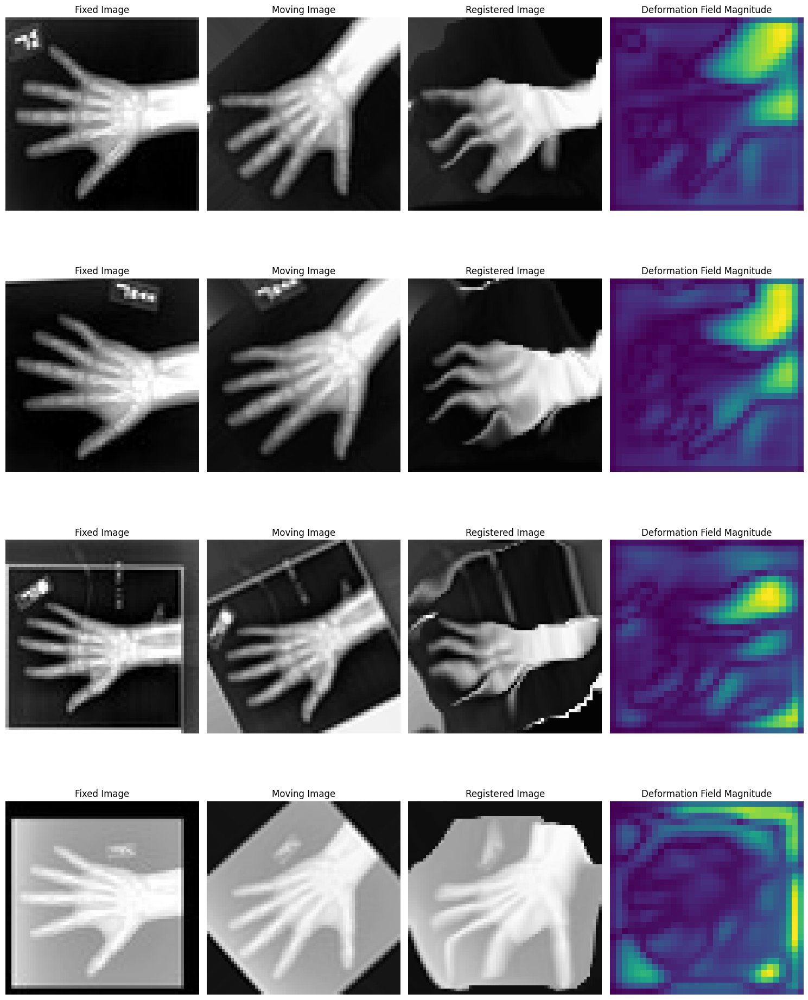

Epoch 86/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.69it/s, val_loss=metatensor(0.0059, device='cuda:0')]


Epoch 86/400 - Duration: 0.45 mins - Train Loss: 0.177, Train DICE: 0.598, Val Loss: 0.013, Val DICE: 0.606


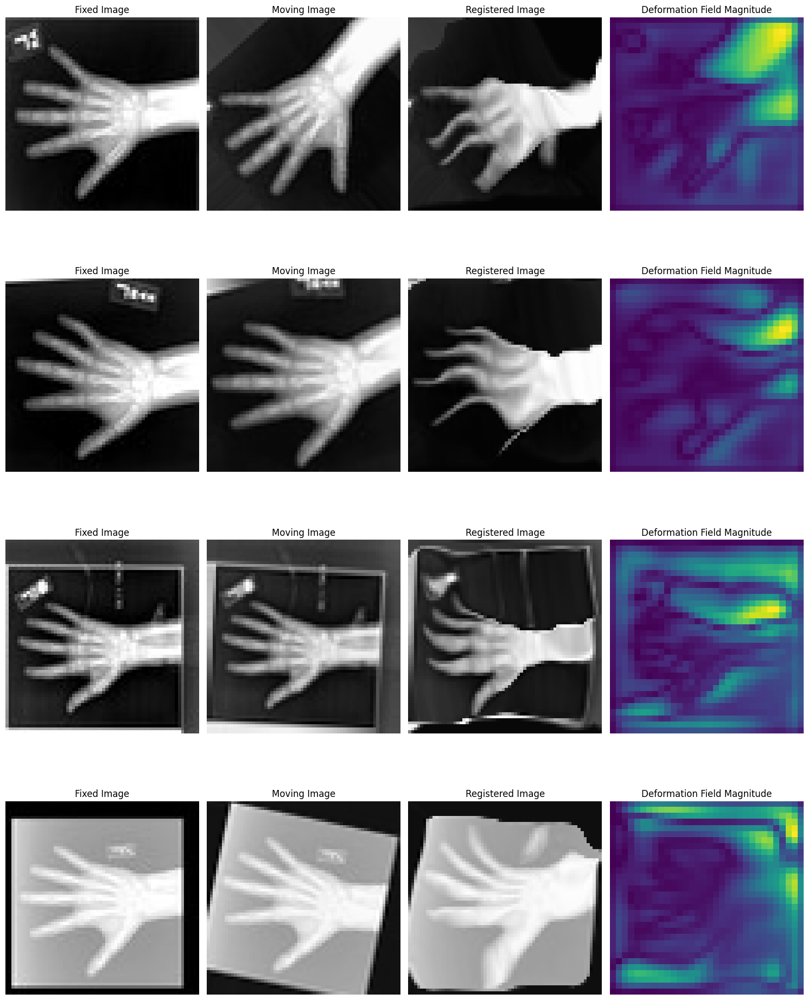

Epoch 87/400 - Validation: 100%|██████████| 32/32 [00:09<00:00,  3.55it/s, val_loss=metatensor(0.0057, device='cuda:0')]


Epoch 87/400 - Duration: 0.45 mins - Train Loss: 0.177, Train DICE: 0.598, Val Loss: 0.012, Val DICE: 0.609


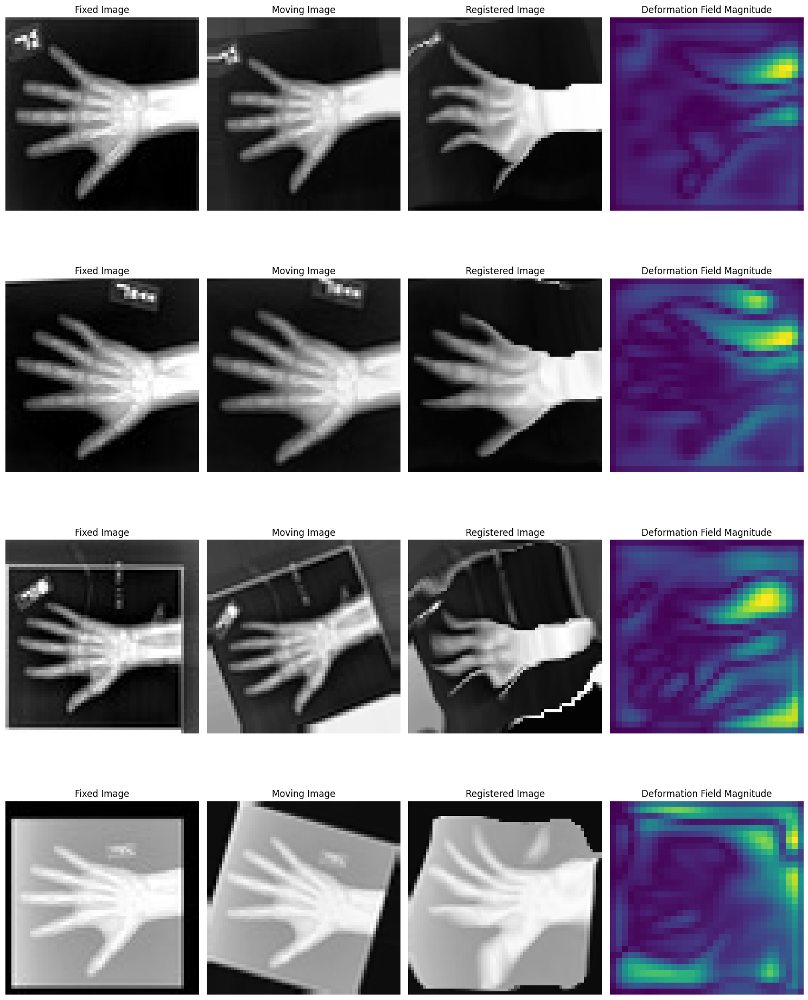

Epoch 88/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.68it/s, val_loss=metatensor(0.0068, device='cuda:0')]


Epoch 88/400 - Duration: 0.45 mins - Train Loss: 0.175, Train DICE: 0.598, Val Loss: 0.015, Val DICE: 0.609


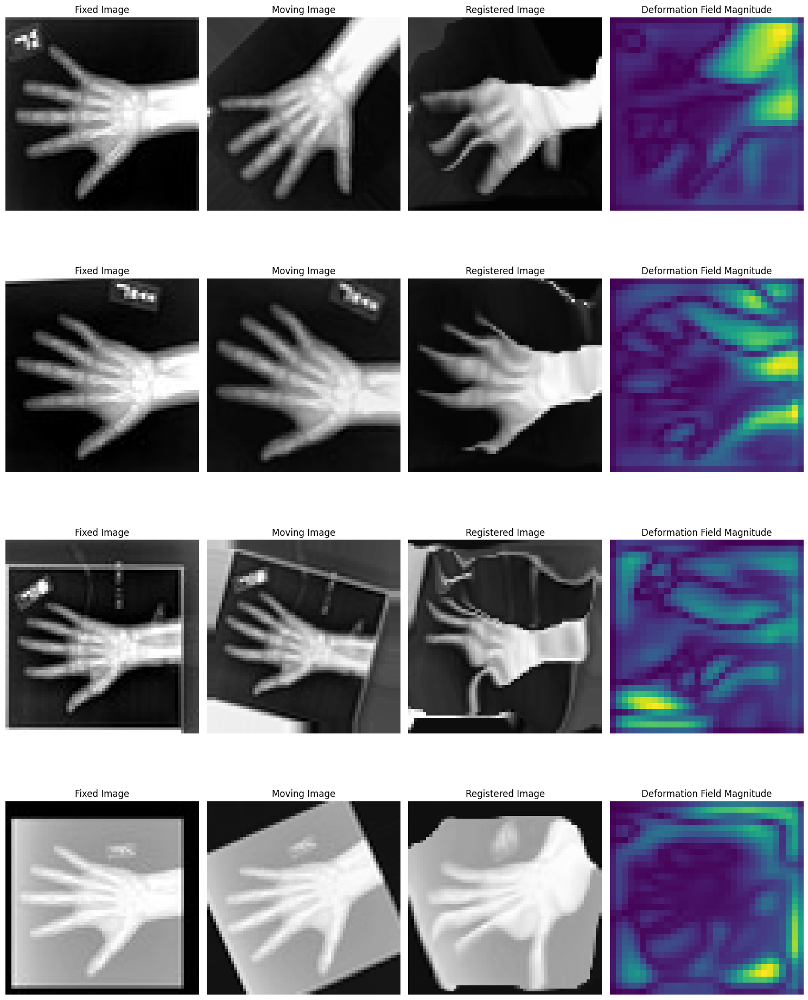

Epoch 89/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.83it/s, val_loss=metatensor(0.0062, device='cuda:0')]


Epoch 89/400 - Duration: 0.44 mins - Train Loss: 0.175, Train DICE: 0.598, Val Loss: 0.013, Val DICE: 0.608


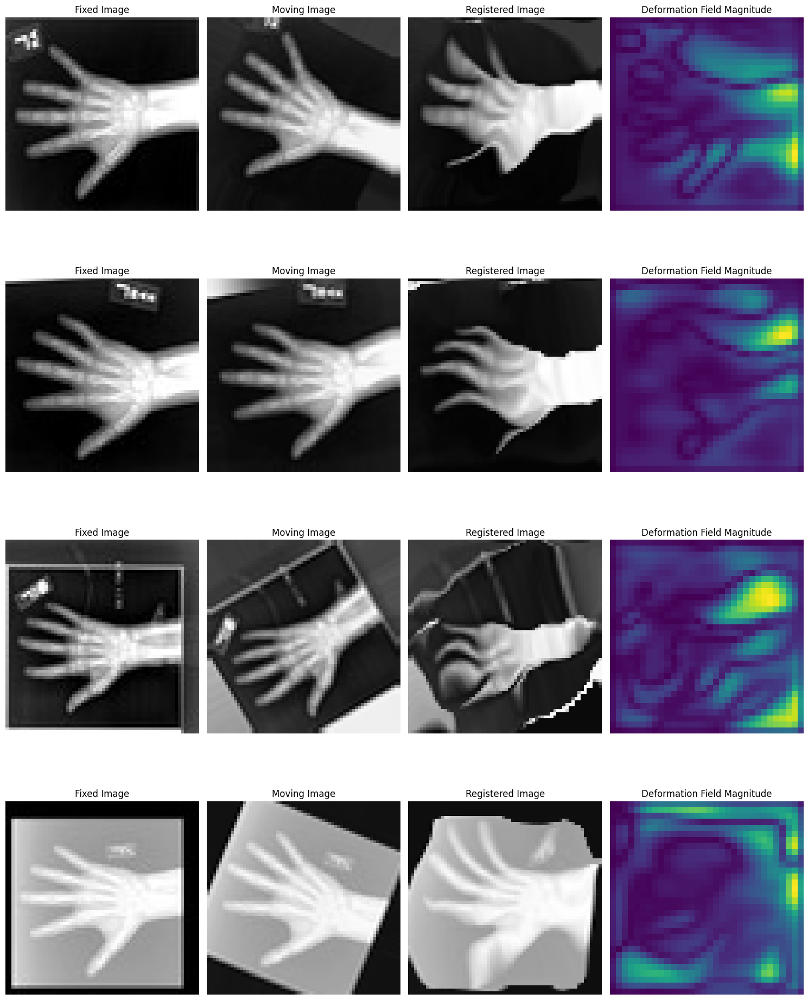

Epoch 90/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.71it/s, val_loss=metatensor(0.0066, device='cuda:0')]


Epoch 90/400 - Duration: 0.44 mins - Train Loss: 0.177, Train DICE: 0.598, Val Loss: 0.014, Val DICE: 0.609


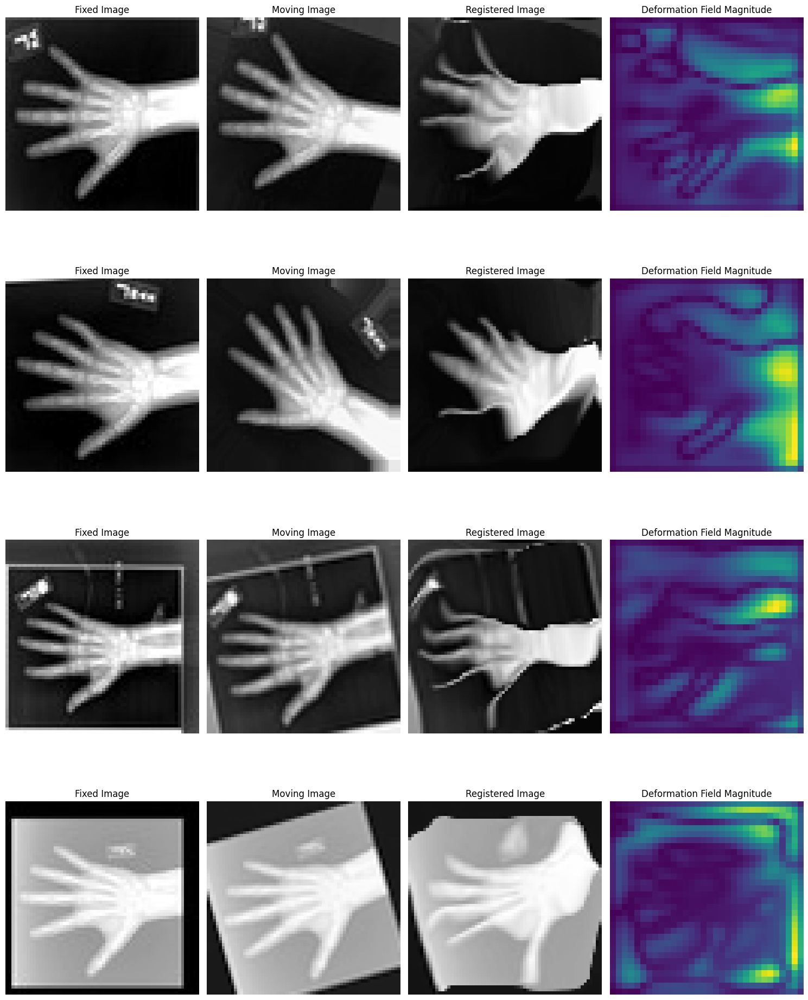

Epoch 91/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.65it/s, val_loss=metatensor(0.0073, device='cuda:0')]


Epoch 91/400 - Duration: 0.46 mins - Train Loss: 0.176, Train DICE: 0.598, Val Loss: 0.016, Val DICE: 0.608


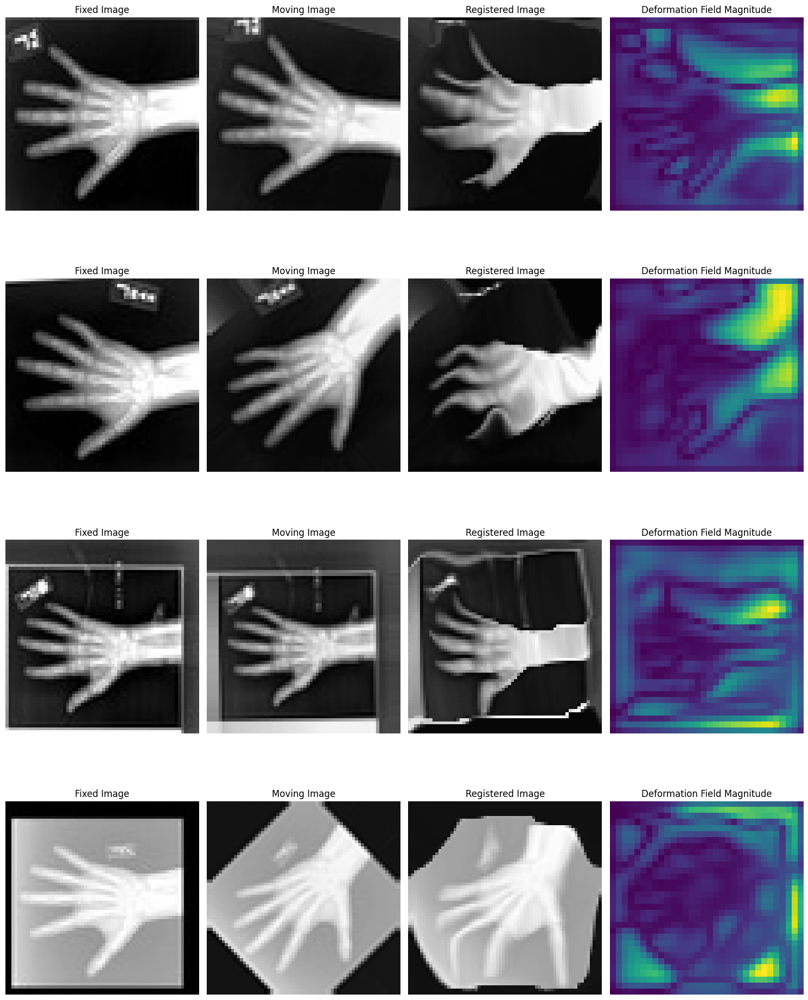

Epoch 92/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.82it/s, val_loss=metatensor(0.0063, device='cuda:0')]


Epoch 92/400 - Duration: 0.43 mins - Train Loss: 0.174, Train DICE: 0.598, Val Loss: 0.014, Val DICE: 0.609


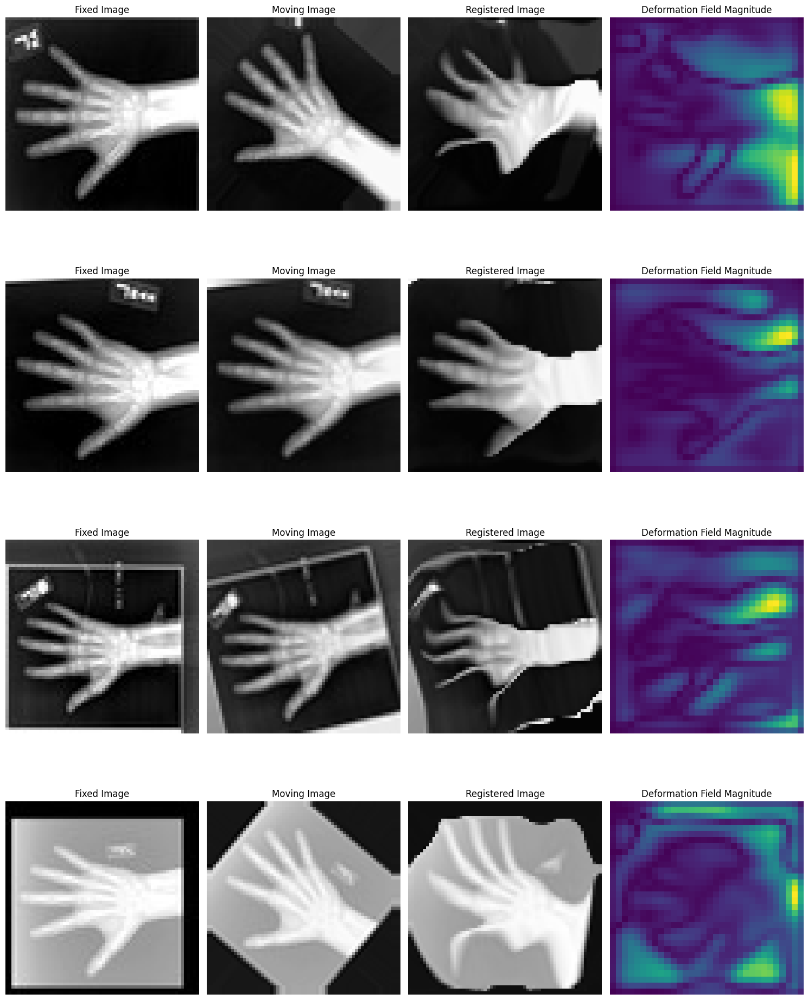

Epoch 93/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.63it/s, val_loss=metatensor(0.0066, device='cuda:0')]


Epoch 93/400 - Duration: 0.44 mins - Train Loss: 0.176, Train DICE: 0.599, Val Loss: 0.014, Val DICE: 0.608


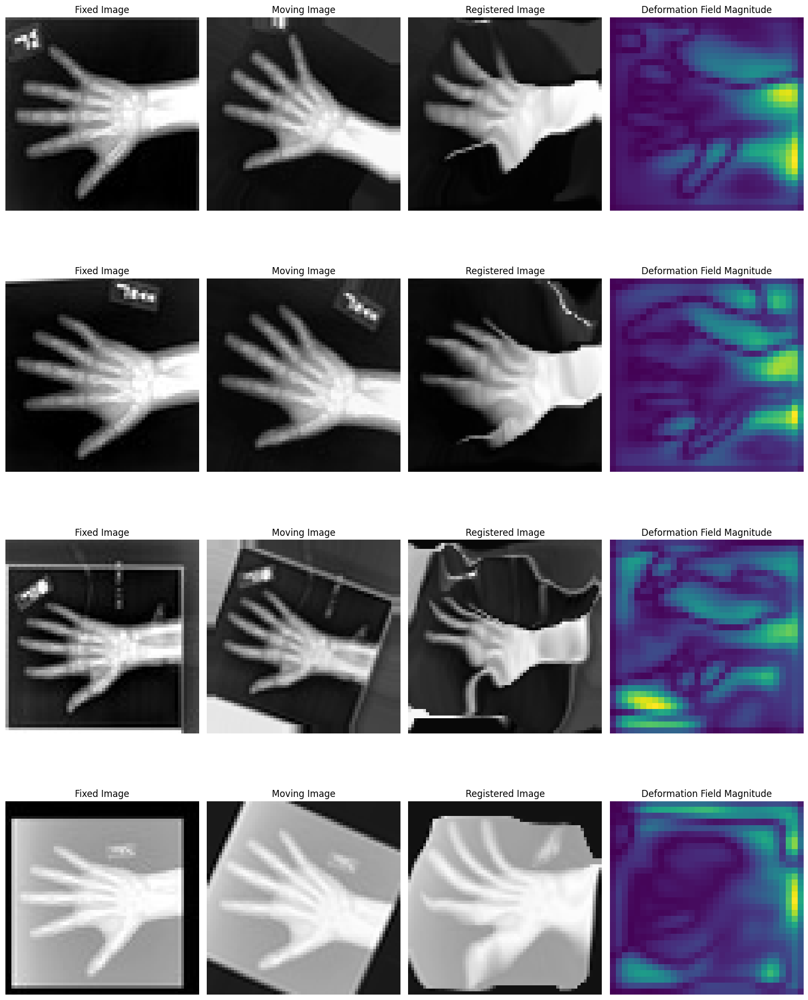

Epoch 94/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.67it/s, val_loss=metatensor(0.0069, device='cuda:0')]


Epoch 94/400 - Duration: 0.45 mins - Train Loss: 0.172, Train DICE: 0.599, Val Loss: 0.015, Val DICE: 0.608


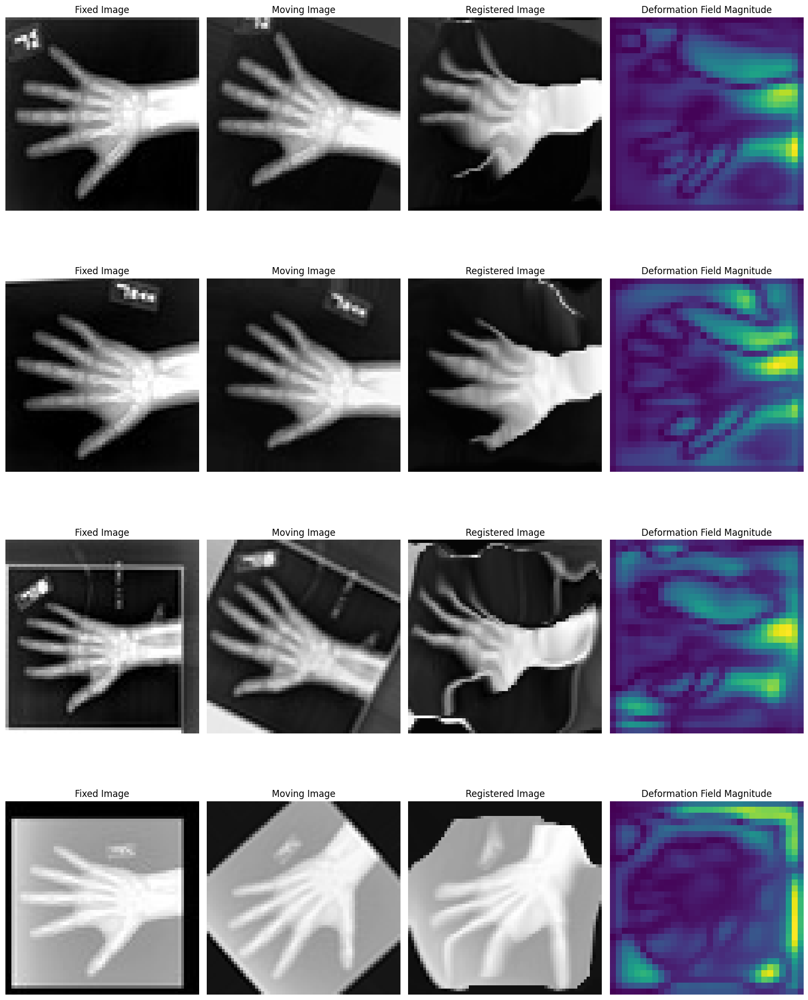

Epoch 95/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.63it/s, val_loss=metatensor(0.0061, device='cuda:0')]


Epoch 95/400 - Duration: 0.46 mins - Train Loss: 0.177, Train DICE: 0.598, Val Loss: 0.013, Val DICE: 0.611


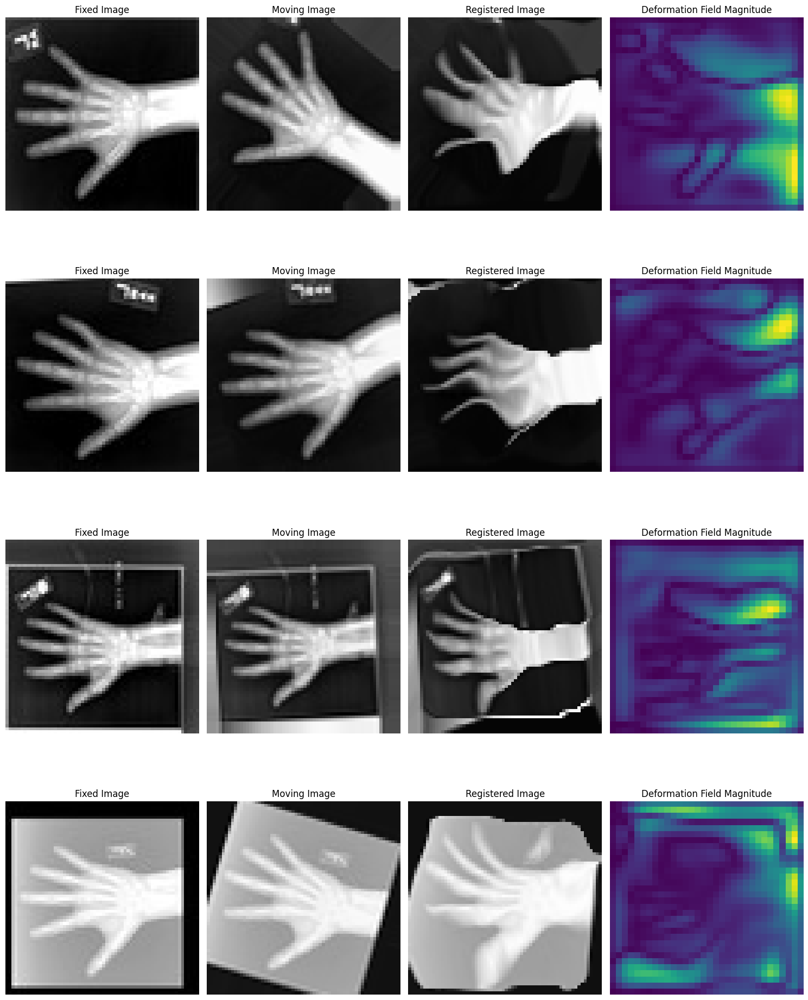

Epoch 96/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.74it/s, val_loss=metatensor(0.0062, device='cuda:0')]


Epoch 96/400 - Duration: 0.44 mins - Train Loss: 0.175, Train DICE: 0.598, Val Loss: 0.013, Val DICE: 0.611


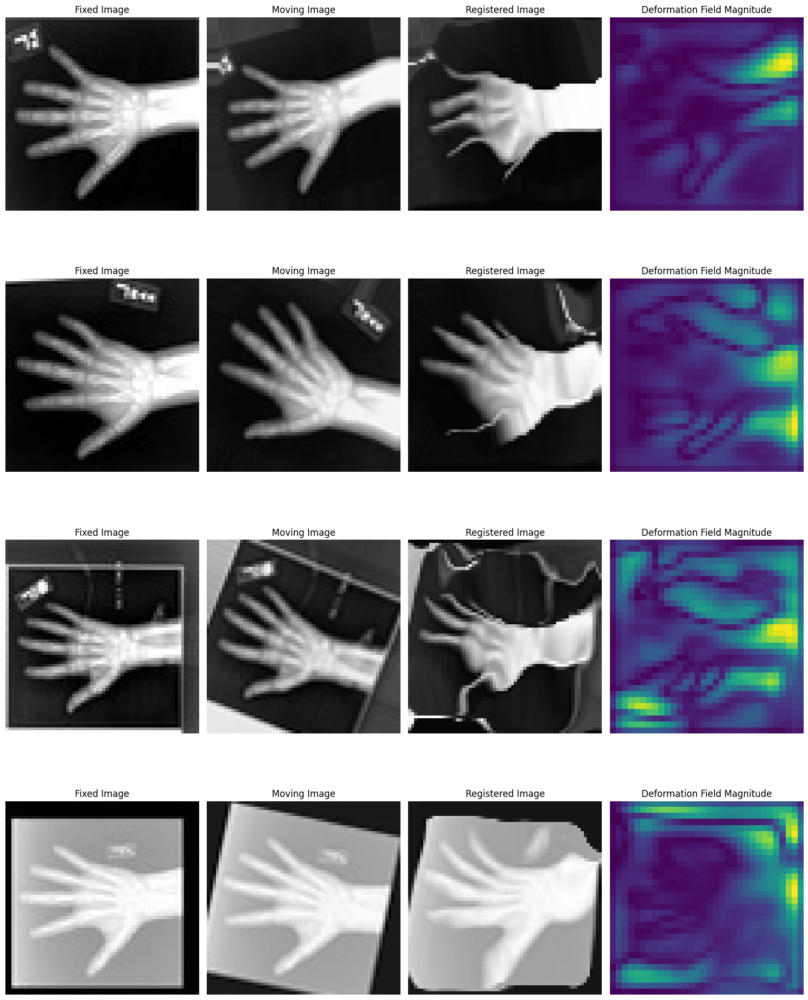

Epoch 97/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.65it/s, val_loss=metatensor(0.0061, device='cuda:0')]


Epoch 97/400 - Duration: 0.45 mins - Train Loss: 0.172, Train DICE: 0.599, Val Loss: 0.013, Val DICE: 0.609


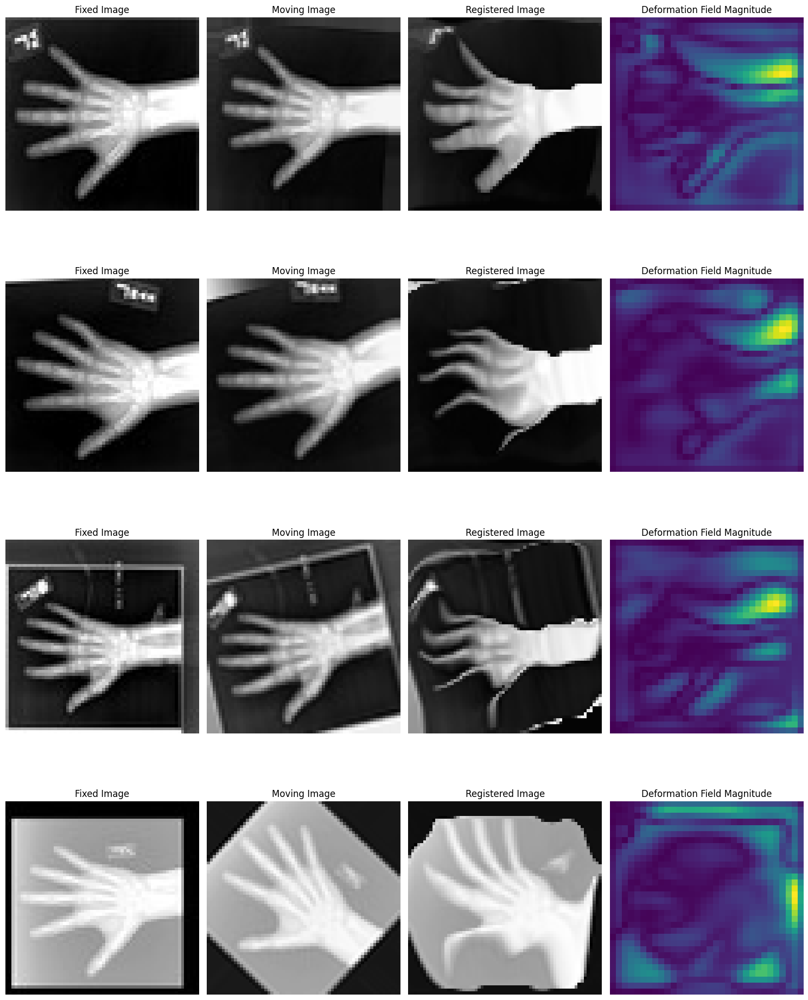

Epoch 98/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.66it/s, val_loss=metatensor(0.0056, device='cuda:0')]


Epoch 98/400 - Duration: 0.45 mins - Train Loss: 0.173, Train DICE: 0.599, Val Loss: 0.012, Val DICE: 0.609


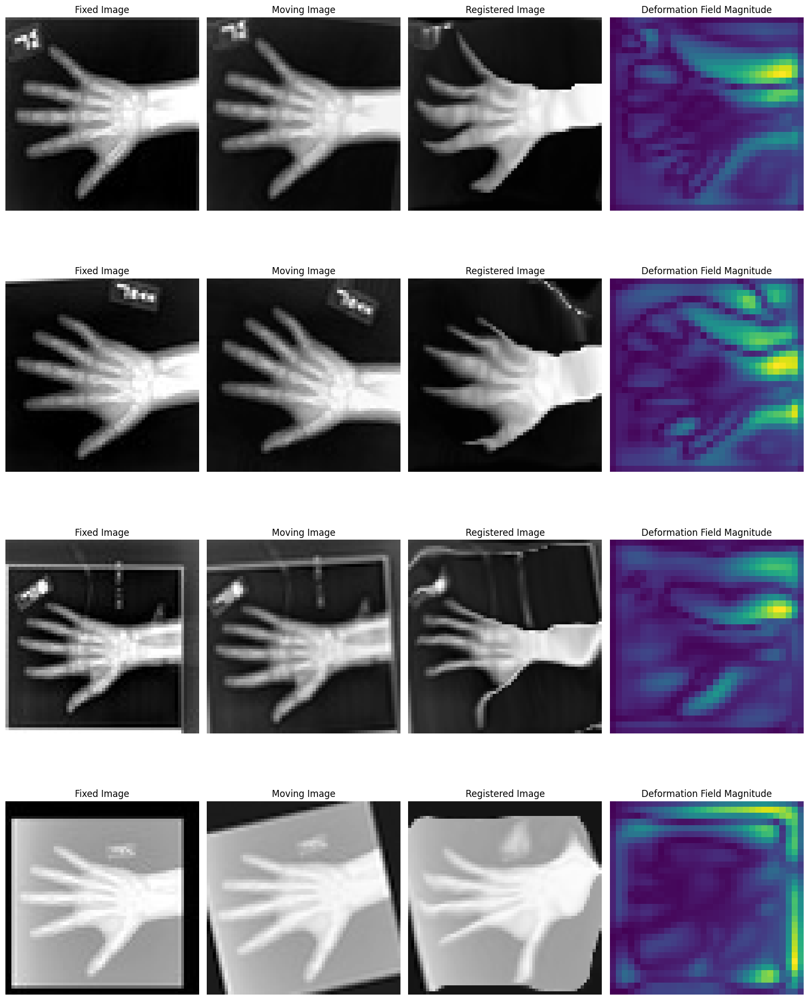

Epoch 99/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.62it/s, val_loss=metatensor(0.0066, device='cuda:0')]


Epoch 99/400 - Duration: 0.46 mins - Train Loss: 0.171, Train DICE: 0.599, Val Loss: 0.014, Val DICE: 0.610


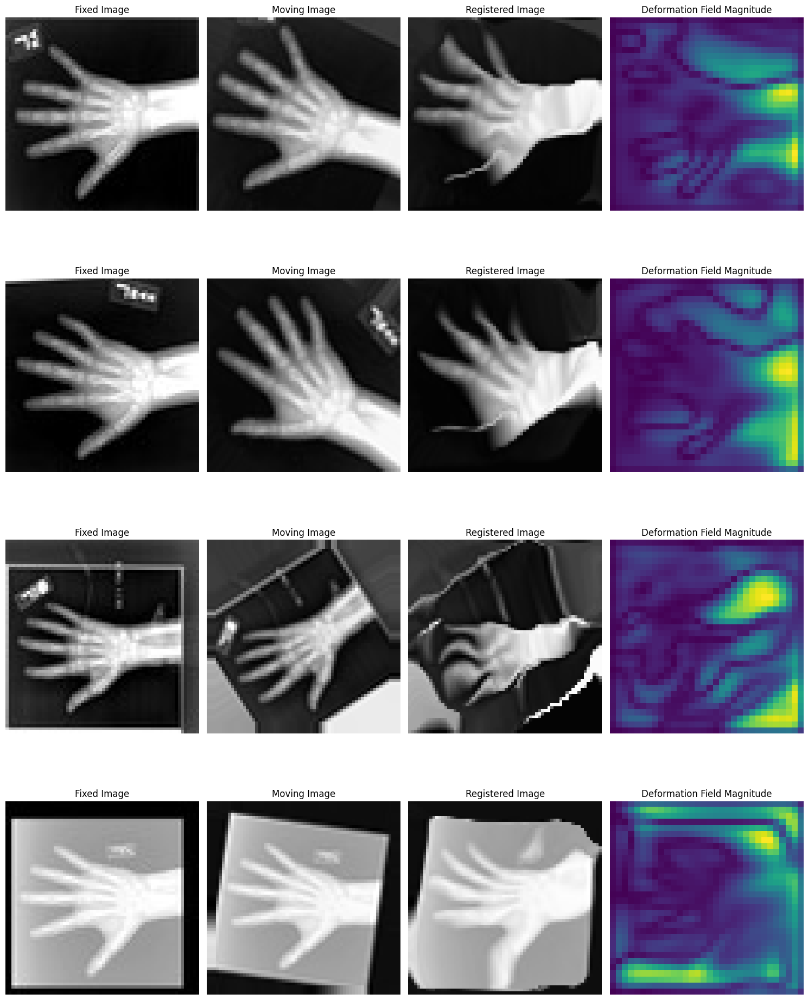

Epoch 100/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.61it/s, val_loss=metatensor(0.0059, device='cuda:0')]


Epoch 100/400 - Duration: 0.45 mins - Train Loss: 0.172, Train DICE: 0.599, Val Loss: 0.013, Val DICE: 0.611


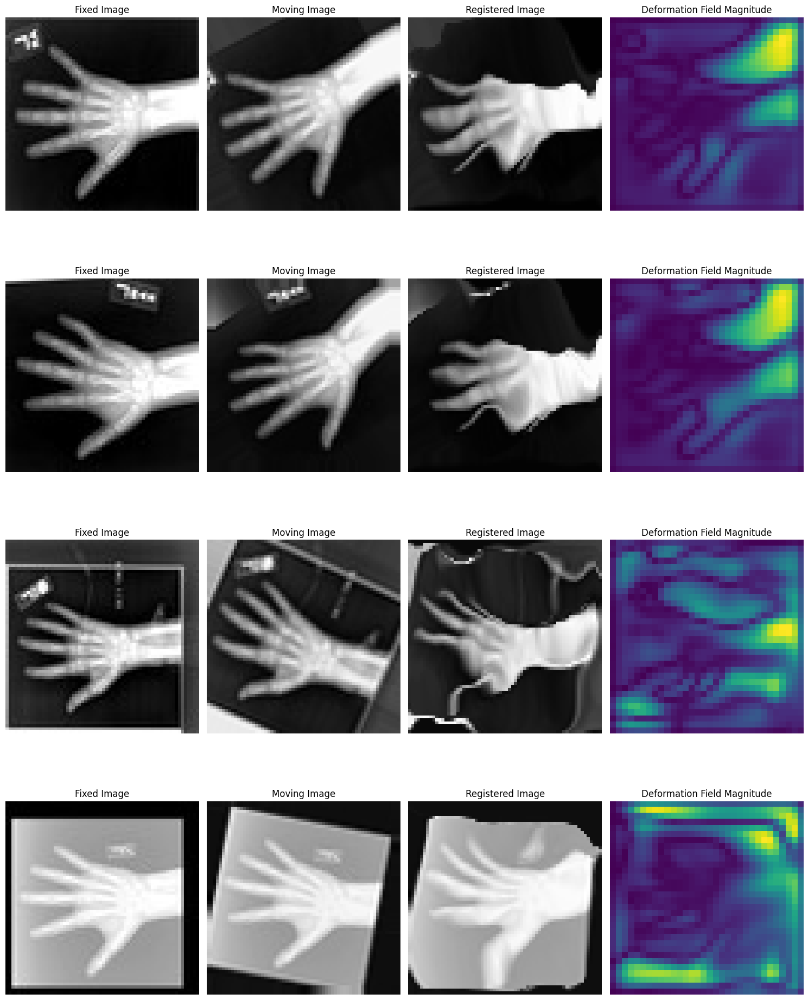

Epoch 101/400 - Validation: 100%|██████████| 32/32 [00:09<00:00,  3.48it/s, val_loss=metatensor(0.0059, device='cuda:0')]


Epoch 101/400 - Duration: 0.45 mins - Train Loss: 0.174, Train DICE: 0.598, Val Loss: 0.013, Val DICE: 0.610


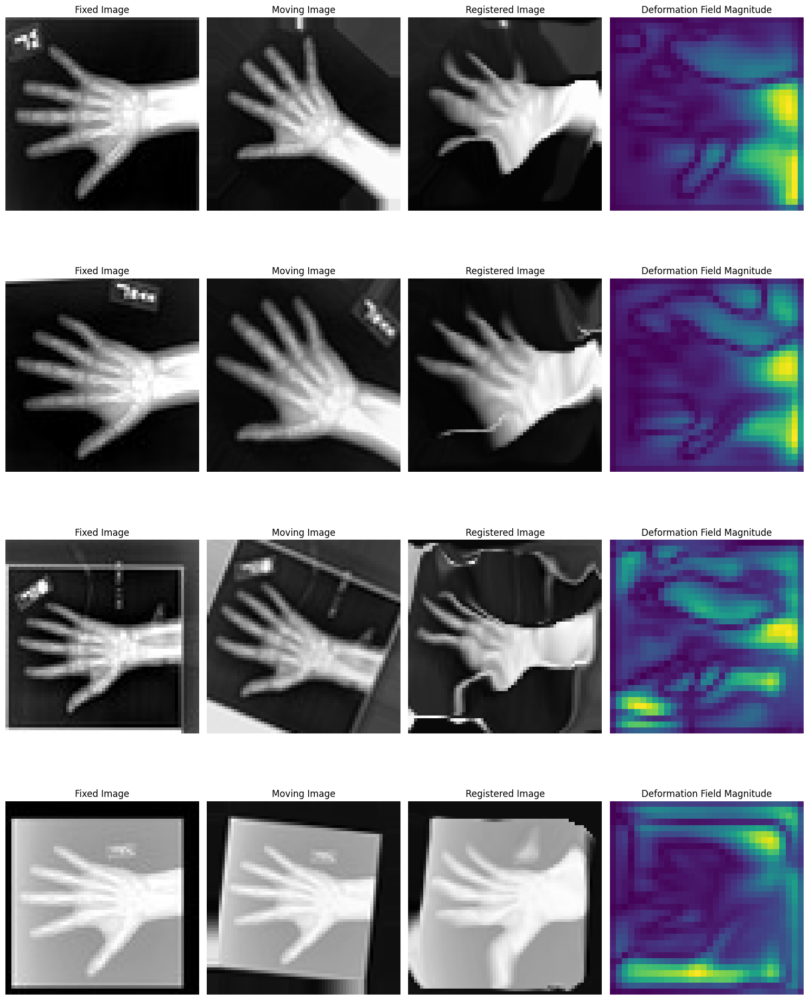

Epoch 102/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.73it/s, val_loss=metatensor(0.0063, device='cuda:0')]


Epoch 102/400 - Duration: 0.44 mins - Train Loss: 0.171, Train DICE: 0.599, Val Loss: 0.014, Val DICE: 0.608


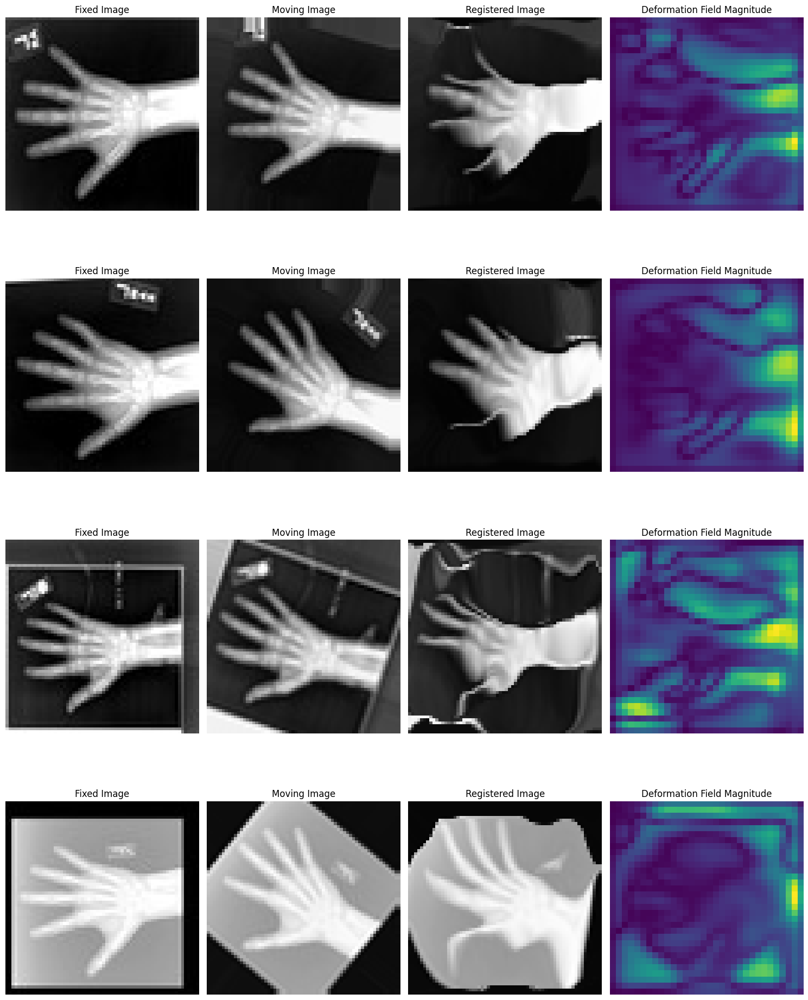

Epoch 103/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.81it/s, val_loss=metatensor(0.0065, device='cuda:0')]


Epoch 103/400 - Duration: 0.44 mins - Train Loss: 0.174, Train DICE: 0.597, Val Loss: 0.014, Val DICE: 0.610


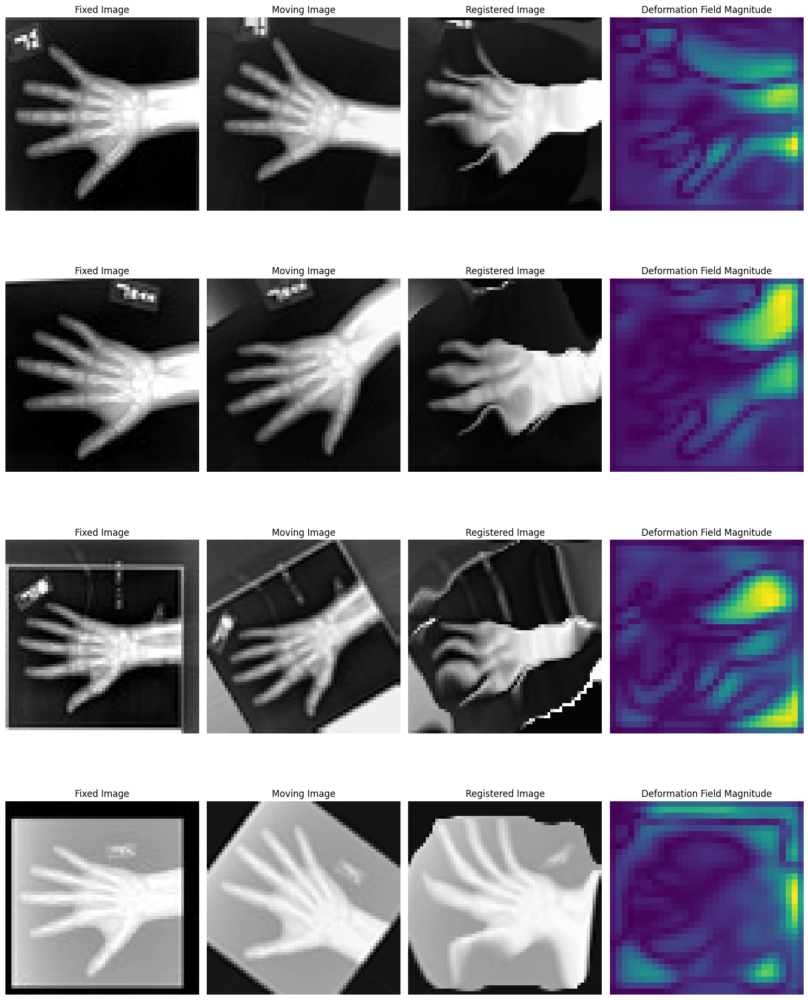

Epoch 104/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.94it/s, val_loss=metatensor(0.0060, device='cuda:0')]


Epoch 104/400 - Duration: 0.44 mins - Train Loss: 0.174, Train DICE: 0.598, Val Loss: 0.013, Val DICE: 0.608


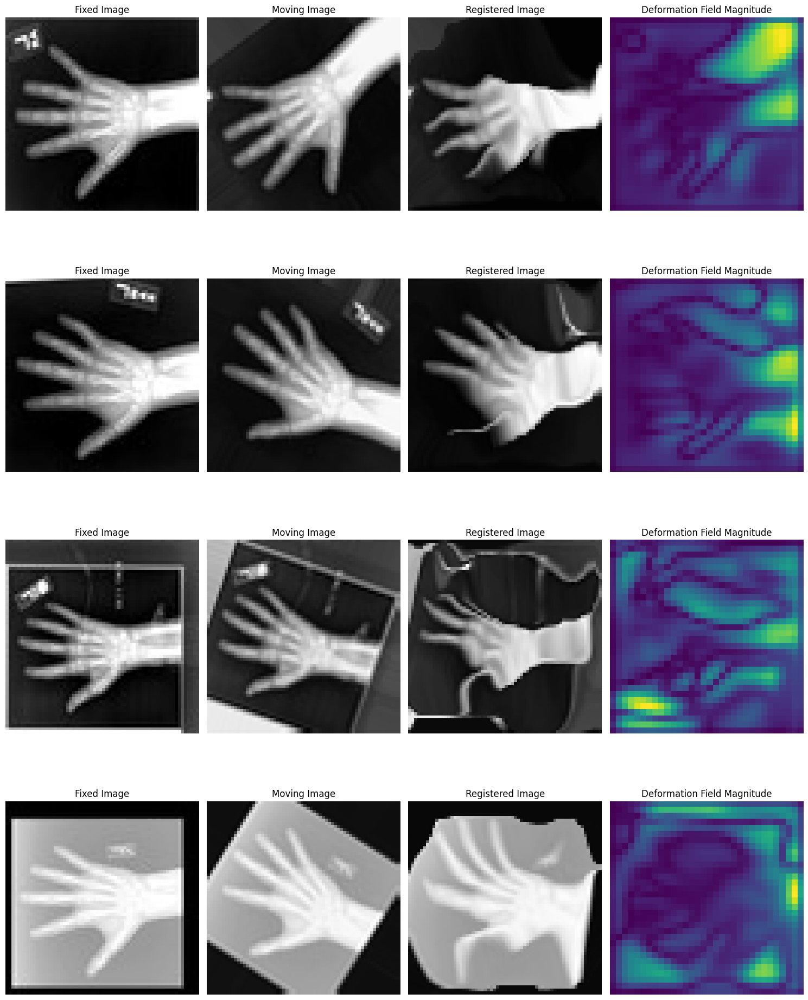

Epoch 105/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.68it/s, val_loss=metatensor(0.0062, device='cuda:0')]


Epoch 105/400 - Duration: 0.45 mins - Train Loss: 0.172, Train DICE: 0.599, Val Loss: 0.013, Val DICE: 0.610


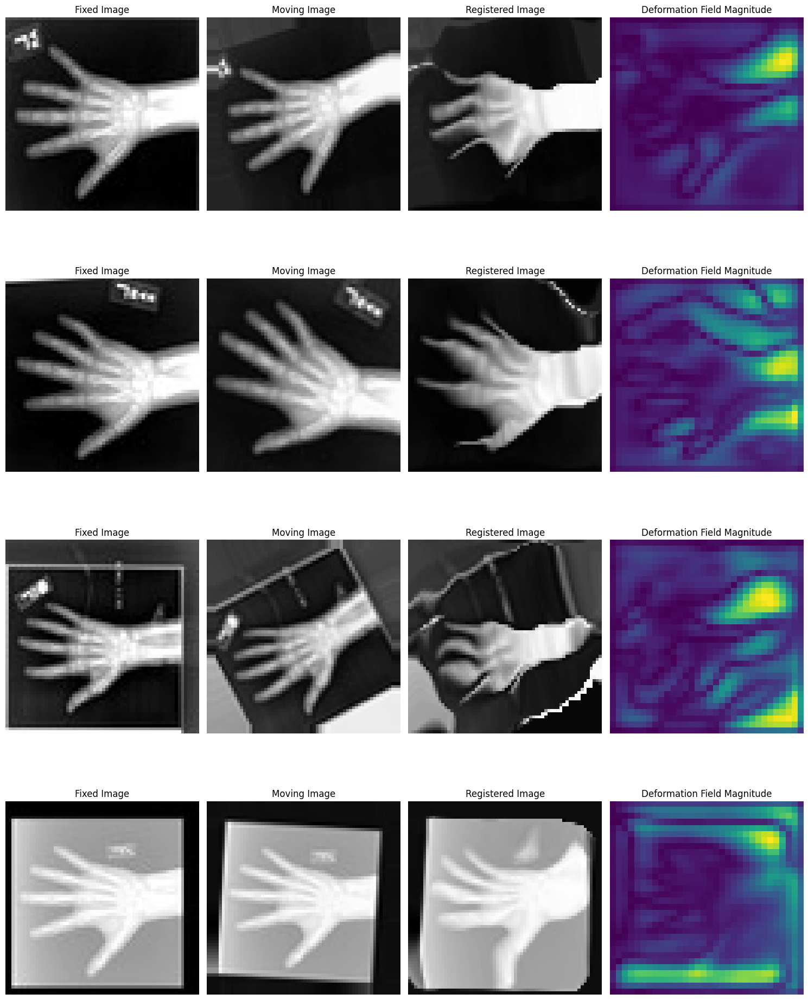

Epoch 106/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.71it/s, val_loss=metatensor(0.0059, device='cuda:0')]


Epoch 106/400 - Duration: 0.44 mins - Train Loss: 0.172, Train DICE: 0.599, Val Loss: 0.013, Val DICE: 0.610


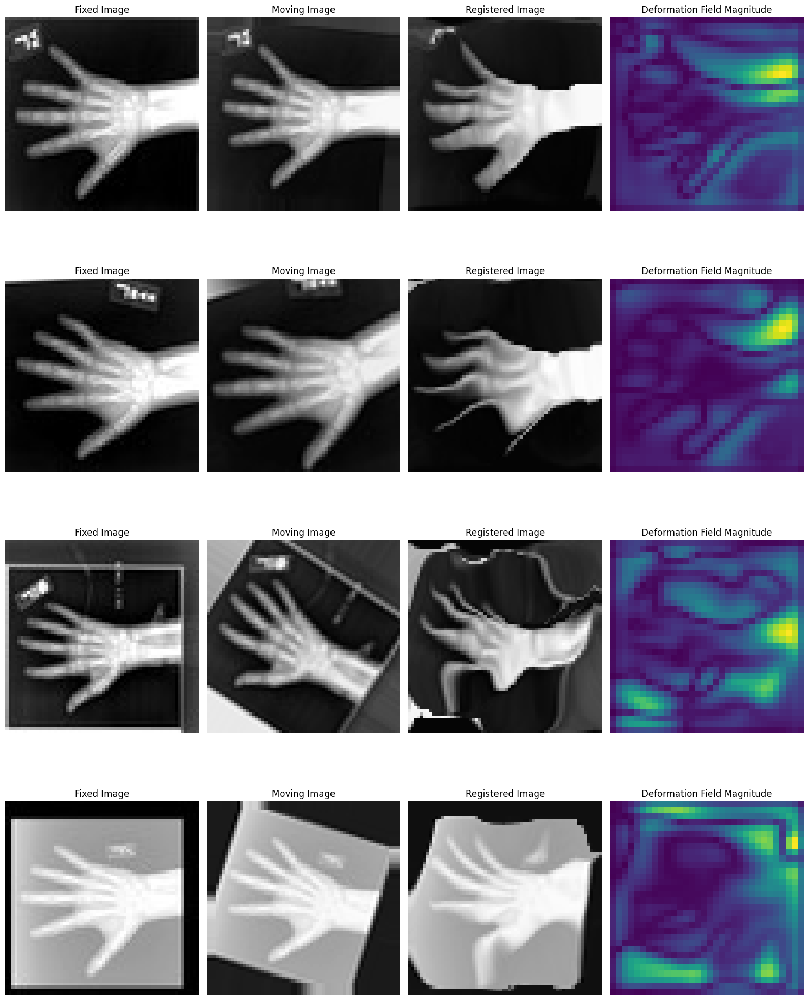

Epoch 107/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.60it/s, val_loss=metatensor(0.0059, device='cuda:0')]


Epoch 107/400 - Duration: 0.45 mins - Train Loss: 0.172, Train DICE: 0.600, Val Loss: 0.013, Val DICE: 0.610


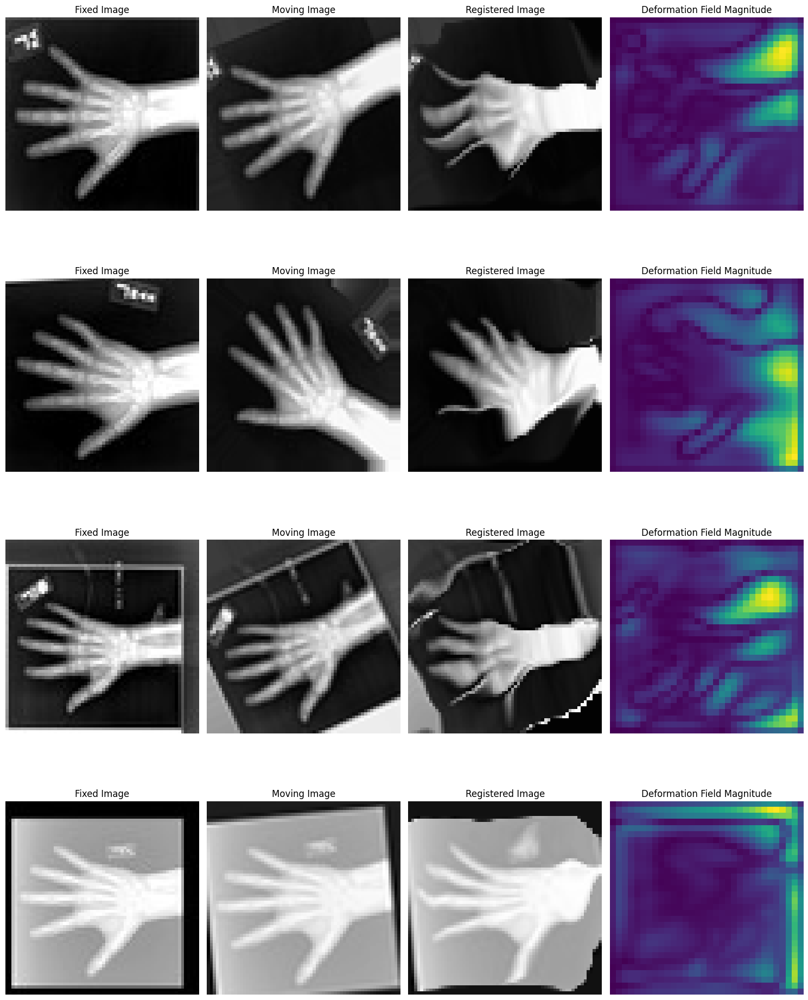

Epoch 108/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.69it/s, val_loss=metatensor(0.0058, device='cuda:0')]


Epoch 108/400 - Duration: 0.44 mins - Train Loss: 0.174, Train DICE: 0.599, Val Loss: 0.012, Val DICE: 0.611


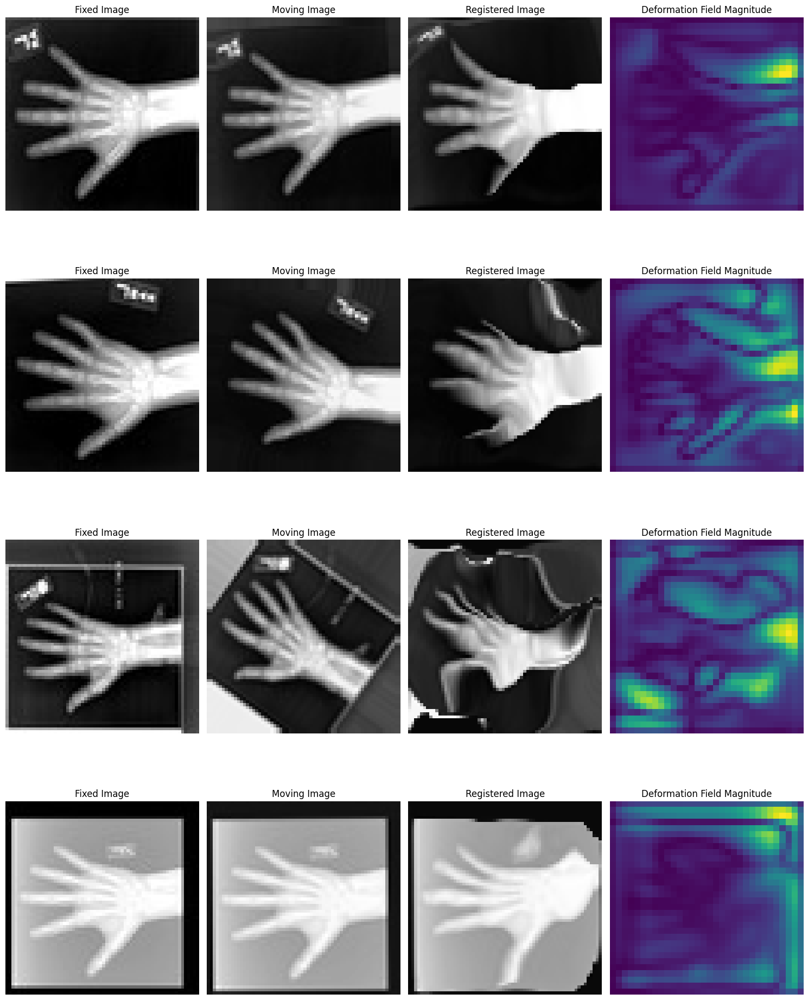

Epoch 109/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.64it/s, val_loss=metatensor(0.0060, device='cuda:0')]


Epoch 109/400 - Duration: 0.45 mins - Train Loss: 0.174, Train DICE: 0.598, Val Loss: 0.013, Val DICE: 0.610


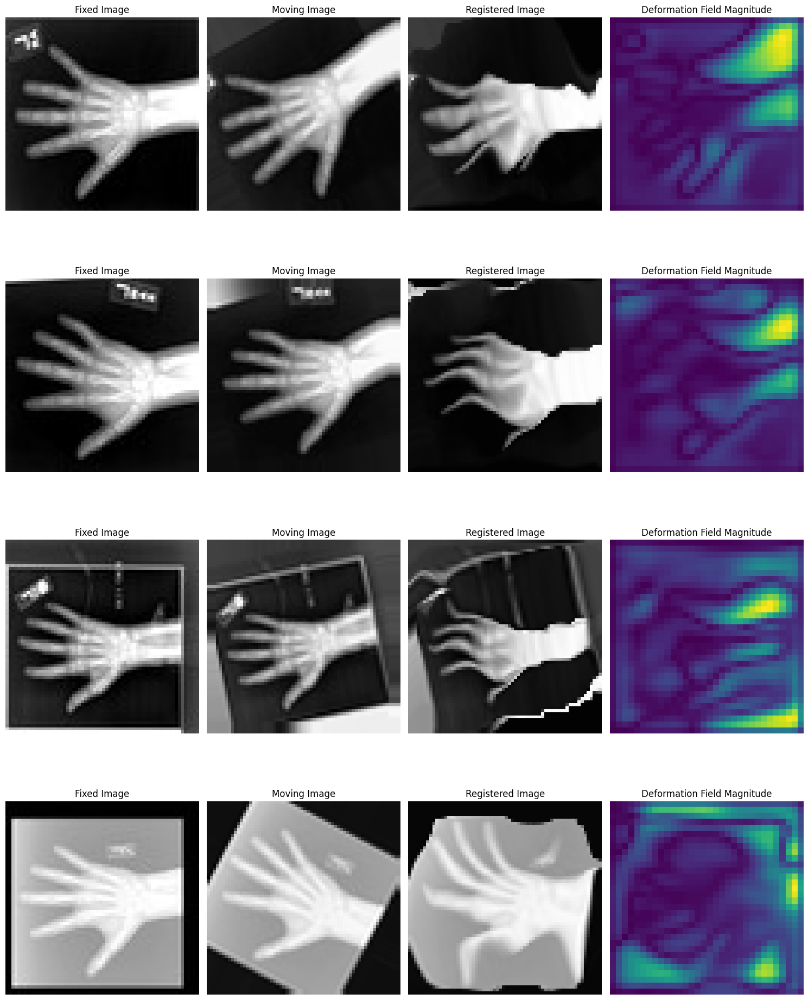

Epoch 110/400 - Validation: 100%|██████████| 32/32 [00:07<00:00,  4.06it/s, val_loss=metatensor(0.0063, device='cuda:0')]


Epoch 110/400 - Duration: 0.44 mins - Train Loss: 0.171, Train DICE: 0.599, Val Loss: 0.014, Val DICE: 0.610


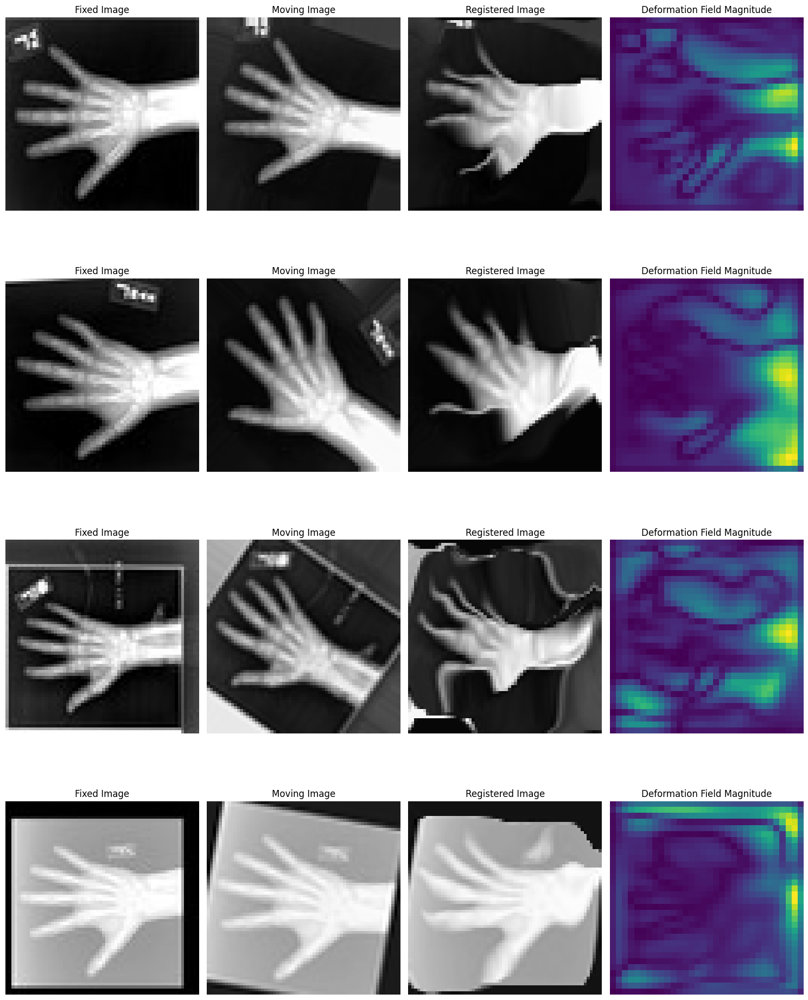

Epoch 111/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.79it/s, val_loss=metatensor(0.0064, device='cuda:0')]


Epoch 111/400 - Duration: 0.45 mins - Train Loss: 0.171, Train DICE: 0.599, Val Loss: 0.014, Val DICE: 0.610


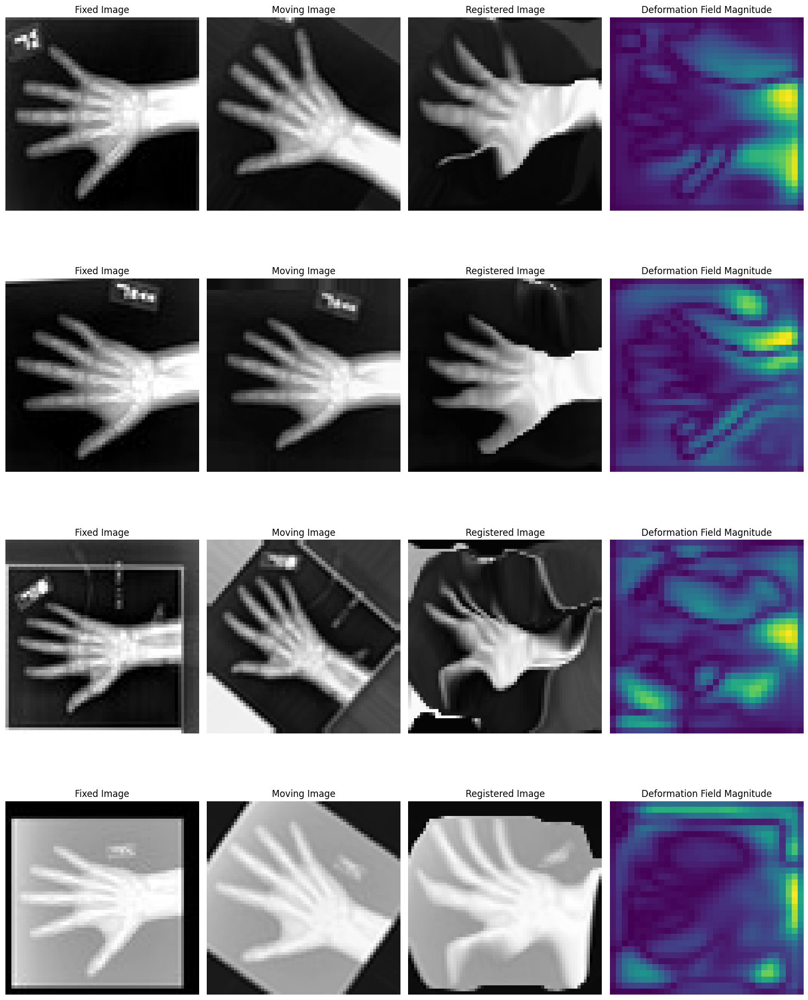

Epoch 112/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.78it/s, val_loss=metatensor(0.0068, device='cuda:0')]


Epoch 112/400 - Duration: 0.45 mins - Train Loss: 0.170, Train DICE: 0.600, Val Loss: 0.015, Val DICE: 0.609


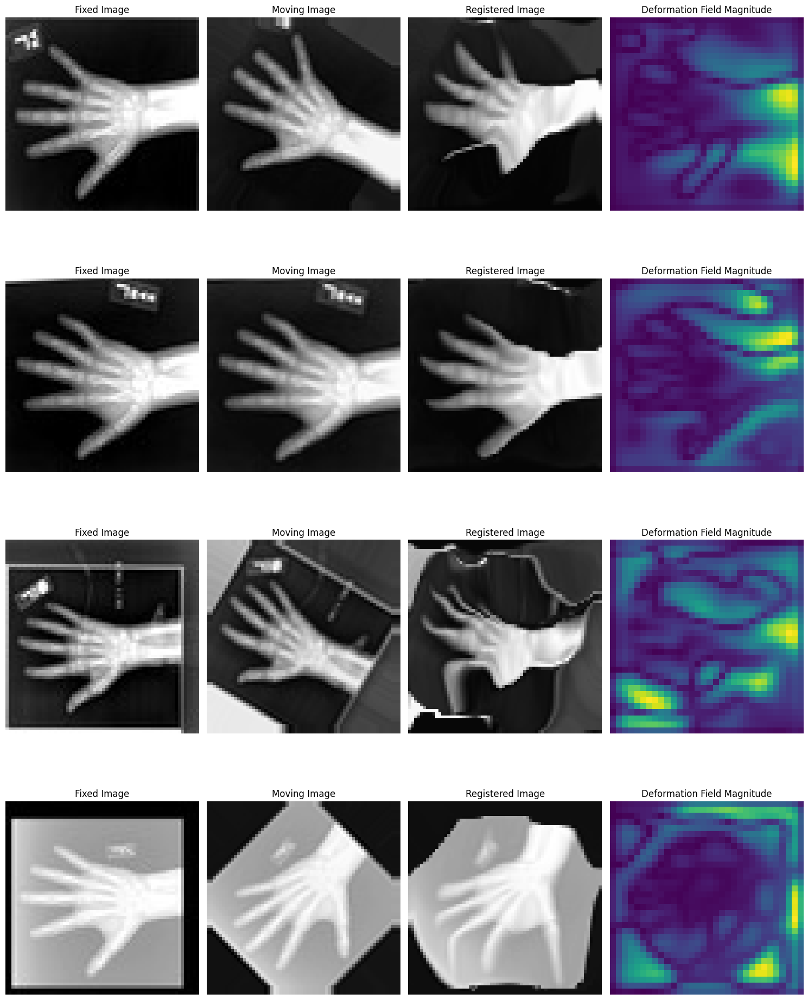

Epoch 113/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.80it/s, val_loss=metatensor(0.0059, device='cuda:0')]


Epoch 113/400 - Duration: 0.44 mins - Train Loss: 0.172, Train DICE: 0.599, Val Loss: 0.013, Val DICE: 0.611


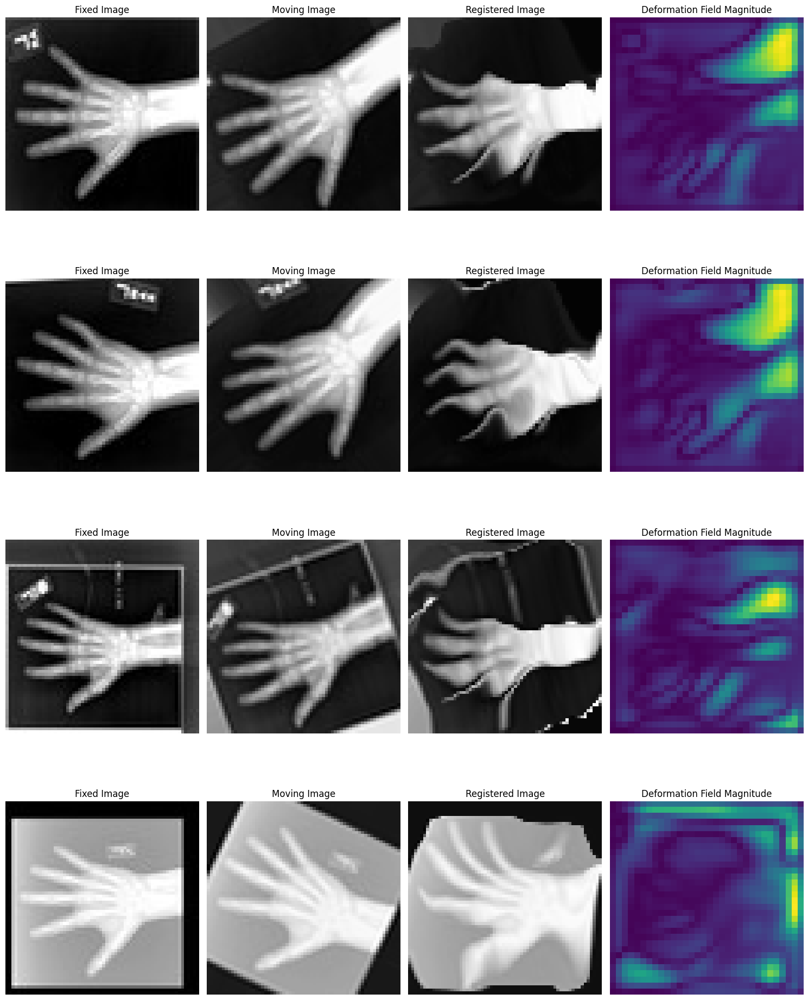

Epoch 114/400 - Validation: 100%|██████████| 32/32 [00:09<00:00,  3.54it/s, val_loss=metatensor(0.0061, device='cuda:0')]


Epoch 114/400 - Duration: 0.45 mins - Train Loss: 0.170, Train DICE: 0.600, Val Loss: 0.013, Val DICE: 0.610


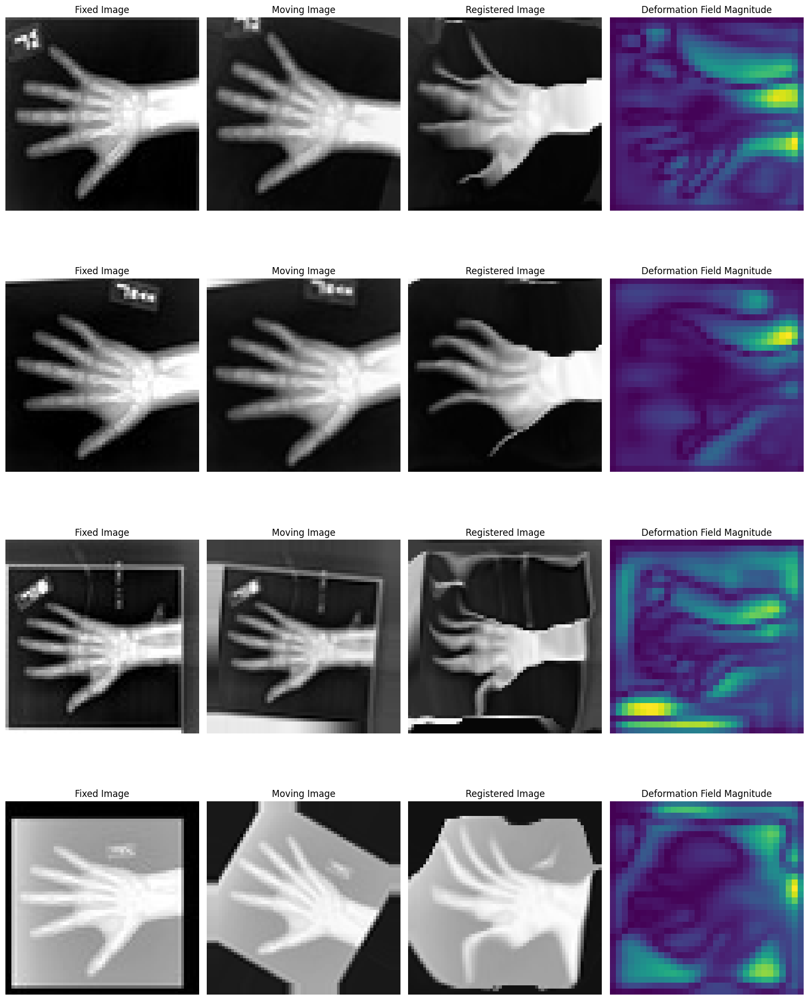

Epoch 115/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.62it/s, val_loss=metatensor(0.0060, device='cuda:0')]


Epoch 115/400 - Duration: 0.46 mins - Train Loss: 0.169, Train DICE: 0.601, Val Loss: 0.013, Val DICE: 0.611


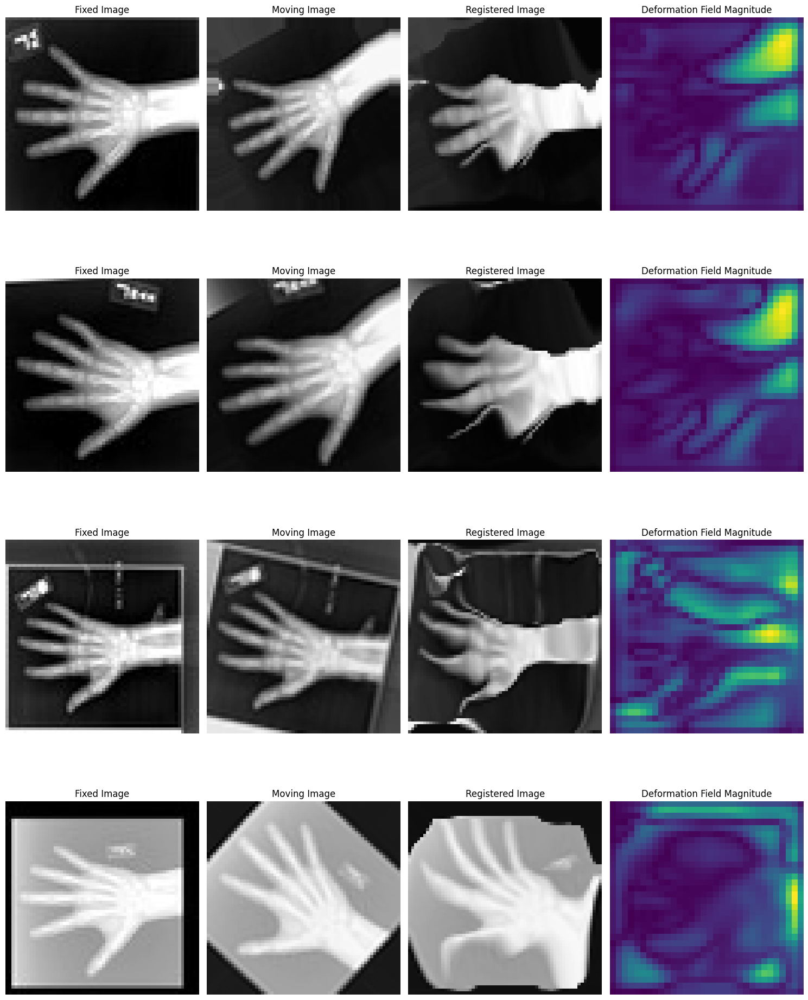

Epoch 116/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.73it/s, val_loss=metatensor(0.0056, device='cuda:0')]


Epoch 116/400 - Duration: 0.44 mins - Train Loss: 0.167, Train DICE: 0.601, Val Loss: 0.012, Val DICE: 0.609


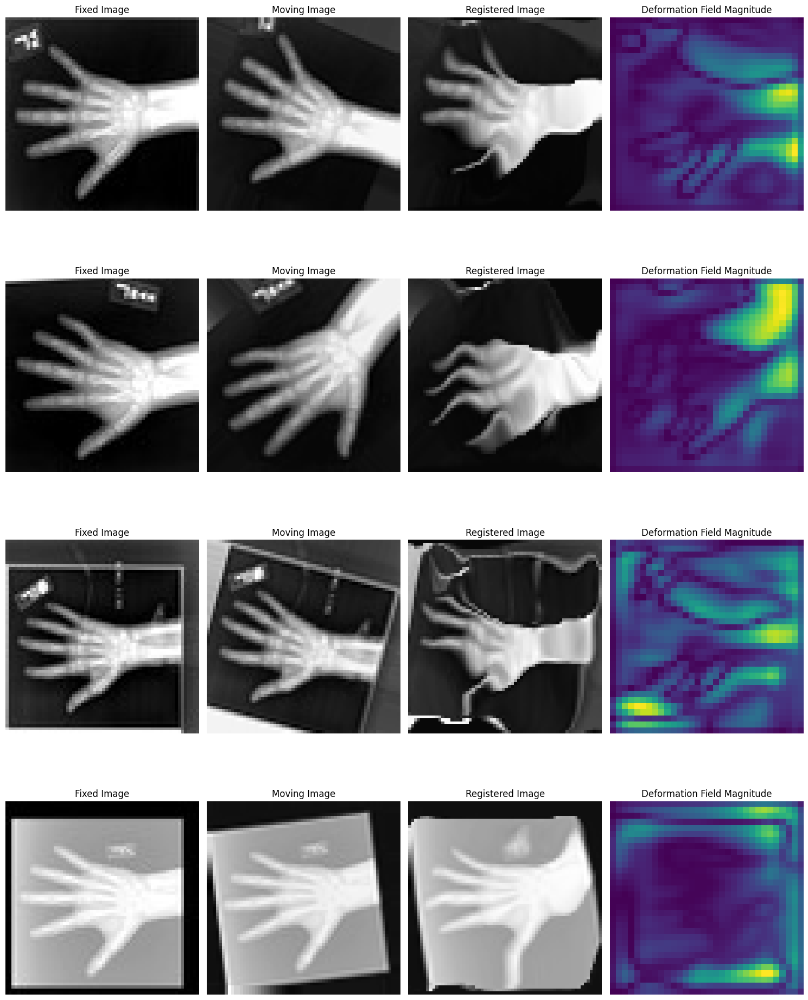

Epoch 117/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.67it/s, val_loss=metatensor(0.0064, device='cuda:0')]


Epoch 117/400 - Duration: 0.44 mins - Train Loss: 0.170, Train DICE: 0.600, Val Loss: 0.014, Val DICE: 0.610


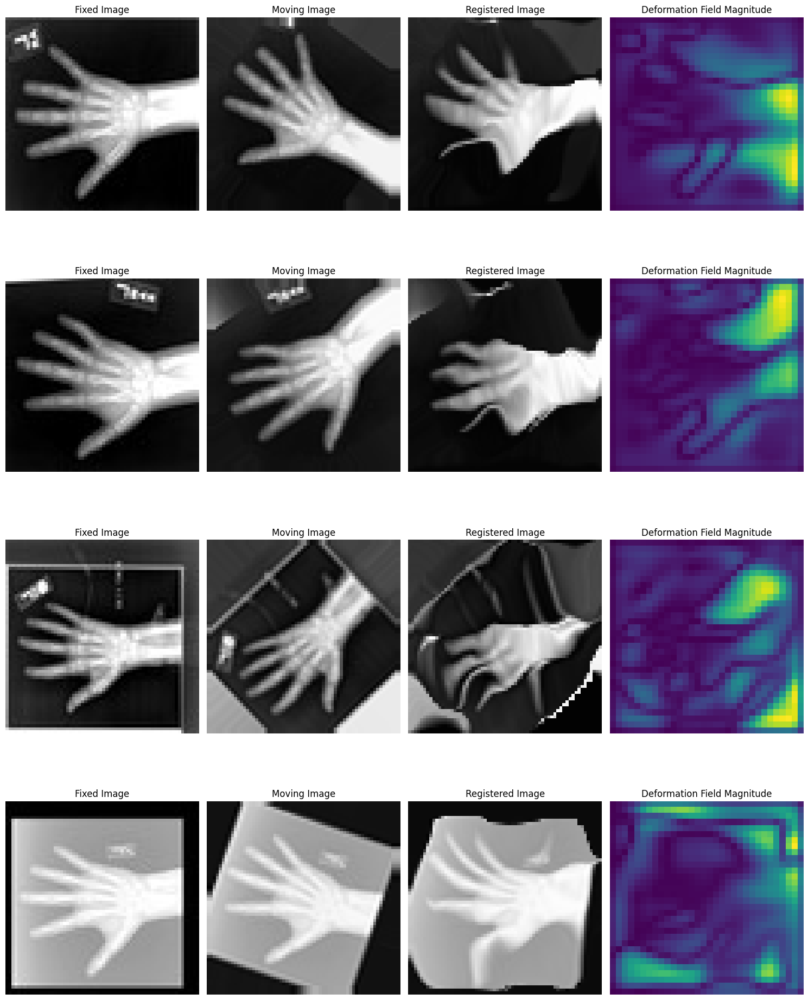

Epoch 118/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.83it/s, val_loss=metatensor(0.0057, device='cuda:0')]


Epoch 118/400 - Duration: 0.44 mins - Train Loss: 0.170, Train DICE: 0.600, Val Loss: 0.012, Val DICE: 0.611


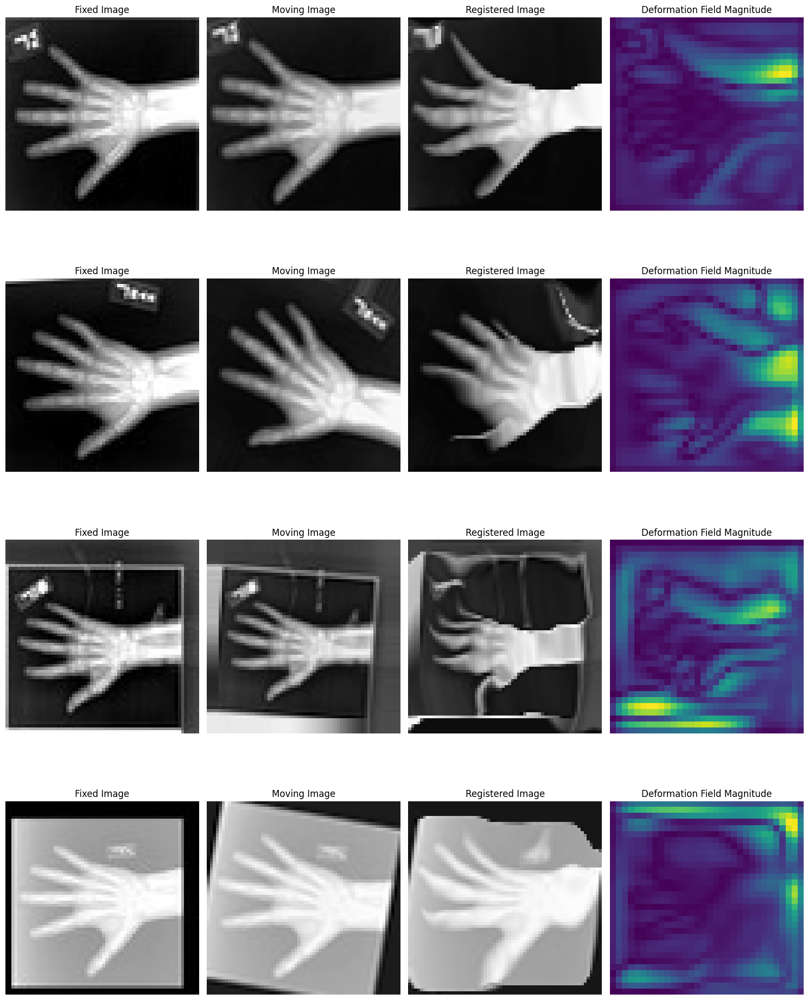

Epoch 119/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.61it/s, val_loss=metatensor(0.0059, device='cuda:0')]


Epoch 119/400 - Duration: 0.45 mins - Train Loss: 0.170, Train DICE: 0.600, Val Loss: 0.013, Val DICE: 0.609


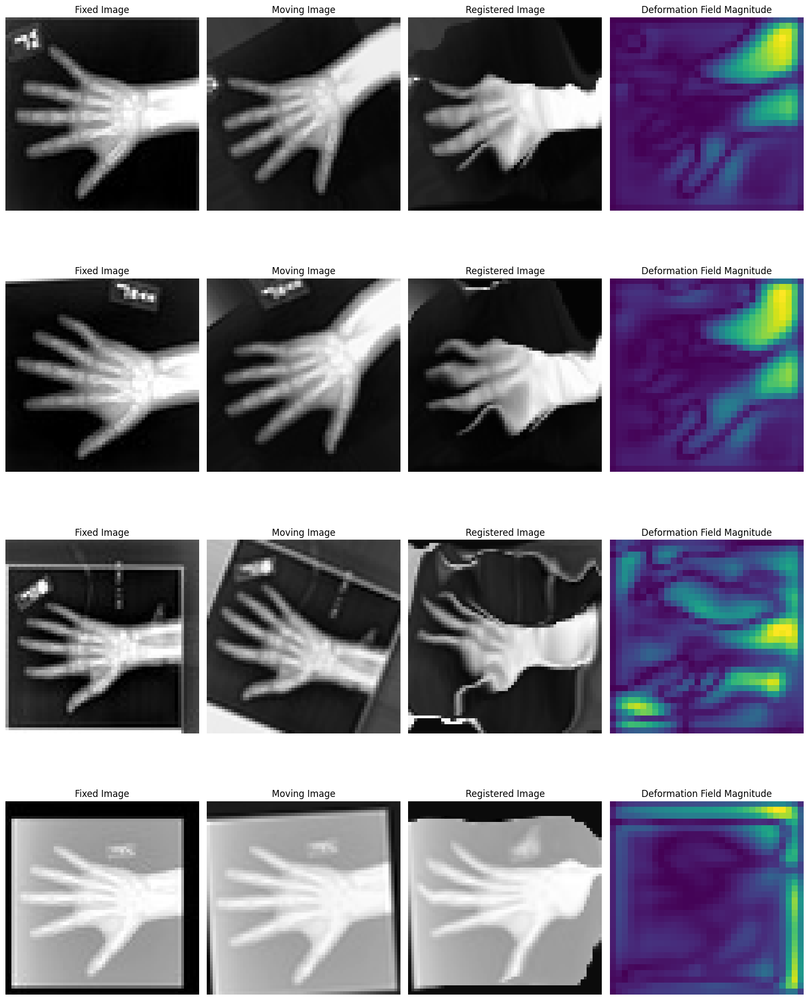

Epoch 120/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.61it/s, val_loss=metatensor(0.0062, device='cuda:0')]


Epoch 120/400 - Duration: 0.44 mins - Train Loss: 0.167, Train DICE: 0.601, Val Loss: 0.013, Val DICE: 0.610


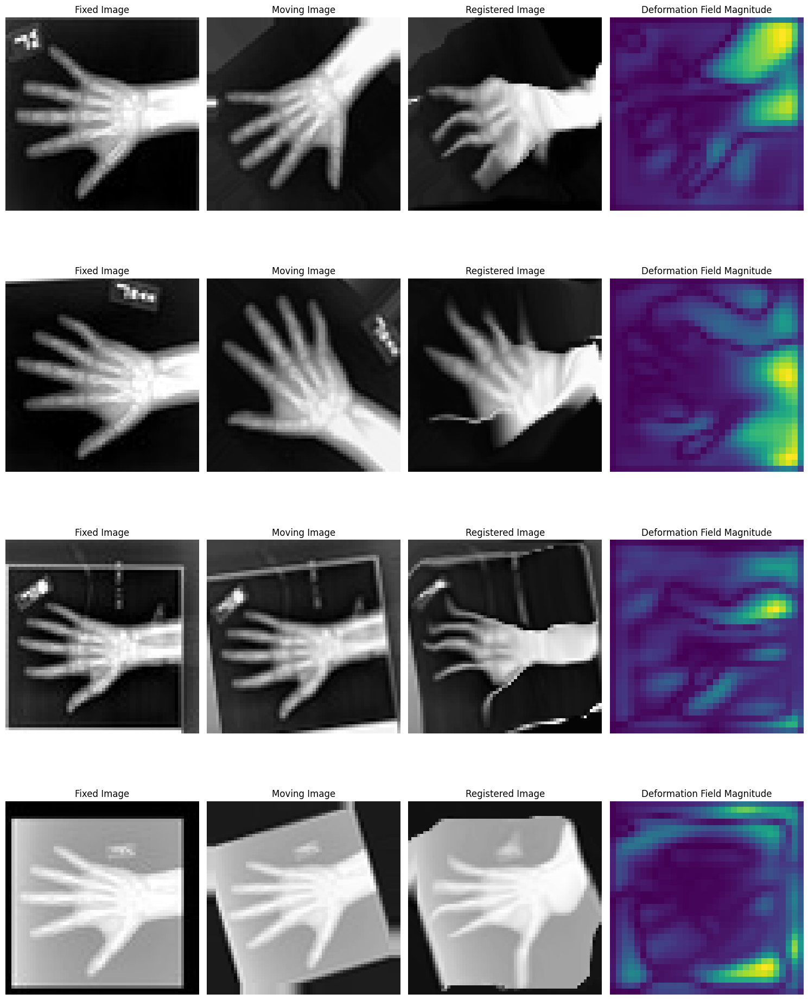

Epoch 121/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.76it/s, val_loss=metatensor(0.0062, device='cuda:0')]


Epoch 121/400 - Duration: 0.45 mins - Train Loss: 0.167, Train DICE: 0.600, Val Loss: 0.013, Val DICE: 0.610


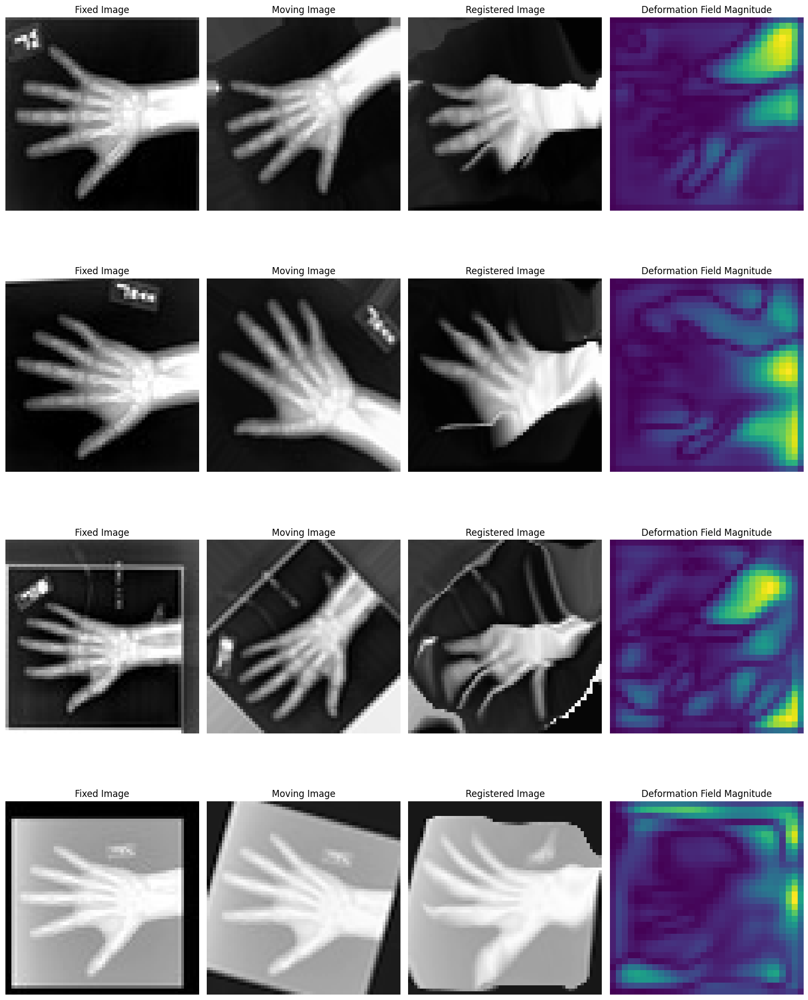

Epoch 122/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.63it/s, val_loss=metatensor(0.0063, device='cuda:0')]


Epoch 122/400 - Duration: 0.45 mins - Train Loss: 0.168, Train DICE: 0.600, Val Loss: 0.014, Val DICE: 0.612


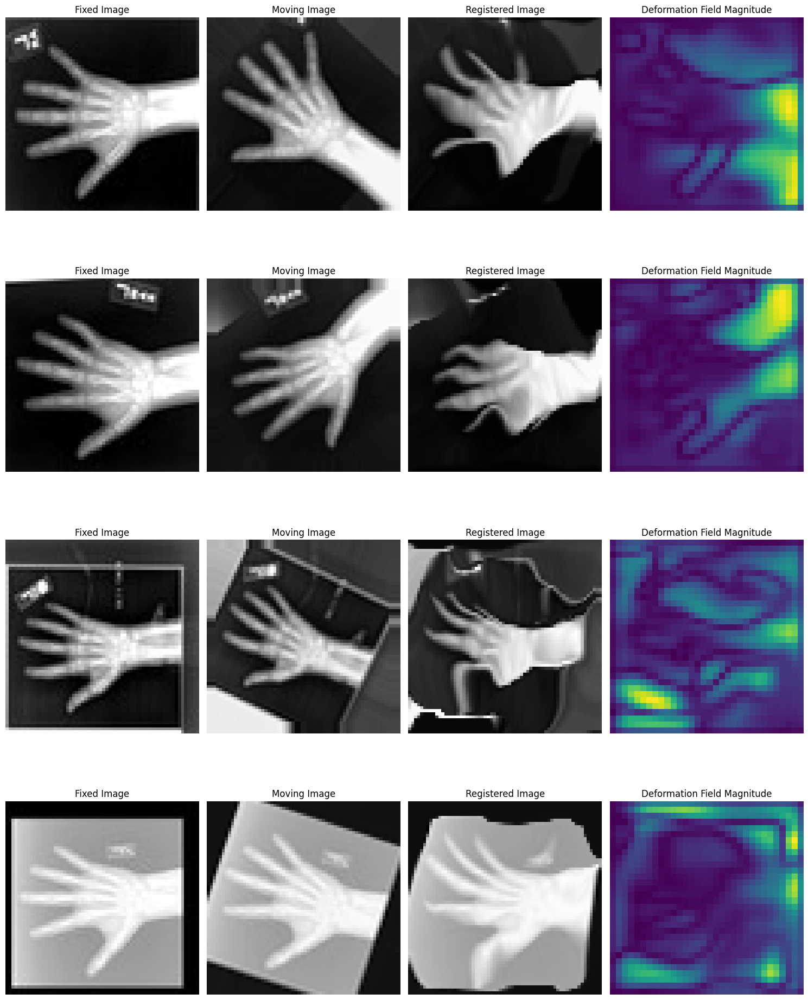

Epoch 123/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.64it/s, val_loss=metatensor(0.0058, device='cuda:0')]


Epoch 123/400 - Duration: 0.45 mins - Train Loss: 0.168, Train DICE: 0.600, Val Loss: 0.013, Val DICE: 0.612


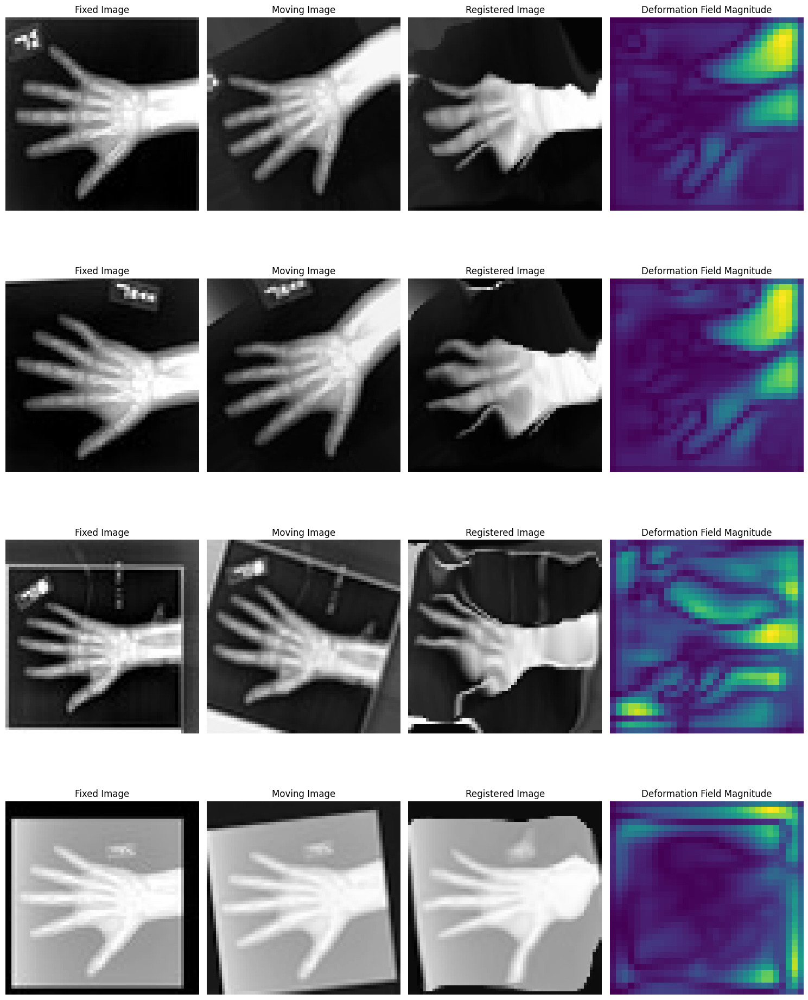

Epoch 124/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.84it/s, val_loss=metatensor(0.0067, device='cuda:0')]


Epoch 124/400 - Duration: 0.45 mins - Train Loss: 0.168, Train DICE: 0.600, Val Loss: 0.014, Val DICE: 0.611


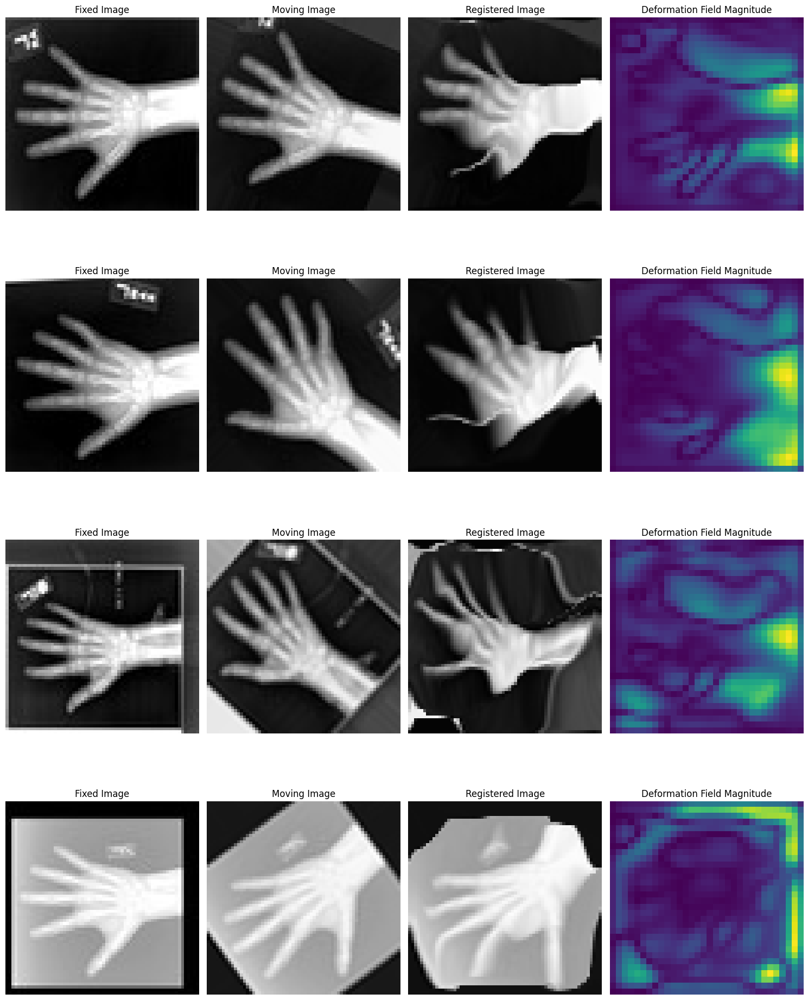

Epoch 125/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.68it/s, val_loss=metatensor(0.0054, device='cuda:0')]


Epoch 125/400 - Duration: 0.45 mins - Train Loss: 0.167, Train DICE: 0.601, Val Loss: 0.012, Val DICE: 0.613


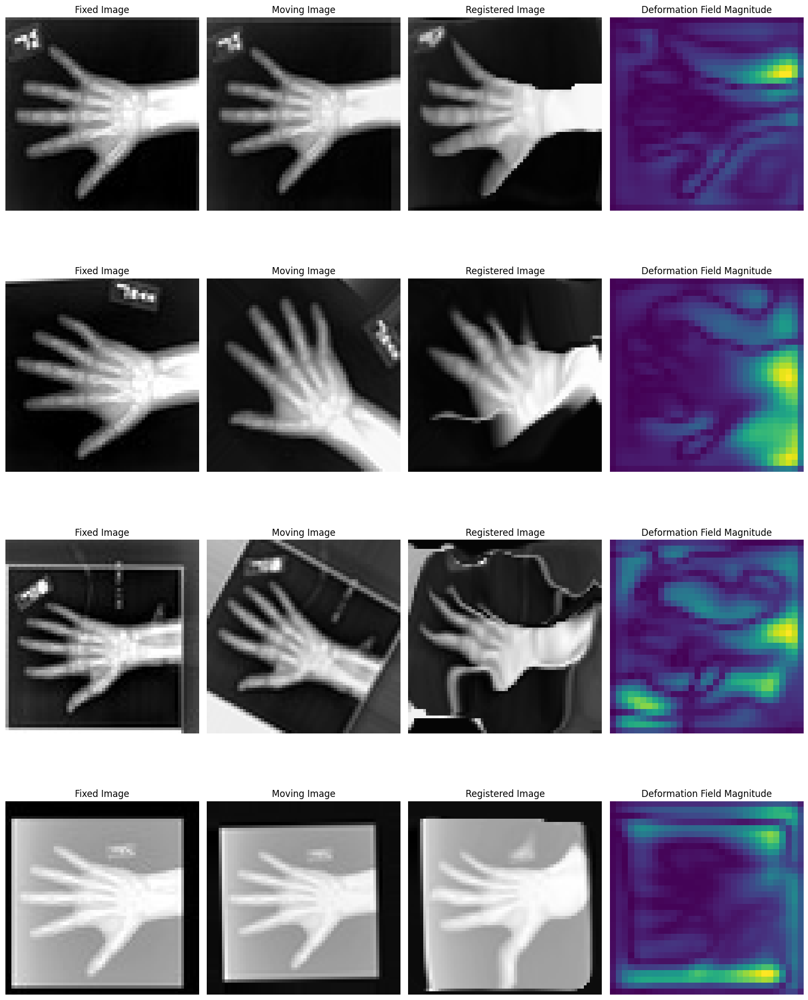

Epoch 126/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.65it/s, val_loss=metatensor(0.0066, device='cuda:0')]


Epoch 126/400 - Duration: 0.45 mins - Train Loss: 0.164, Train DICE: 0.602, Val Loss: 0.014, Val DICE: 0.611


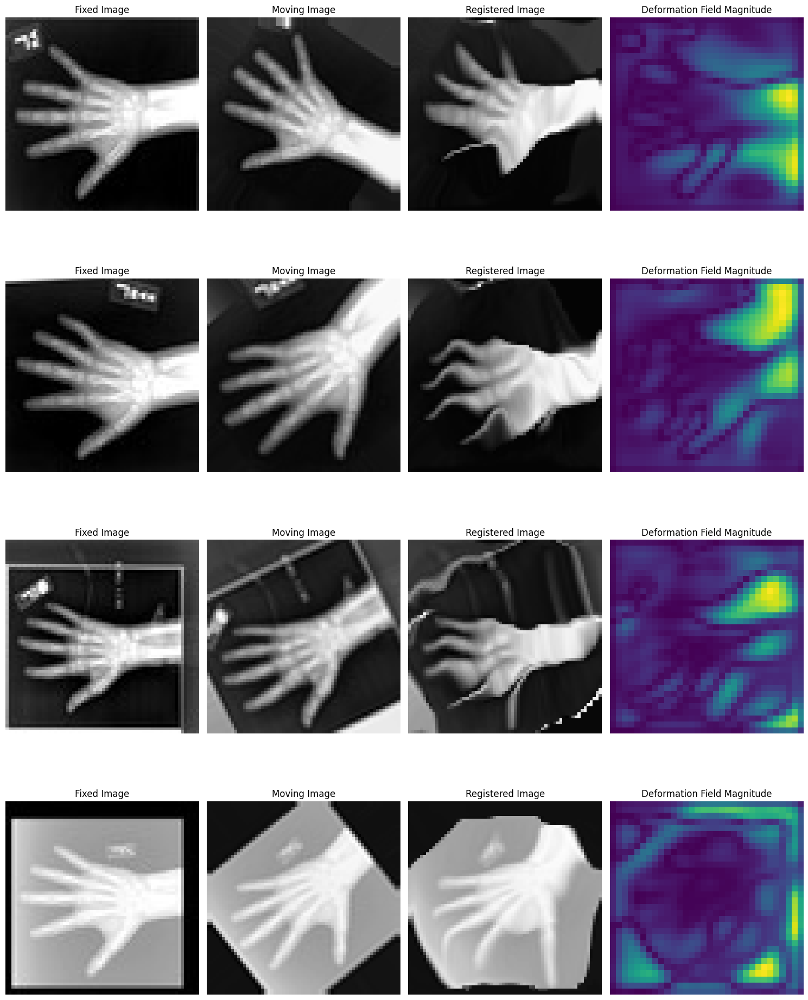

Epoch 127/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.88it/s, val_loss=metatensor(0.0061, device='cuda:0')]


Epoch 127/400 - Duration: 0.44 mins - Train Loss: 0.165, Train DICE: 0.601, Val Loss: 0.013, Val DICE: 0.611


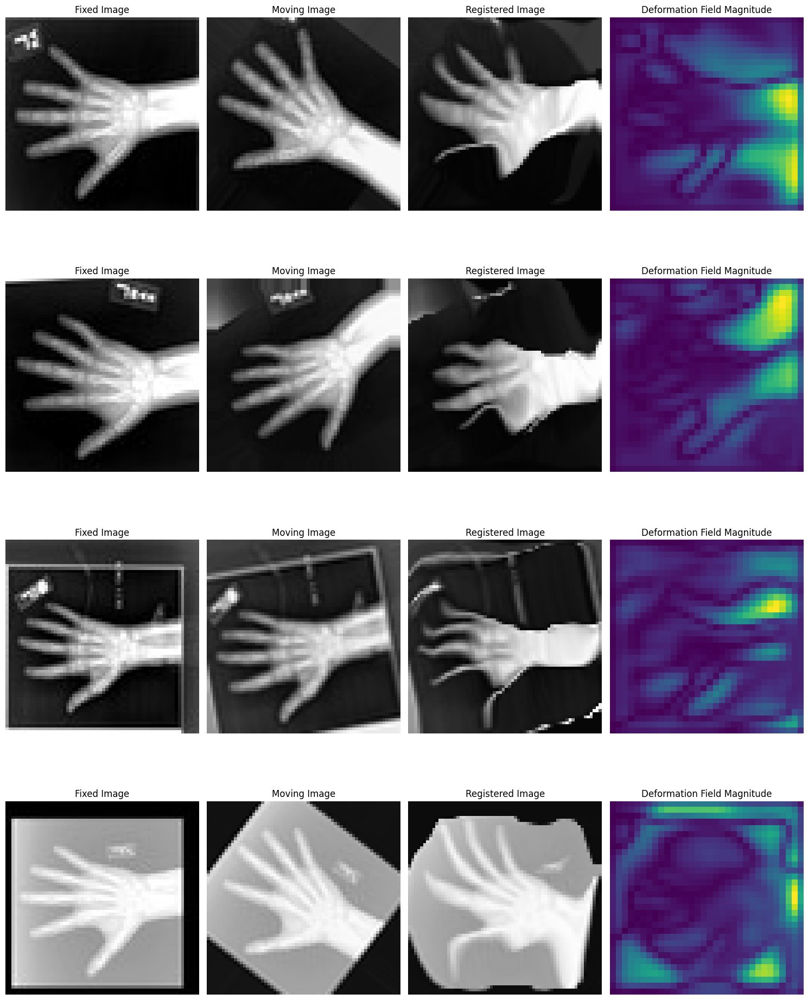

Epoch 128/400 - Validation: 100%|██████████| 32/32 [00:08<00:00,  3.66it/s, val_loss=metatensor(0.0065, device='cuda:0')]


Epoch 128/400 - Duration: 0.45 mins - Train Loss: 0.166, Train DICE: 0.602, Val Loss: 0.014, Val DICE: 0.611


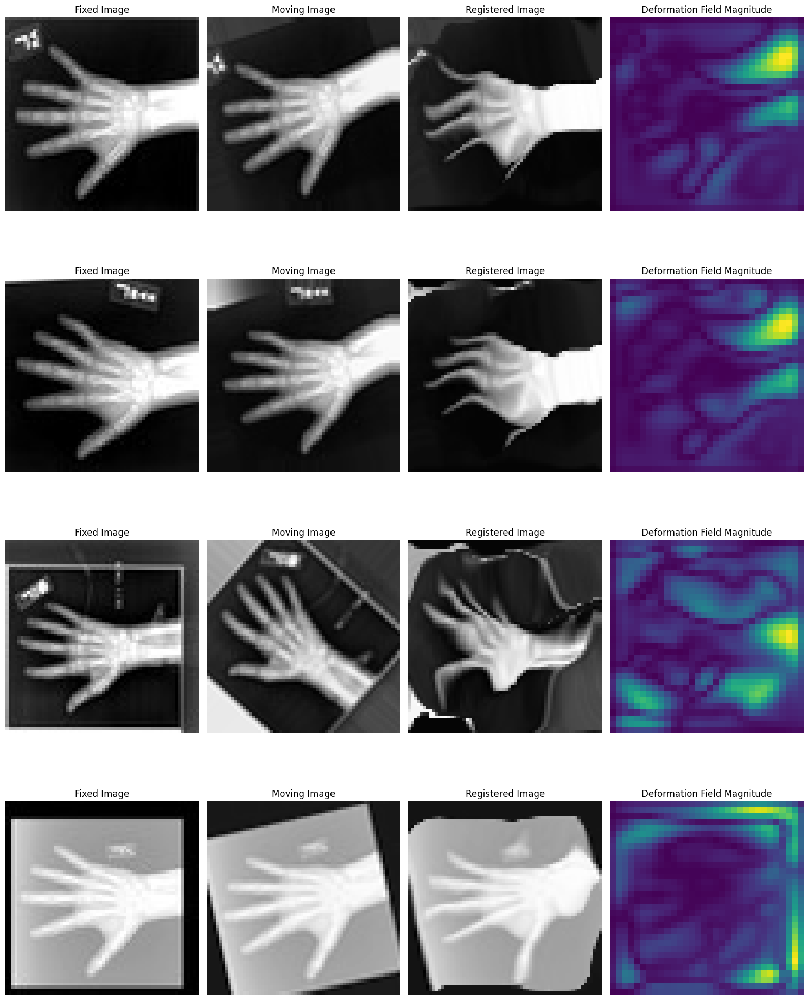

Epoch 129/400 - Training:  21%|██        | 13/63 [00:04<00:17,  2.92it/s, train_loss=0.17]

In [ ]:
num_epochs = 400
for epoch in range(num_epochs):
    epoch_start_time = time.time()
    train_loss, train_dice_score, val_loss, val_dice_score = 0, 0, 0, 0
    num_train_batches, num_val_batches = len(train_loader), len(val_loader)

    voxelmorph.train()
    train_loader_tqdm = tqdm(train_loader, desc=f'Epoch {epoch + 1}/{num_epochs} - Training')
    #################################################################################
    #                         YOUR CODE GOES HERE               12 pts              #
    for batch in train_loader_tqdm:
        batch_fixed, batch_moving = batch['fixed_hand'].to(device), batch['moving_hand'].to(device)
        # Forward pass
        deformation_field = voxelmorph(batch_moving, batch_fixed)
        loss = criterion(batch_fixed, deformation_field[0], deformation_field[1])
        # Backpropagation and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        # Update training loss and dice score
        train_loss += loss.item()
        train_dice_score += dice_score(batch_fixed, deformation_field[0])
        # Update progress bar
        train_loader_tqdm.set_postfix(train_loss=train_loss / (train_loader_tqdm.n + 1))
    #################################################################################
    train_loss /= num_train_batches
    train_dice_score /= num_train_batches

    # Validation Phase
    voxelmorph.eval()
    val_loader_tqdm = tqdm(val_loader, desc=f'Epoch {epoch + 1}/{num_epochs} - Validation')
    with torch.no_grad():
         #################################################################################
         #                         YOUR CODE GOES HERE               8 pts              #
        for batch in val_loader_tqdm:
            batch_fixed, batch_moving = batch['fixed_hand'].to(device), batch['moving_hand'].to(device)
            # Forward pass
            deformation_field = voxelmorph(batch_moving, batch_fixed)
            val_loss = criterion(batch_fixed, deformation_field[0], deformation_field[1])

            # Update validation loss and dice score
            val_loss += val_loss.item()
            val_dice_score += dice_score(batch_fixed, deformation_field[0])

            # Update progress bar
            val_loader_tqdm.set_postfix(val_loss=val_loss / (val_loader_tqdm.n + 1))
            val_loader_tqdm.update()
        #################################################################################
            # Update progress bar
            val_loader_tqdm.set_postfix(val_loss=val_loss / (val_loader_tqdm.n + 1))
            val_loader_tqdm.update()

    val_loss /= num_val_batches
    val_dice_score /= num_val_batches

    # Print epoch summary
    epoch_duration = (time.time() - epoch_start_time) / 60
    print(f"Epoch {epoch + 1}/{num_epochs} - Duration: {epoch_duration:.2f} mins - Train Loss: {train_loss:.3f}, Train DICE: {train_dice_score:.3f}, Val Loss: {val_loss:.3f}, Val DICE: {val_dice_score:.3f}")


    plot_samples(batch_fixed, batch_moving, deformation_field[0], deformation_field[1], k=10)


# Plot registered Images

In [11]:
# TODO

def plot_samples(batch_fixed, batch_moving, registered_image, dff, k):
    """
    Plot k samples from batch_fixed, batch_moving, registered_image, and deformation matrix in the validation set.
    """
    k = min(k, batch_fixed.shape[0])
    fig, axs = plt.subplots(k, 4, figsize=(15, 5 * k))


    #################################################################################
    #                         YOUR CODE GOES HERE              10 pts               #

    for i in range(k):
        # Extract individual samples
        fixed_img = batch_fixed[i].cpu().numpy().squeeze()
        moving_img = batch_moving[i].cpu().numpy().squeeze()
        registered_img = registered_image[i].cpu().detach().numpy().squeeze()
        deformation_field = dff[i].cpu().detach().numpy()

        # Plot each sample
        axs[i, 0].imshow(fixed_img, cmap='gray')
        axs[i, 0].set_title('Fixed Image')
        axs[i, 0].axis('off')

        axs[i, 1].imshow(moving_img, cmap='gray')
        axs[i, 1].set_title('Moving Image')
        axs[i, 1].axis('off')

        axs[i, 2].imshow(registered_img, cmap='gray')
        axs[i, 2].set_title('Registered Image')
        axs[i, 2].axis('off')

        # Deformation field visualization (magnitude)
        deformation_magnitude = np.sqrt(np.sum(deformation_field**2, axis=0))
        axs[i, 3].imshow(deformation_magnitude, cmap='viridis')
        axs[i, 3].set_title('Deformation Field Magnitude')
        axs[i, 3].axis('off')

    plt.tight_layout()
    plt.show()

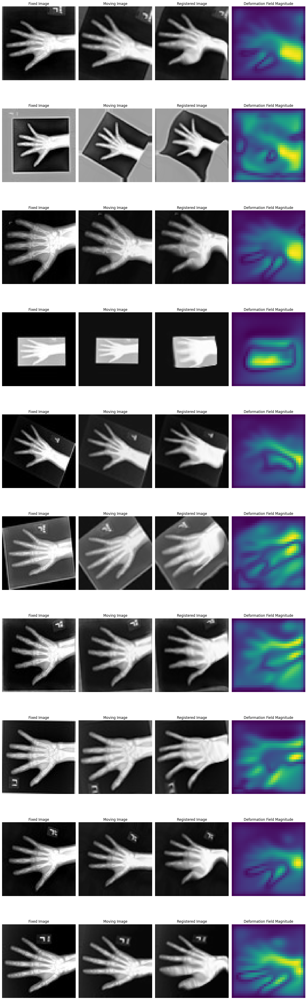

In [14]:
def generate_and_plot_samples(test_loader, model, device, k=10):
    """
    Generate fixed, moving, registered images, and deformation fields from the test loader
    and plot them using the plot_samples function.
    """
    # Switch model to evaluation mode
    model.eval()

    # Get one batch from the test loader
    with torch.no_grad():
        for batch in test_loader:
            # Extract fixed and moving images
            batch_fixed = batch['fixed_hand'].to(device)
            batch_moving = batch['moving_hand'].to(device)

            # Forward pass through the model to get deformation fields and registered images
            deformation_field = model(batch_moving, batch_fixed)
            registered_images = deformation_field[0]  # Apply deformation (example) batch_moving + deformation_field[0]

            # Plot samples
            plot_samples(batch_fixed, batch_moving, registered_images, deformation_field[1], k=k)
            break  # Only process the first batch for plotting

# Example usage
generate_and_plot_samples(test_loader, voxelmorph, device, k=10)


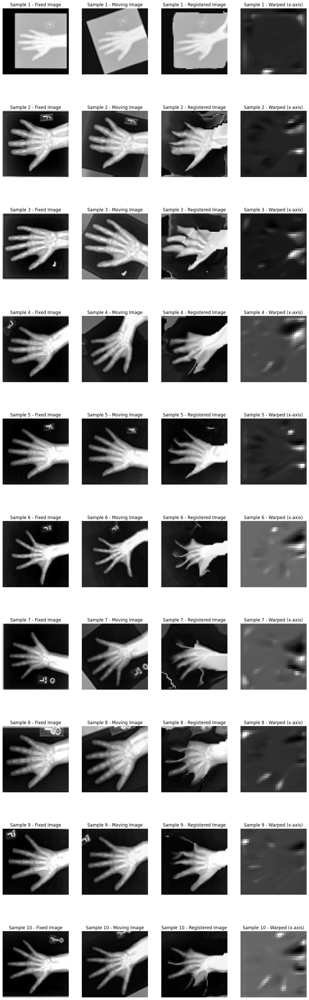

In [ ]:


    #################################################################################
